# Exp 7
### Description


In [1]:
import tensorflow as tf
from matplotlib import pyplot as plt

print('Tensorflow version ', tf.__version__)

tf.test.is_built_with_gpu_support()

# device_name = tf.test.gpu_device_name()
# if device_name != '/device:GPU:0':
#     raise SystemError('GPU device not found')
# print('Found GPU at: {}'.format(device_name))

#plt.gray()

Tensorflow version  2.3.1


False

In [2]:
IM_WIDTH = 128
IM_HEIGHT = 128
IM_CH = 1
BATCH_SIZE = 4
POV = 180

In [3]:
# from tensorflow.keras.applications.vgg16 import VGG16
# from tensorflow.keras.applications.vgg16 import preprocess_input as preprocess_input_vgg
import numpy as np
import math
from tensorflow.keras.layers import Add, Activation, Dense, Conv2D, MaxPooling2D, UpSampling2D, Embedding, Concatenate, Lambda, Conv2DTranspose, Reshape, Flatten, BatchNormalization, Dropout
from tensorflow.keras import Model, Input
from tensorflow_addons.layers import InstanceNormalization
#from layers import CoordinateChannel2D, AdaIN

l_relu = tf.nn.relu

def residual(layer_input, filters):
    shortcut = layer_input
    y = Conv2D(filters, (3,3), strides=1, padding='same')(layer_input)
    y = InstanceNormalization(axis=-1, center=False, scale=False)(y)
    y = Activation('relu')(y)
    y = Conv2D(filters, (3,3), strides=1, padding='same')(y)
    y = InstanceNormalization(axis=-1, center=False, scale=False)(y)
    
    return Add()([shortcut, y])

def resize_like_shape(inputs, ref):
    i_h, i_w = inputs.get_shape()[1], inputs.get_shape()[2]
    r_h, r_w = ref[0], ref[1]
    if i_h == r_h and i_w == r_w:
        return inputs
    else:
        # TODO(casser): Other interpolation methods could be explored here.
        return tf.image.resize(inputs, [r_h, r_w], method=tf.image.ResizeMethod.BILINEAR)

def resize_like(inputs, ref):
    i_h, i_w = inputs.get_shape()[1], inputs.get_shape()[2]
    r_h, r_w = ref.get_shape()[1], ref.get_shape()[2]
    if i_h == r_h and i_w == r_w:
        return inputs
    else:
        # TODO(casser): Other interpolation methods could be explored here.
        return tf.image.resize(inputs, [r_h, r_w], method=tf.image.ResizeMethod.BILINEAR)

def ups(layer_input, filters):
    shortcut = layer_input
    b, h, w, c = layer_input.shape
    y = Lambda(lambda x: tf.image.resize(x, [h*2, w*2], method=tf.image.ResizeMethod.BILINEAR))(layer_input)
    y = Conv2D(filters, (3,3), strides=1, activation=l_relu, padding='same')(y)
    
    return y
    
def feature_model(input_shape):
    input_img = Input(shape=input_shape, name='feature_model_input')
    
    conv_1 = Conv2D(32, (3, 3), strides=1, activation=l_relu, padding='same')(input_img)
    res_1 = residual(conv_1, 32)
    res_2 = residual(res_1, 32)
    res_3 = residual(res_2, 32)
    conv_2 = Conv2D(64, (3, 3), strides=1, activation=l_relu, padding='same')(res_3)
    res_4 = residual(conv_2, 64)
    res_5 = residual(res_4, 64)
    res_6 = residual(res_5, 64)
    res_7 = residual(res_6, 64)
    res_8 = residual(res_7, 64)
    #conv_2 = Conv2D(128, (3, 3), strides=1, activation=l_relu, padding='same')(res_3)

    return Model(input_img, res_8, name='Feature net')

def refinement_model(input_shape, output_shape):
    input_img = Input(shape=input_shape, name='refinement_model_input')
    
    #conv_1 = Conv2D(64, (3, 3), strides=1, activation=l_relu, padding='same')(input_img)
    res_1 = residual(input_img, 64)
    conv_1 = Conv2D(128, (3, 3), strides=1, activation=l_relu, padding='same')(res_1)
    res_2 = residual(conv_1, 128)
    conv_2 = Conv2D(256, (3, 3), strides=2, activation=l_relu, padding='same')(res_2)
    res_3 = residual(conv_2, 256)
    conv_2_2 = Conv2D(256, (3, 3), strides=2, activation=l_relu, padding='same')(res_3)
    res_4 = residual(conv_2_2, 256)
    conv_3 = Conv2D(128, (3, 3), strides=1, activation=l_relu, padding='same')(res_4)
    res_5 = residual(conv_3, 128)
    conv_3_2 = Conv2DTranspose(128, (3, 3), strides=2, activation=l_relu, padding='same')(res_5)
    res_6 = residual(conv_3_2, 128)
    conv_3_3 = Conv2DTranspose(128, (3, 3), strides=2, activation=l_relu, padding='same')(res_6)
    res_7 = residual(conv_3_3, 128)
    conv_4 = Conv2D(output_shape[-1], (3, 3), strides=1, activation=l_relu, padding='same')(res_7)
    res_8 = residual(conv_4, output_shape[-1])
    conv_5 = Conv2D(output_shape[-1], (3, 3), strides=1, activation='sigmoid', padding='same')(res_8)
    #conv_2 = Conv2D(output_shape[-1], (3, 3), strides=1, activation='sigmoid', padding='same')(conv_1)

    return Model(input_img, conv_5, name='Refinement net')

def encoder_model(input_shape):
    input_img = Input(shape=input_shape, name='encoder_input')
    conv_1 = Conv2D(32, (3, 3), strides=2, activation=l_relu, padding='same', name='conv_1')(input_img)
    conv_1_smooth = Conv2D(32, (3, 3), strides=1, activation=l_relu, padding='same', name='conv_1_smooth')(conv_1)
    conv_2 = Conv2D(64, (3, 3), strides=2, activation=l_relu, padding='same', name='conv_2')(conv_1_smooth)
    conv_2_smooth = Conv2D(64, (3, 3), strides=1, activation=l_relu, padding='same', name='conv_2_smooth')(conv_2)
    conv_3 = Conv2D(128, (3, 3), strides=2, activation=l_relu, padding='same', name='conv_3')(conv_2_smooth)
    conv_3_smooth = Conv2D(128, (3, 3), strides=1, activation=l_relu, padding='same', name='conv_3_smooth')(conv_3)
    conv_4 = Conv2D(256, (3, 3), strides=2, activation=l_relu, padding='same', name='conv_4')(conv_3_smooth)
    conv_4_smooth = Conv2D(256, (3, 3), strides=1, activation=l_relu, padding='same', name='conv_4_smooth')(conv_4)
    encoder_output = conv_4_smooth

    return Model(input_img, [encoder_output,conv_4_smooth,conv_3_smooth,conv_2_smooth,conv_1_smooth], name='Encoder')

def slice_model(input_shape, output_shape, enc_model):
    input_img = Input(shape=input_shape)

    _, bottleneck, conv_3, conv_2, conv_1  = enc_model(input_img)
    
    np_output_shape = (np.array(output_shape) // math.pow(2,4)).astype(np.int64)
    
    bottleneck = Lambda(lambda x: resize_like_shape(x[0],x[1]), name='resized_conv_3')([
        bottleneck, [np_output_shape[0], np_output_shape[1], 256]
    ])
    
#     bottleneck = Flatten()(bottleneck)
#     bottleneck = Dense(256*np_output_shape[0]*np_output_shape[1], activation=l_relu)(bottleneck)
#     print(bottleneck.shape)
#     bottleneck = Reshape([np_output_shape[0], np_output_shape[1], 256])(bottleneck)
#     print(bottleneck.shape)

    deconv_4 = Conv2DTranspose(256, (3, 3), strides=2, activation=l_relu, padding='same', name='deconv_4')(bottleneck)
    resized_conv_3 = Lambda(lambda x: resize_like(x[0],x[1]), name='resized_conv_3')([conv_3, deconv_4])
    concat_4 = Concatenate(axis=-1, name='concat_4')([deconv_4, resized_conv_3])
    conv_concat_4 = Conv2D(256, (3, 3), strides=1, activation=l_relu, padding='same', name='conv_concat_4')(concat_4)

    deconv_3 = Conv2DTranspose(128, (3, 3), strides=2, activation=l_relu, padding='same', name='deconv_3')(conv_concat_4)
    resized_conv_2 = Lambda(lambda x: resize_like(x[0],x[1]), name='resized_conv_2')([conv_2, deconv_3])
    concat_3 = Concatenate(axis=-1, name='concat_3')([deconv_3, resized_conv_2])
    conv_concat_3 = Conv2D(128, (3, 3), strides=1, activation=l_relu, padding='same', name='conv_concat_3')(concat_3)

    deconv_2 = Conv2DTranspose(64, (3, 3), strides=2, activation=l_relu, padding='same', name='deconv_2')(conv_concat_3)
    resized_conv_1 = Lambda(lambda x: resize_like(x[0],x[1]), name='resized_conv_1')([conv_1, deconv_2])
    concat_2 = Concatenate(axis=-1, name='concat_2')([deconv_2, resized_conv_1])
    conv_concat_2 = Conv2D(64, (3, 3), strides=1, activation=l_relu, padding='same', name='conv_concat_2')(concat_2)
    #slice_2 = Conv2D(1, 3, strides=1, activation='sigmoid', padding='same', name='slice_2')(conv_concat_2)

    deconv_1 = Conv2DTranspose(32, (3, 3), strides=2, activation=l_relu, padding='same', name='deconv_1')(conv_concat_2)
    #slice_resized_2 = Lambda(lambda x: resize_like(x[0],x[1]), name='slice_resized_2')([slice_2, deconv_1])
    #concat_1 = Concatenate(axis=-1, name='concat_1')([deconv_1, slice_resized_2])
    conv_concat_1 = Conv2D(32, (3, 3), strides=1, activation=l_relu, padding='same', name='conv_concat_1')(deconv_1)
    slice_1 = Conv2D(1, 3, strides=1, activation='sigmoid', padding='same', name='slice_1')(conv_concat_1)

    return Model(input_img, [slice_1,slice_1], name='slice_net')

def ego_model(encoder, name='ego_model'):
    encoders_shape = encoder.output[0].shape
    encoders_shape = encoders_shape[1:-1] + encoders_shape[-1]*2

    ego_input = tf.keras.Input(shape=encoders_shape)
    x = Conv2D(256, (3, 3), strides=2, activation='relu', padding='same', name='ego_1')(ego_input)
    x = Conv2D(256, (3, 3), strides=2, activation='relu', padding='same', name='ego_2')(x)
    x = Conv2D(6, (1, 1), padding='same')(x)
    x = Lambda(lambda x: tf.reduce_mean(x, [1,2]))(x)
    ego_output = Lambda(lambda x: tf.reshape(x, [-1, 1, 6]), name='ego_output')(x)
    ego_output_scaled = Lambda(lambda x: tf.concat([x[:, 0:3]*0.001,x[:, 3:6]*0.01], axis=1), name='ego_output_scaled')(ego_output)
    ego_net = tf.keras.Model(ego_input,ego_output_scaled, name=name)
    return ego_net

# def discriminator_realfake(img_shape, output_shape):
#     input_img = Input(shape=img_shape, name='discriminator_input')
#     x = Conv2D(8, (3, 3), strides=2, activation=l_relu, padding='same')(input_img)
#     x = Conv2D(16, (3, 3), strides=2, activation=l_relu, padding='same')(x)
#     x = Conv2D(32, (3, 3), strides=2, activation=l_relu, padding='same')(x)
#     #x = Conv2D(64, (3, 3), strides=2, activation=l_relu, padding='same')(x)
#     x = Flatten()(x)
#     x = Dense(64, activation=l_relu)(x)
#     x = Dense(output_shape, activation='sigmoid')(x)
#     return Model(input_img, x)

# def discriminator_angle(img_shape, output_shape):
#     input_img = Input(shape=img_shape, name='discriminator_input')
#     x = Conv2D(8, (3, 3), strides=2, activation=l_relu, padding='same')(input_img)
#     x = Conv2D(16, (3, 3), strides=2, activation=l_relu, padding='same')(x)
#     x = Conv2D(32, (3, 3), strides=2, activation=l_relu, padding='same')(x)
#     #x = Conv2D(64, (3, 3), strides=2, activation=l_relu, padding='same')(x)
#     x = Flatten()(x)
#     x = Dense(64, activation=l_relu)(x)
#     x = Dense(output_shape, activation='tanh')(x)
#     return Model(input_img, x)

#encoder_sino = encoder_model((POV, IM_WIDTH, IM_CH))
#feature_net = feature_model(img_shape)
#slice_net = slice_model((POV, IM_WIDTH, IM_CH), (IM_WIDTH, IM_HEIGHT, IM_CH), encoder_sino)
#graddecoder = depth_model(IM_HEIGHT, IM_WIDTH, encoder, name='grad_decoder')
#ego_net = ego_model(encoder_depth)

#refinement_input = (IM_WIDTH, IM_HEIGHT, feature_net.output.shape[-1])
#encoder_refinement = encoder_model(refinement_input)
#print(refinement_input)
#refinement_net = refinement_model(refinement_input, img_shape)

# model_input1 = tf.keras.Input(shape=img_shape, name='input_frame_1')
# model_input2 = tf.keras.Input(shape=img_shape, name='input_frame_2')
# model_input_intrinsics = tf.keras.Input(shape=(3,3,3), name='input_intrinsics')
# model_layer_intrinsics_inv = tf.keras.layers.Lambda(lambda x: tf.linalg.inv(x))(model_input_intrinsics)

# encd1 = encoder(model_input1)
# encd2 = encoder(model_input2)

# depth1 = decoder(model_input1)
# depth2 = decoder(model_input2)

# stereopair = tf.keras.layers.Concatenate()([encd1[0],encd2[0]])
# ego = ego_net(stereopair)

# my_model = tf.keras.Model(
#     [model_input1, 
#      model_input2, 
#      model_input_intrinsics
#     ],
#     [depth1,
#      depth2,
#      ego,
#      model_layer_intrinsics_inv
#     ], name='main_model')

# my_model.summary()


#--------

#disc_realfake = discriminator_realfake(img_shape,1)

input_shape, output_shape = (IM_HEIGHT, IM_WIDTH, IM_CH*POV), (IM_HEIGHT, IM_WIDTH, IM_CH)

input_img = Input(shape=input_shape, name='encoder_input')
conv_1 = Conv2D(64, (3, 3), strides=2, activation=l_relu, padding='same', name='conv_1')(input_img)
conv_1_smooth = Conv2D(64, (3, 3), strides=1, activation=l_relu, padding='same', name='conv_1_smooth')(conv_1)
conv_2 = Conv2D(32, (3, 3), strides=2, activation=l_relu, padding='same', name='conv_2')(conv_1_smooth)
conv_2_smooth = Conv2D(32, (3, 3), strides=1, activation=l_relu, padding='same', name='conv_2_smooth')(conv_2)
# conv_3 = Conv2D(128, (3, 3), strides=2, activation=l_relu, padding='same', name='conv_3')(conv_2_smooth)
# conv_3_smooth = Conv2D(128, (3, 3), strides=1, activation=l_relu, padding='same', name='conv_3_smooth')(conv_3)
# conv_4 = Conv2D(256, (3, 3), strides=2, activation=l_relu, padding='same', name='conv_4')(conv_3_smooth)
# conv_4_smooth = Conv2D(256, (3, 3), strides=1, activation=l_relu, padding='same', name='conv_4_smooth')(conv_4)
encoder_output = conv_2_smooth

np_output_shape = (np.array(output_shape) // math.pow(2,2)).astype(np.int64)
    
bottleneck = Lambda(lambda x: resize_like_shape(x[0],x[1]))([
    encoder_output, [np_output_shape[0], np_output_shape[1], 64]
])

print(bottleneck.shape)

# deconv_4 = Conv2DTranspose(256, (3, 3), strides=2, activation=l_relu, padding='same', name='deconv_4')(bottleneck)
# conv_concat_4 = Conv2D(256, (3, 3), strides=1, activation=l_relu, padding='same', name='conv_concat_4')(deconv_4)
# deconv_3 = Conv2DTranspose(128, (3, 3), strides=2, activation=l_relu, padding='same', name='deconv_3')(conv_concat_4)
# conv_concat_3 = Conv2D(128, (3, 3), strides=1, activation=l_relu, padding='same', name='conv_concat_3')(deconv_3)

# deconv_2 = Conv2DTranspose(16, (3, 3), strides=2, activation=l_relu, padding='same', name='deconv_2')(bottleneck)
# conv_concat_2 = Conv2D(16, (3, 3), strides=1, activation=l_relu, padding='same', name='conv_concat_2')(deconv_2)
# deconv_1 = Conv2DTranspose(8, (3, 3), strides=2, activation=l_relu, padding='same', name='deconv_1')(conv_concat_2)
# conv_concat_1 = Conv2D(8, (3, 3), strides=1, activation=l_relu, padding='same', name='conv_concat_1')(deconv_1)
# slice_1 = Conv2D(1, 3, strides=1, activation='sigmoid', padding='same', name='slice_1')(conv_concat_1)
deconv_2 = ups(bottleneck, 16)
deconv_1 = ups(deconv_2, 8)
conv_concat_1 = Conv2D(8, (3, 3), strides=1, activation=l_relu, padding='same')(deconv_1)
slice_1 = Conv2D(1, 3, strides=1, activation='sigmoid', padding='same', name='slice_1')(conv_concat_1)

slice_net = Model(input_img, slice_1, name='slice_net')


models = {
    #'encoder_sino': encoder_sino,
    'slice_net': slice_net
    #'disc_realfake': disc_realfake
}

(None, 32, 32, 32)


In [4]:
slice_net.summary()

Model: "slice_net"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
encoder_input (InputLayer)   [(None, 128, 128, 180)]   0         
_________________________________________________________________
conv_1 (Conv2D)              (None, 64, 64, 64)        103744    
_________________________________________________________________
conv_1_smooth (Conv2D)       (None, 64, 64, 64)        36928     
_________________________________________________________________
conv_2 (Conv2D)              (None, 32, 32, 32)        18464     
_________________________________________________________________
conv_2_smooth (Conv2D)       (None, 32, 32, 32)        9248      
_________________________________________________________________
lambda_1 (Lambda)            (None, 64, 64, 32)        0         
_________________________________________________________________
conv2d (Conv2D)              (None, 64, 64, 16)        46

In [5]:
from generator import Generator

traintest_dataset = Generator(
    IM_WIDTH, 
    IM_HEIGHT,
    IM_CH,
    BATCH_SIZE, POV)

Reconstructing 8 slice groups with 8 master threads...
(128, 128, 128, 1) (180, 128, 128, 1) (128, 128, 128, 1)


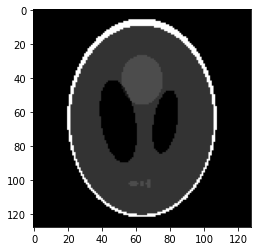

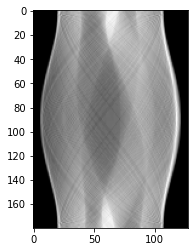

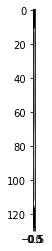

/Users/grigori/opt/miniconda3/envs/coreplug/lib/python3.6/site-packages/tensorflow_addons/image/transform_ops.py:143: UserWarning: fill_value is not supported and is always 0 for TensorFlow < 2.4.0.
  "fill_value is not supported and is always 0 for TensorFlow < 2.4.0."


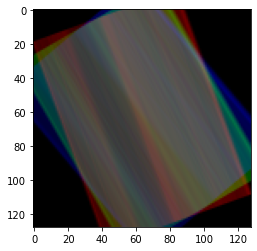

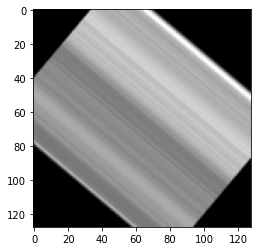

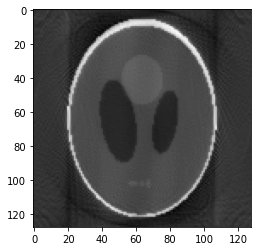

tf.Tensor(1.0, shape=(), dtype=float32) tf.Tensor(0.4763734, shape=(), dtype=float32) tf.Tensor(0.99480927, shape=(), dtype=float32)


In [6]:
from radon import sino2multi

N = 10
M = 50

if IM_CH == 1:
    plt.gray()

plt.imshow(traintest_dataset[N]['gt'].numpy()[0,:,:])
plt.show()

plt.imshow(traintest_dataset[N]['sino'].numpy()[0,:,:])
plt.show()

plt.imshow(traintest_dataset[N]['sino'].numpy()[0,M,:,:])
plt.show()

plt.imshow(sino2multi(traintest_dataset[N]['sino'], (BATCH_SIZE, IM_HEIGHT, IM_WIDTH, IM_CH)).numpy()[0,:,:,M-30:M:10])
plt.show()

plt.imshow(sino2multi(traintest_dataset[N]['sino'], (BATCH_SIZE, IM_HEIGHT, IM_WIDTH, IM_CH)).numpy()[0,:,:,M])
plt.show()

plt.imshow(traintest_dataset[N]['rec'].numpy()[0,:,:])
plt.show()

print(
    tf.reduce_max(traintest_dataset[N]['gt']), 
    tf.reduce_max(traintest_dataset[N]['sino']), 
    tf.reduce_max(traintest_dataset[N]['rec']))

In [7]:
from train import Train

acad = Train(models)

Epoch  1 ; Loss:  0.66398716


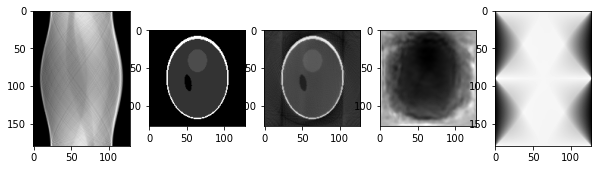

Epoch  2 ; Loss:  0.65528136


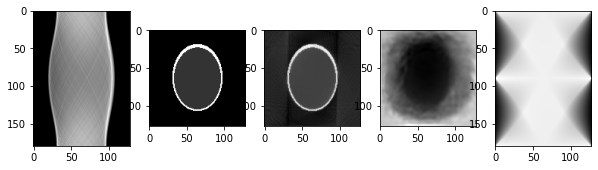

Epoch  3 ; Loss:  0.63565385


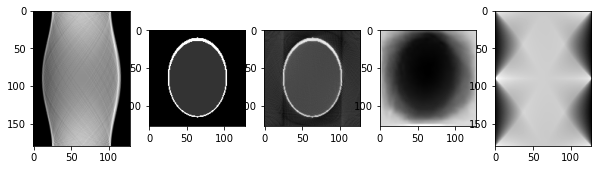

Epoch  4 ; Loss:  0.5840856


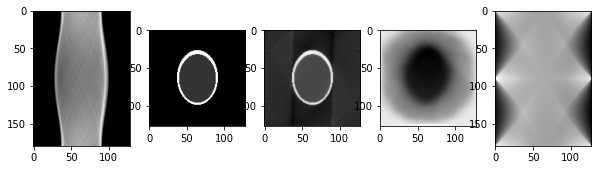

Epoch  5 ; Loss:  0.47172326


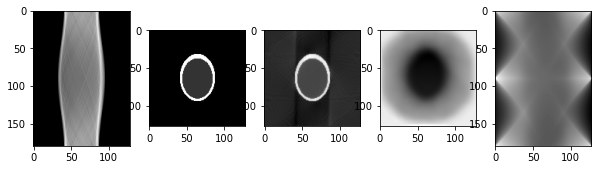

Epoch  6 ; Loss:  0.35310397


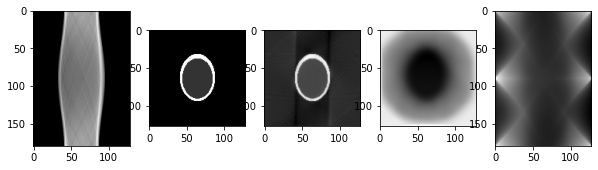

Epoch  7 ; Loss:  0.33417317


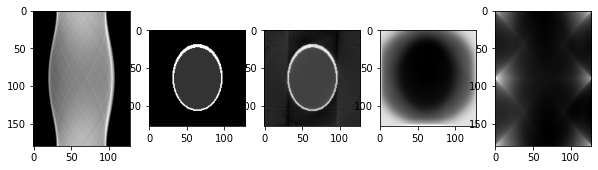

Epoch  8 ; Loss:  0.3317603


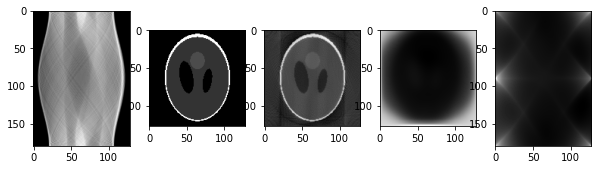

Epoch  9 ; Loss:  0.3304121


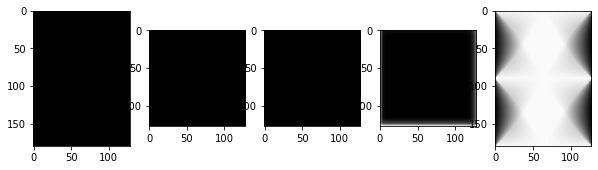

Epoch  10 ; Loss:  0.32905006


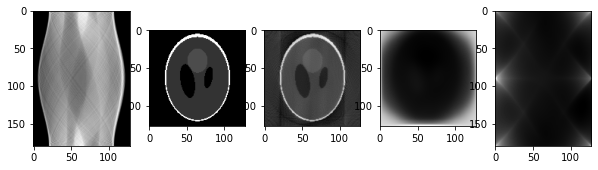

Epoch  11 ; Loss:  0.32717788


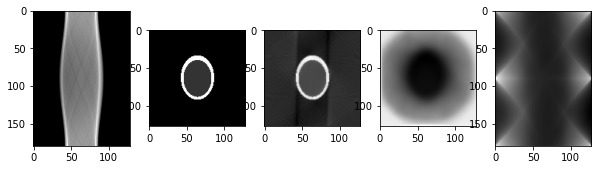

Epoch  12 ; Loss:  0.3252557


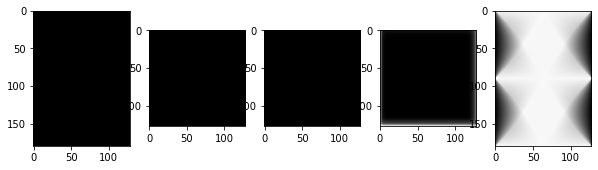

Epoch  13 ; Loss:  0.32271686


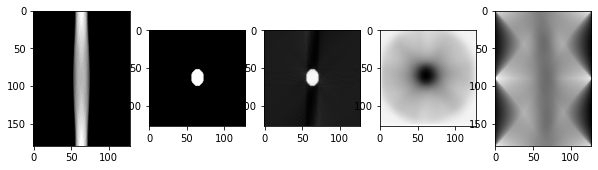

Epoch  14 ; Loss:  0.31954765


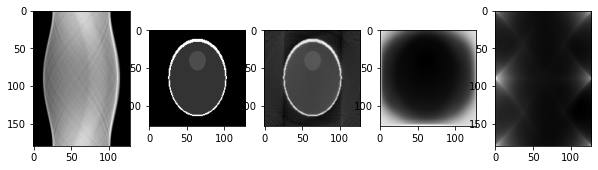

Epoch  15 ; Loss:  0.31596208


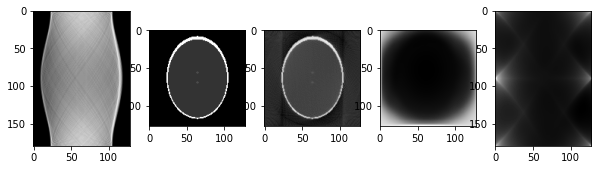

Epoch  16 ; Loss:  0.31163886


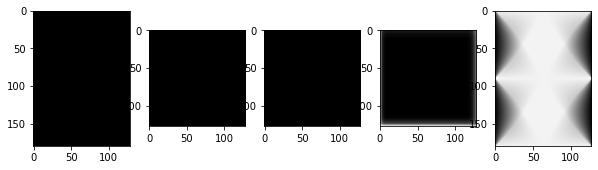

Epoch  17 ; Loss:  0.30600983


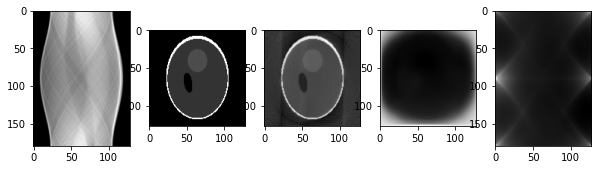

Epoch  18 ; Loss:  0.29817554


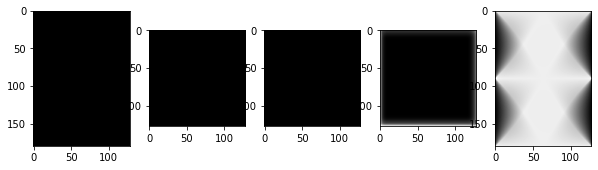

Epoch  19 ; Loss:  0.28754705


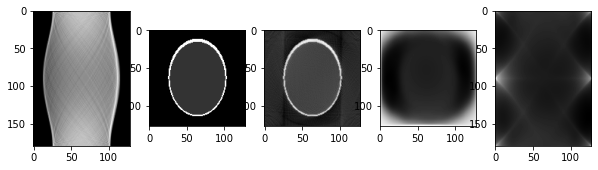

Epoch  20 ; Loss:  0.2753017


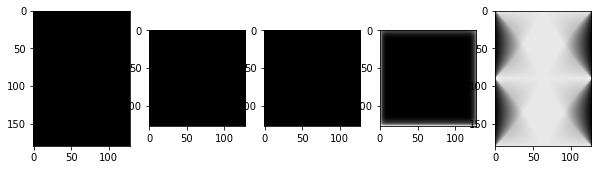

Epoch  21 ; Loss:  0.2615968


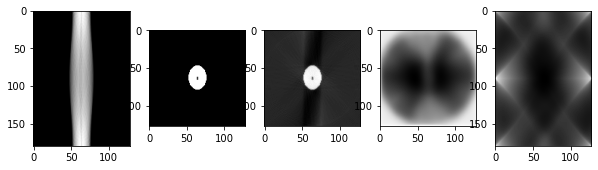

Epoch  22 ; Loss:  0.24711382


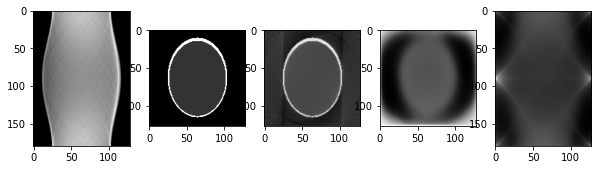

Epoch  23 ; Loss:  0.23266043


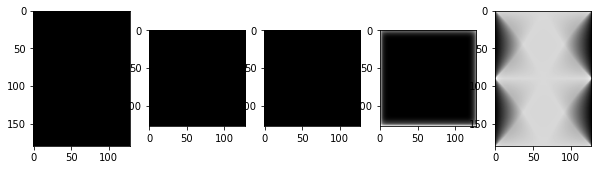

Epoch  24 ; Loss:  0.21909013


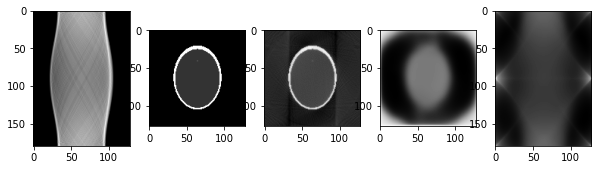

Epoch  25 ; Loss:  0.2075472


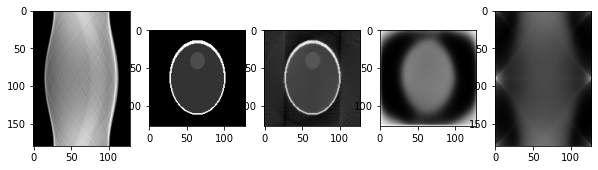

Epoch  26 ; Loss:  0.19737265


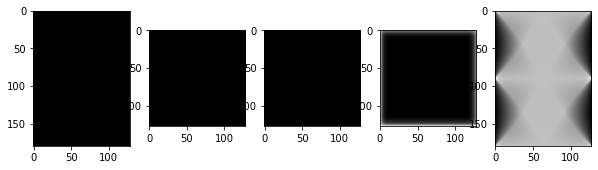

Epoch  27 ; Loss:  0.18808794


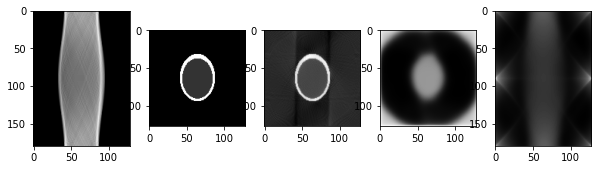

Epoch  28 ; Loss:  0.17897527


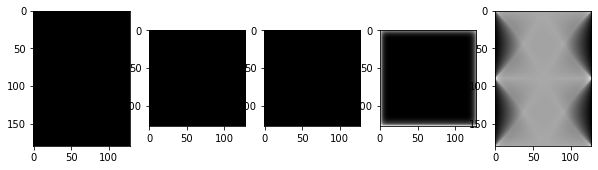

Epoch  29 ; Loss:  0.16937576


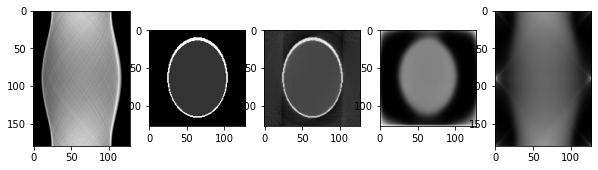

Epoch  30 ; Loss:  0.15925363


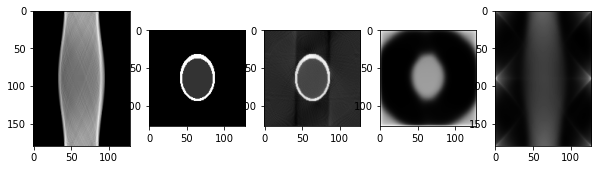

Epoch  31 ; Loss:  0.14814892


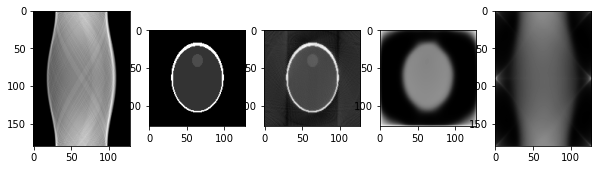

Epoch  32 ; Loss:  0.13607429


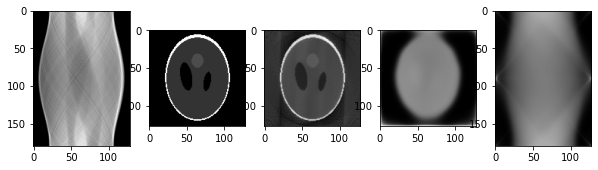

Epoch  33 ; Loss:  0.12307677


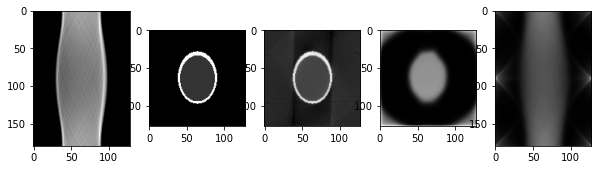

Epoch  34 ; Loss:  0.10877366


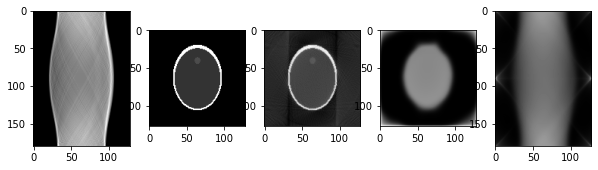

Epoch  35 ; Loss:  0.095171615


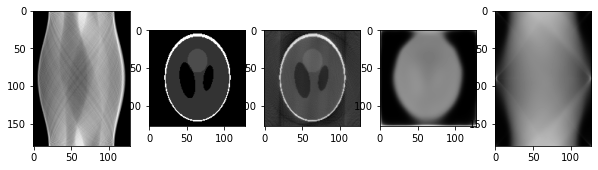

Epoch  36 ; Loss:  0.0822602


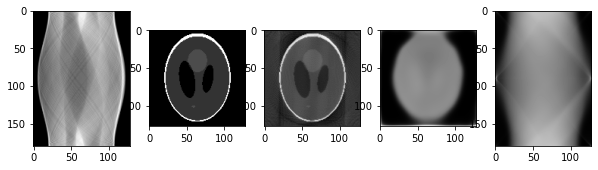

Epoch  37 ; Loss:  0.071228474


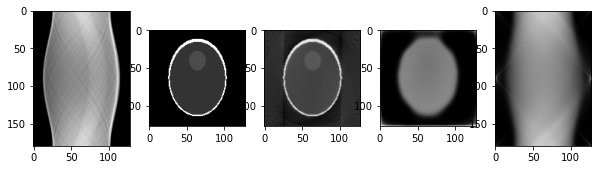

Epoch  38 ; Loss:  0.06276395


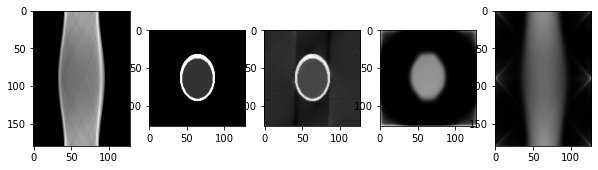

Epoch  39 ; Loss:  0.056248628


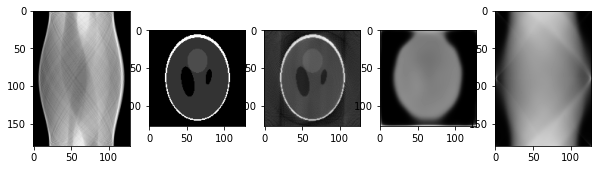

Epoch  40 ; Loss:  0.051232707


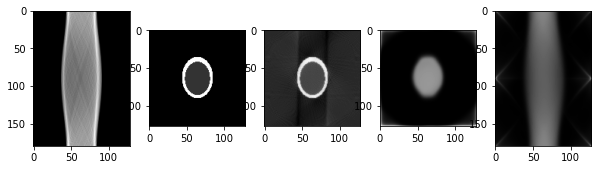

Epoch  41 ; Loss:  0.04754262


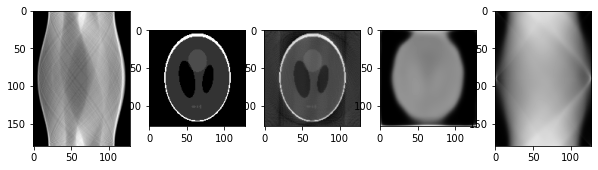

Epoch  42 ; Loss:  0.044921257


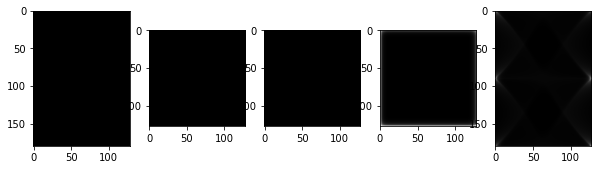

Epoch  43 ; Loss:  0.042931523


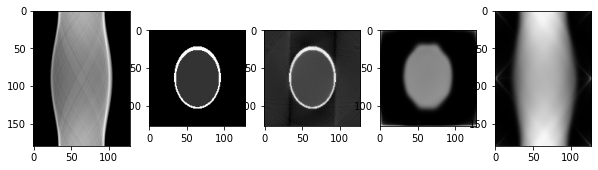

Epoch  44 ; Loss:  0.041383084


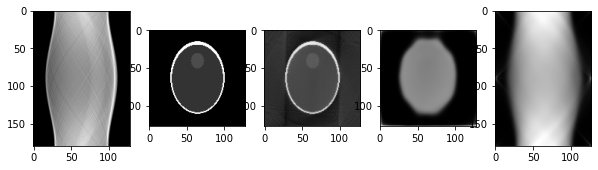

Epoch  45 ; Loss:  0.03988533


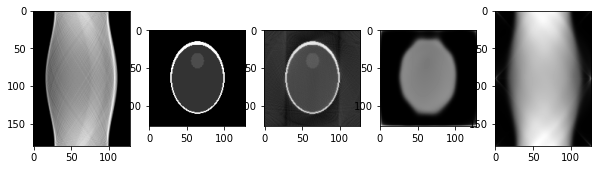

Epoch  46 ; Loss:  0.038814895


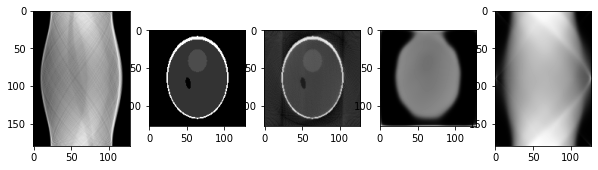

Epoch  47 ; Loss:  0.037891023


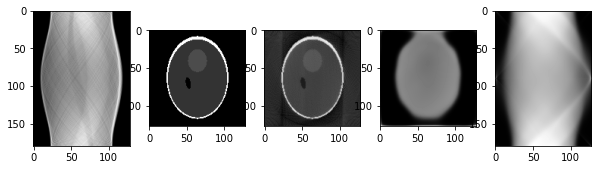

Epoch  48 ; Loss:  0.03732138


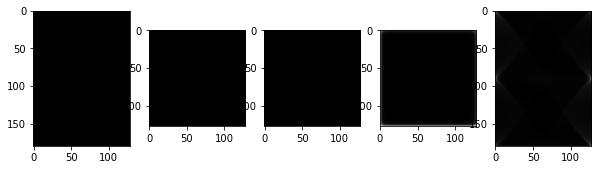

Epoch  49 ; Loss:  0.0366219


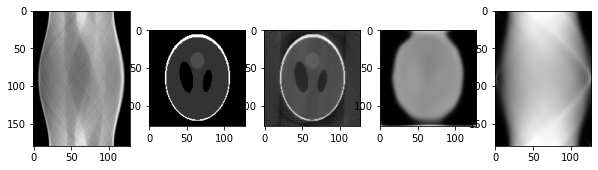

Epoch  50 ; Loss:  0.036117714


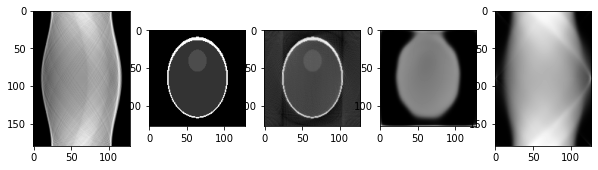

Epoch  51 ; Loss:  0.03557124


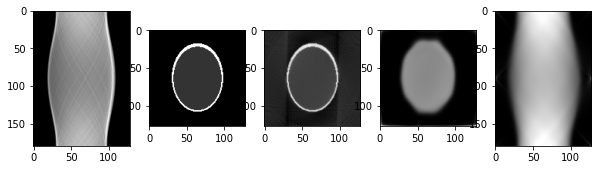

Epoch  52 ; Loss:  0.03535441


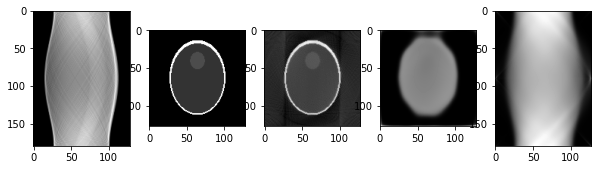

Epoch  53 ; Loss:  0.03484055


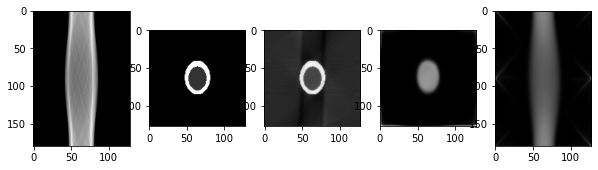

Epoch  54 ; Loss:  0.034547415


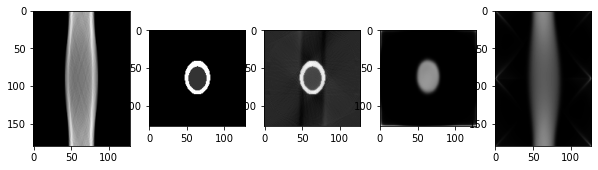

Epoch  55 ; Loss:  0.03425936


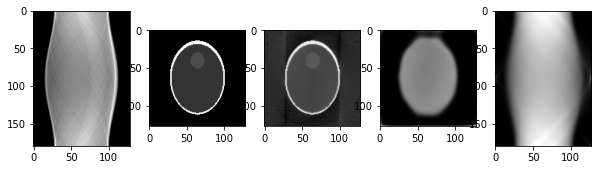

Epoch  56 ; Loss:  0.034031283


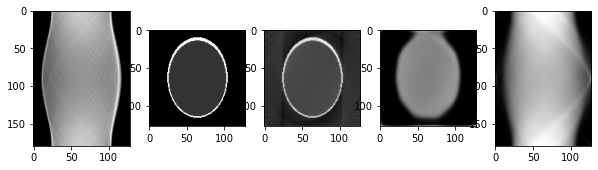

Epoch  57 ; Loss:  0.033861488


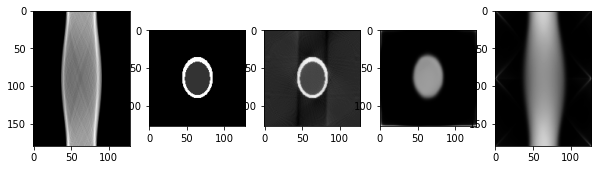

Epoch  58 ; Loss:  0.03347411


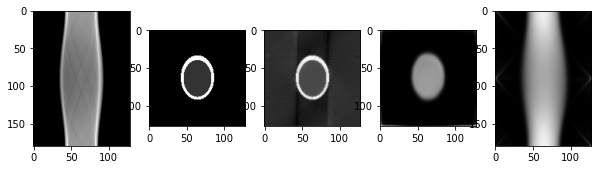

Epoch  59 ; Loss:  0.033333044


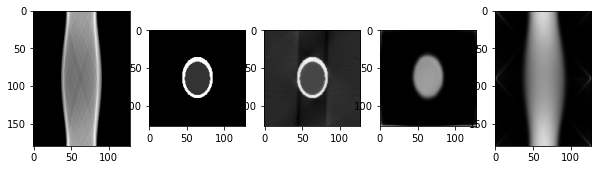

Epoch  60 ; Loss:  0.033158097


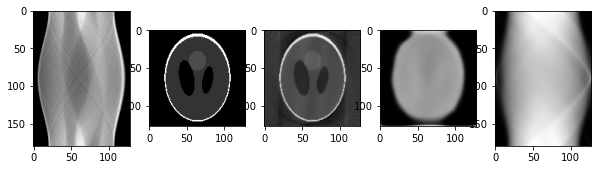

Epoch  61 ; Loss:  0.03301612


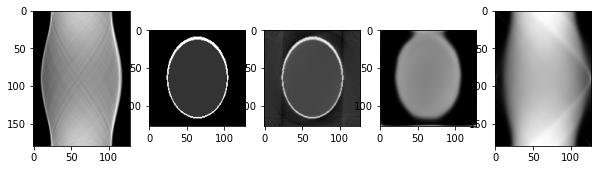

Epoch  62 ; Loss:  0.03297328


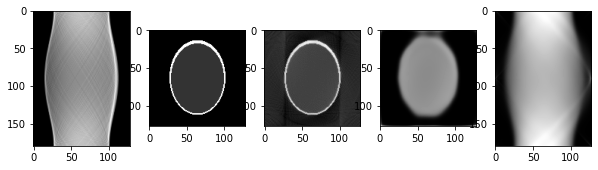

Epoch  63 ; Loss:  0.03259509


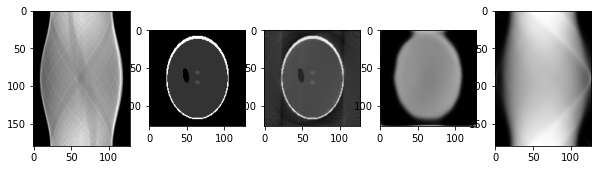

Epoch  64 ; Loss:  0.032472115


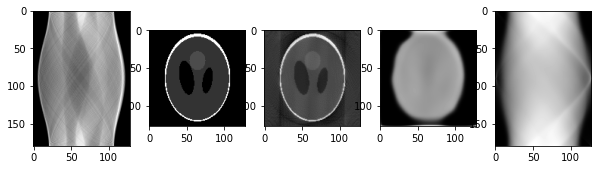

Epoch  65 ; Loss:  0.032265242


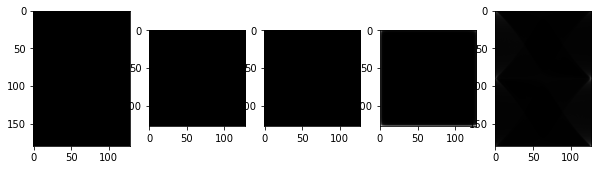

Epoch  66 ; Loss:  0.032844424


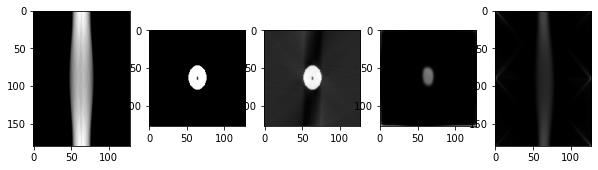

Epoch  67 ; Loss:  0.0327264


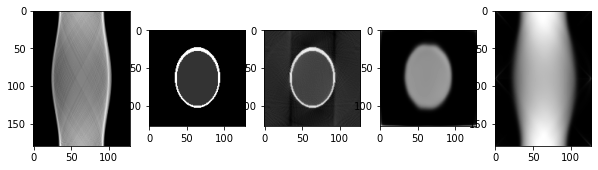

Epoch  68 ; Loss:  0.032263536


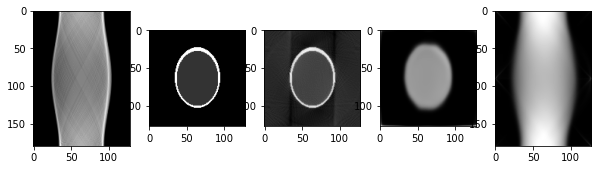

Epoch  69 ; Loss:  0.03201118


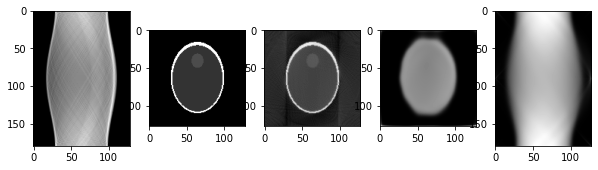

Epoch  70 ; Loss:  0.032196164


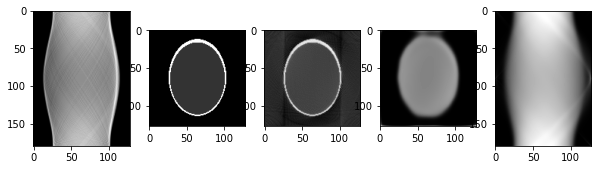

Epoch  71 ; Loss:  0.031913433


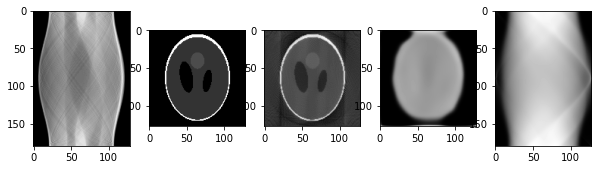

Epoch  72 ; Loss:  0.03160015


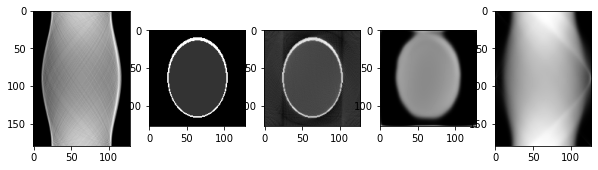

Epoch  73 ; Loss:  0.031541448


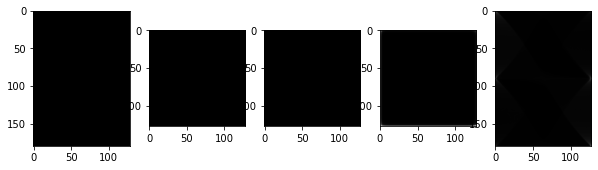

Epoch  74 ; Loss:  0.031300366


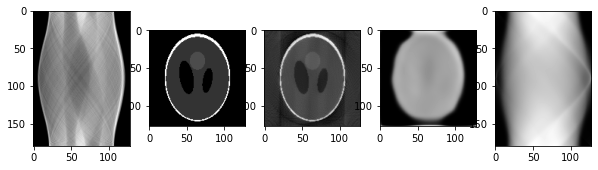

Epoch  75 ; Loss:  0.03126674


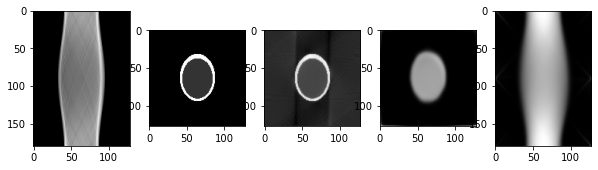

Epoch  76 ; Loss:  0.03115073


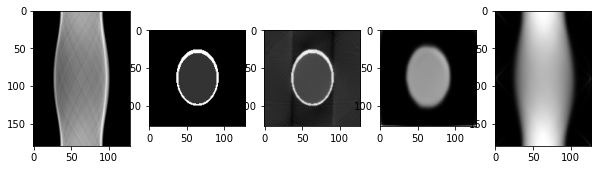

Epoch  77 ; Loss:  0.031096475


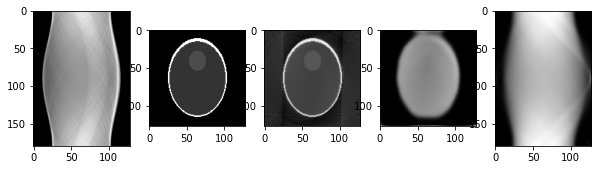

Epoch  78 ; Loss:  0.031215338


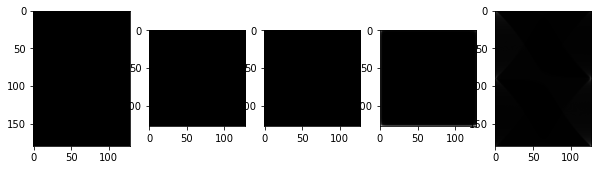

Epoch  79 ; Loss:  0.03142685


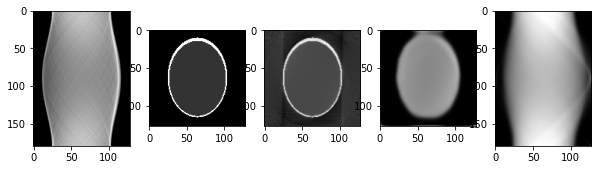

Epoch  80 ; Loss:  0.030881522


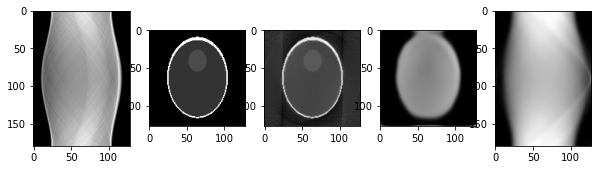

Epoch  81 ; Loss:  0.03067768


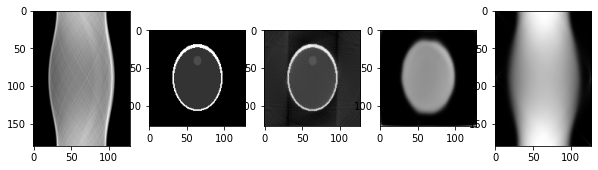

Epoch  82 ; Loss:  0.030868925


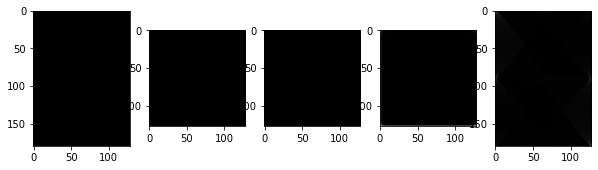

Epoch  83 ; Loss:  0.030648163


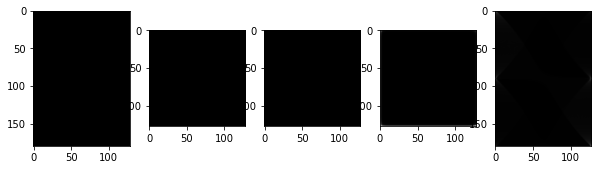

Epoch  84 ; Loss:  0.030498452


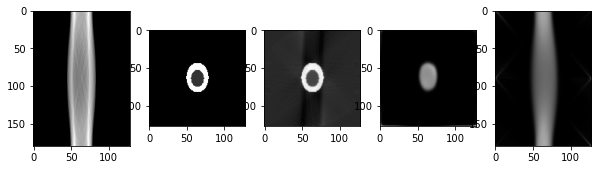

Epoch  85 ; Loss:  0.030439628


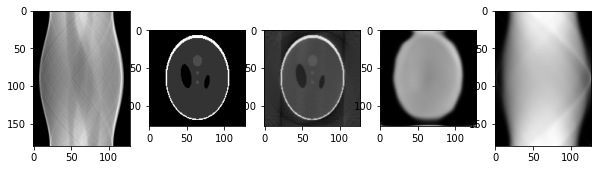

Epoch  86 ; Loss:  0.03032126


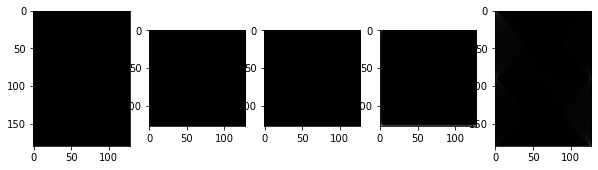

Epoch  87 ; Loss:  0.030344794


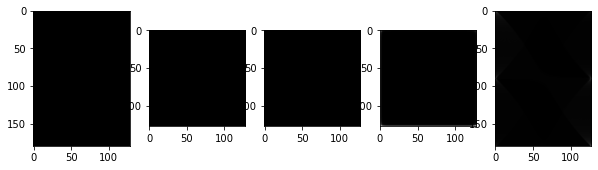

Epoch  88 ; Loss:  0.030196398


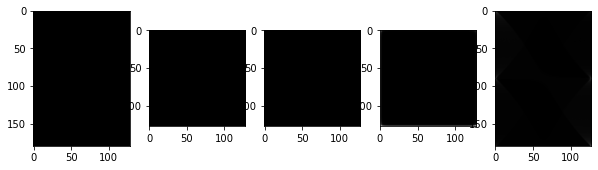

Epoch  89 ; Loss:  0.030140422


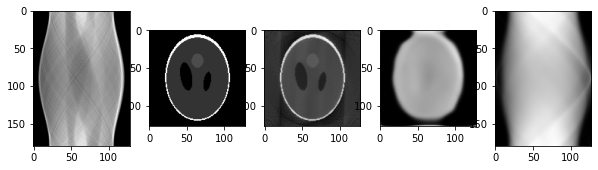

Epoch  90 ; Loss:  0.030067854


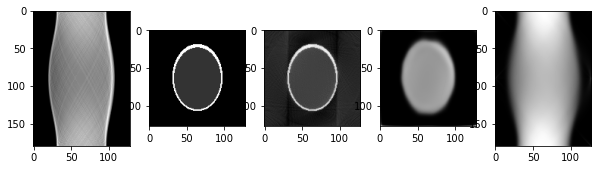

Epoch  91 ; Loss:  0.029947696


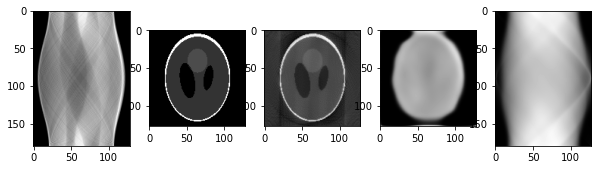

Epoch  92 ; Loss:  0.029935006


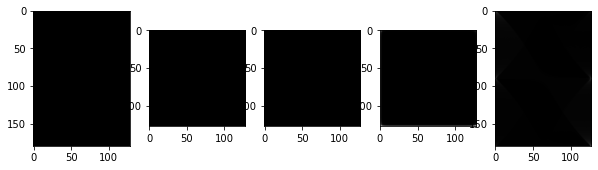

Epoch  93 ; Loss:  0.029860226


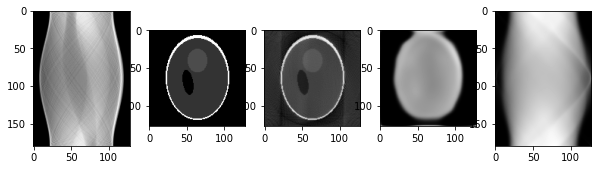

Epoch  94 ; Loss:  0.029749293


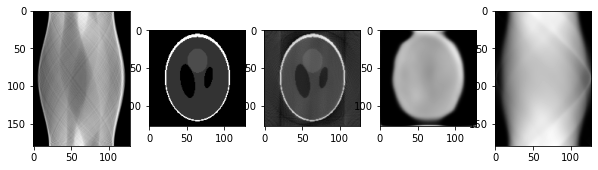

Epoch  95 ; Loss:  0.029995501


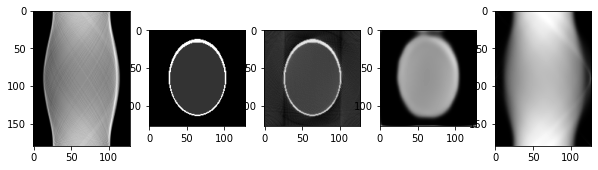

Epoch  96 ; Loss:  0.029834103


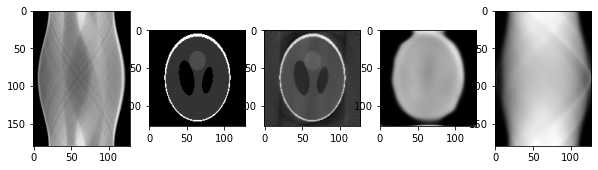

Epoch  97 ; Loss:  0.029535431


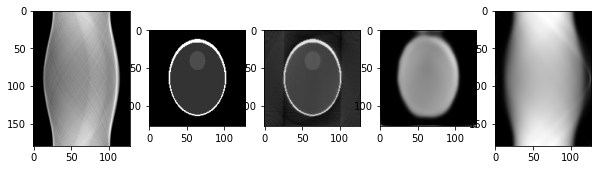

Epoch  98 ; Loss:  0.029731143


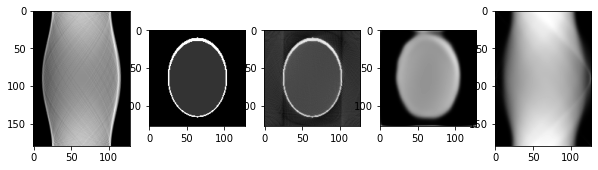

Epoch  99 ; Loss:  0.029339075


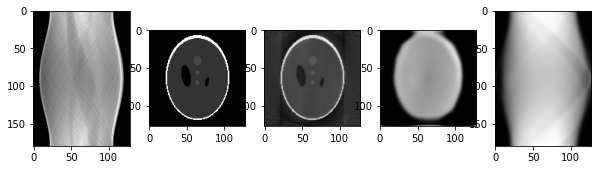

Epoch  100 ; Loss:  0.029488178


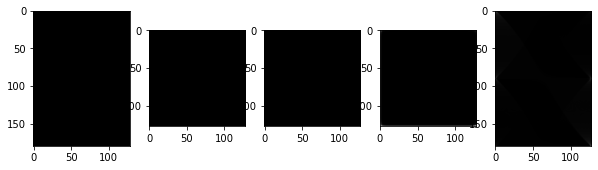

Epoch  101 ; Loss:  0.029410686


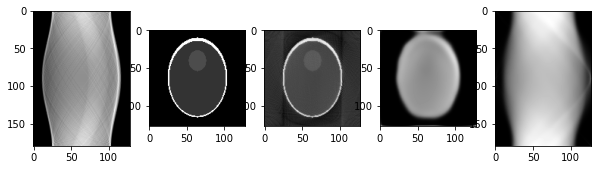

Epoch  102 ; Loss:  0.02933949


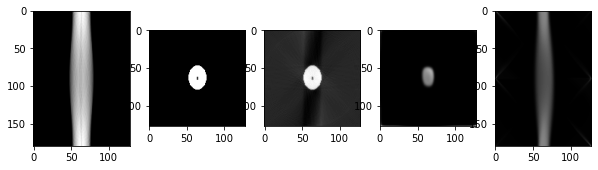

Epoch  103 ; Loss:  0.029459937


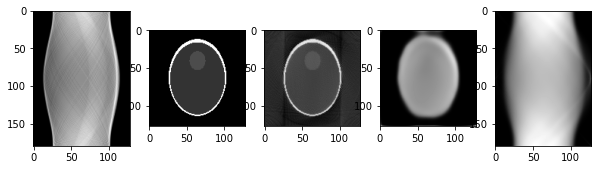

Epoch  104 ; Loss:  0.029583322


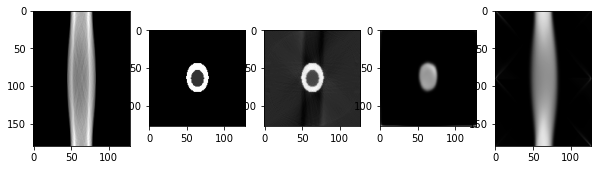

Epoch  105 ; Loss:  0.028928623


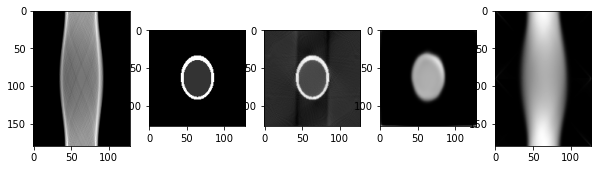

Epoch  106 ; Loss:  0.029018432


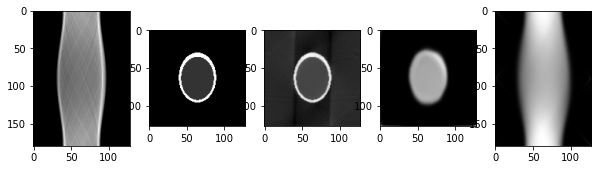

Epoch  107 ; Loss:  0.028811824


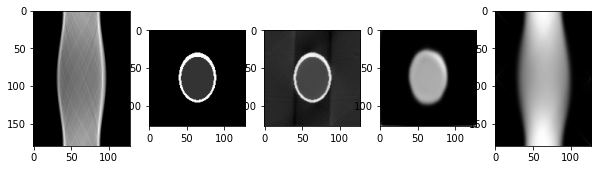

Epoch  108 ; Loss:  0.02879577


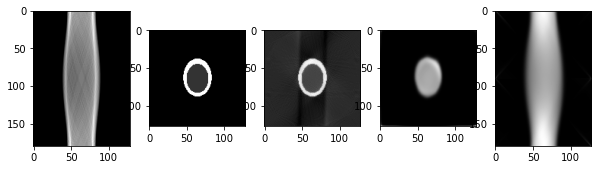

Epoch  109 ; Loss:  0.02864683


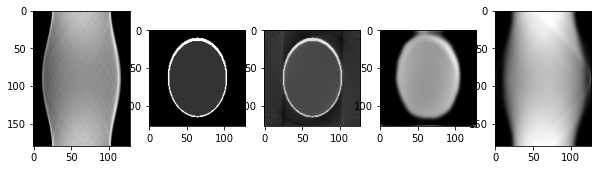

Epoch  110 ; Loss:  0.028702624


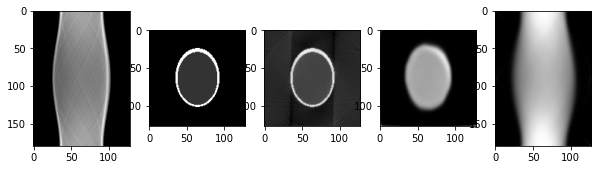

Epoch  111 ; Loss:  0.028962456


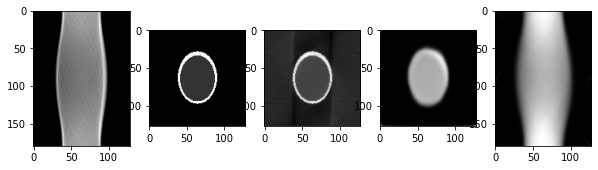

Epoch  112 ; Loss:  0.02842322


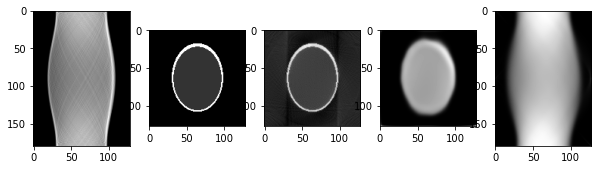

Epoch  113 ; Loss:  0.028399449


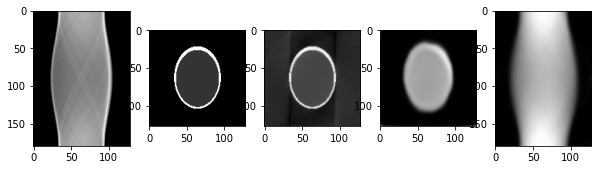

Epoch  114 ; Loss:  0.02830933


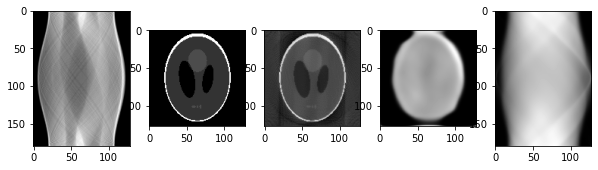

Epoch  115 ; Loss:  0.028227368


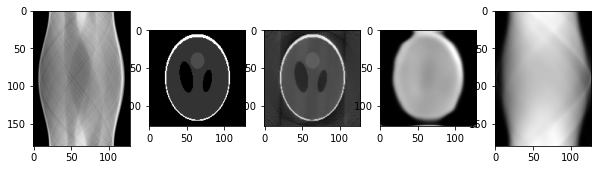

Epoch  116 ; Loss:  0.028075648


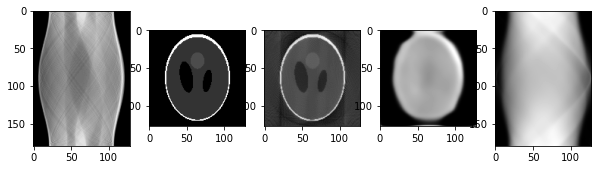

Epoch  117 ; Loss:  0.028367486


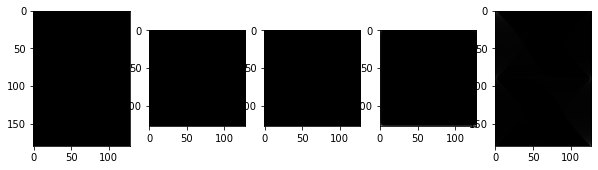

Epoch  118 ; Loss:  0.027927812


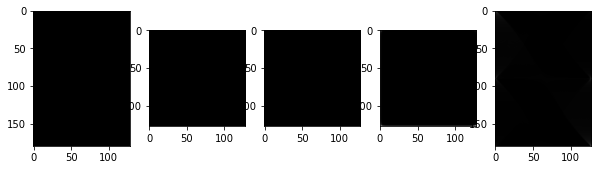

Epoch  119 ; Loss:  0.027944945


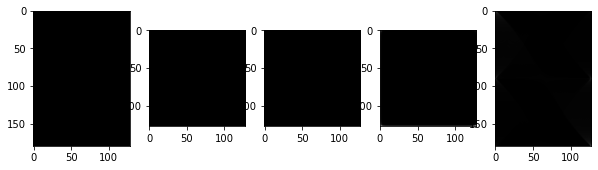

Epoch  120 ; Loss:  0.028070122


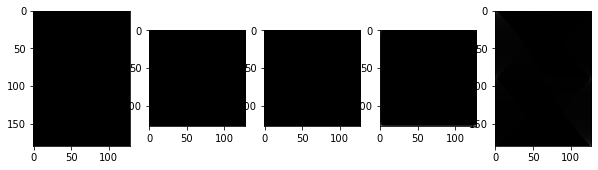

Epoch  121 ; Loss:  0.02785833


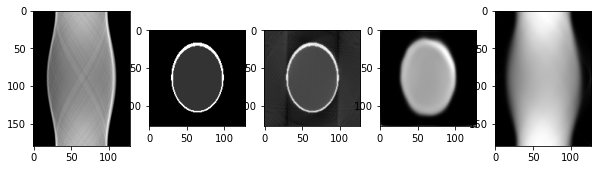

Epoch  122 ; Loss:  0.027647963


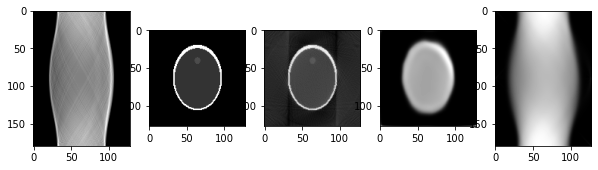

Epoch  123 ; Loss:  0.027558746


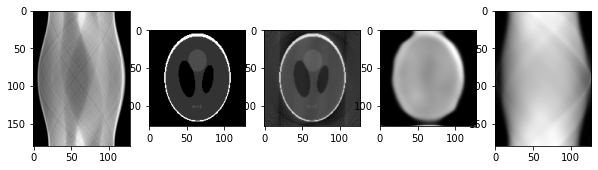

Epoch  124 ; Loss:  0.02767878


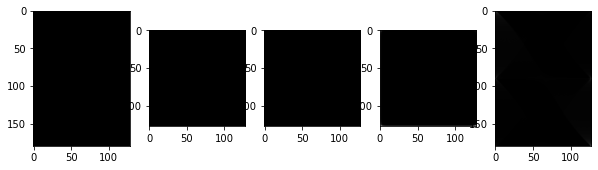

Epoch  125 ; Loss:  0.027467629


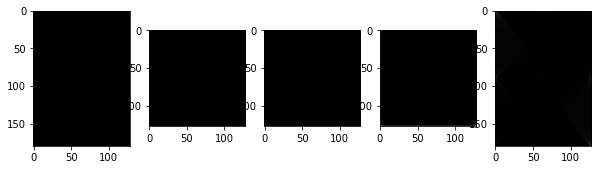

Epoch  126 ; Loss:  0.027438352


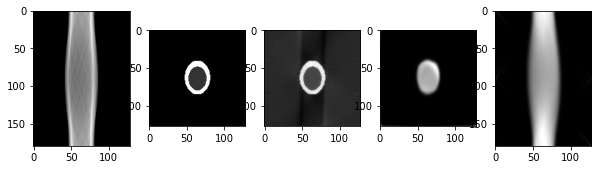

Epoch  127 ; Loss:  0.027390722


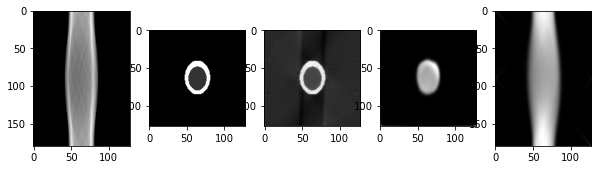

Epoch  128 ; Loss:  0.027400985


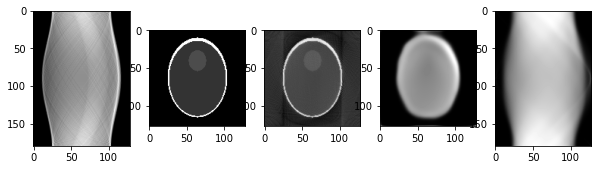

Epoch  129 ; Loss:  0.027065352


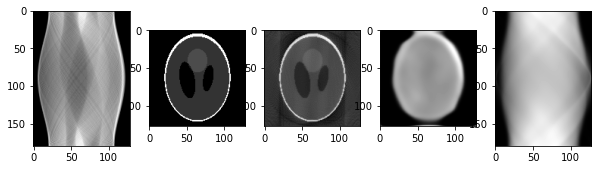

Epoch  130 ; Loss:  0.02705873


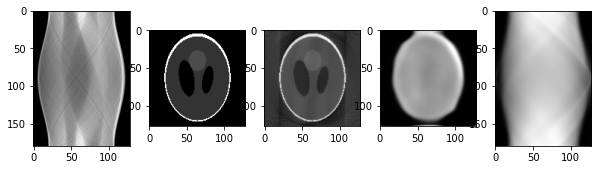

Epoch  131 ; Loss:  0.026941348


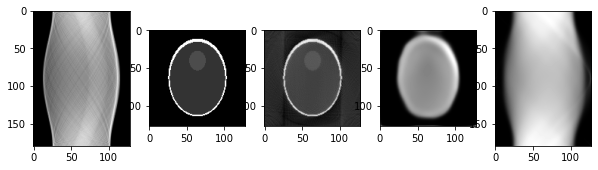

Epoch  132 ; Loss:  0.026920356


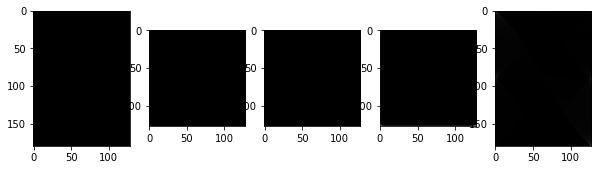

Epoch  133 ; Loss:  0.026752433


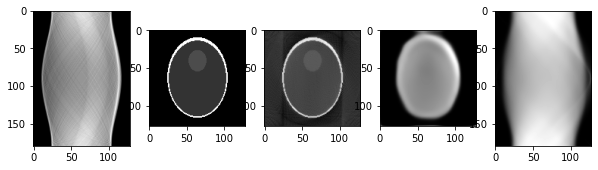

Epoch  134 ; Loss:  0.02670609


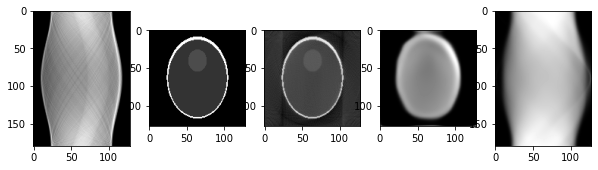

Epoch  135 ; Loss:  0.026584469


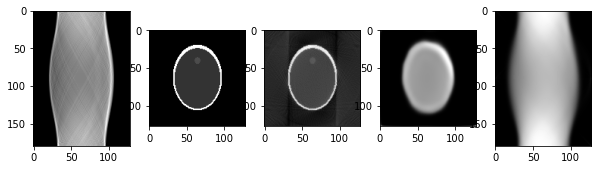

Epoch  136 ; Loss:  0.026523884


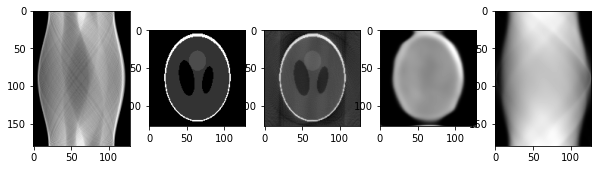

Epoch  137 ; Loss:  0.026278345


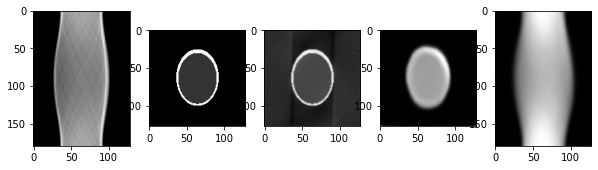

Epoch  138 ; Loss:  0.026201656


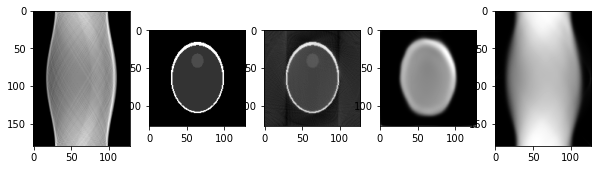

Epoch  139 ; Loss:  0.026293494


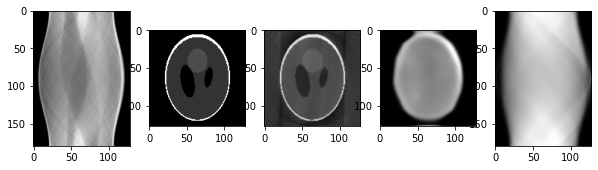

Epoch  140 ; Loss:  0.026288623


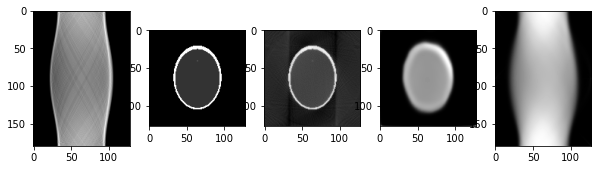

Epoch  141 ; Loss:  0.025961053


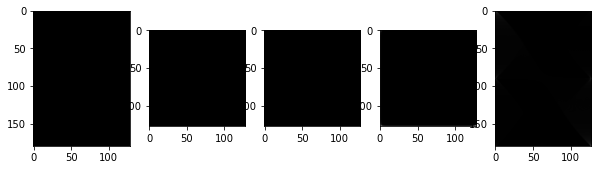

Epoch  142 ; Loss:  0.025730265


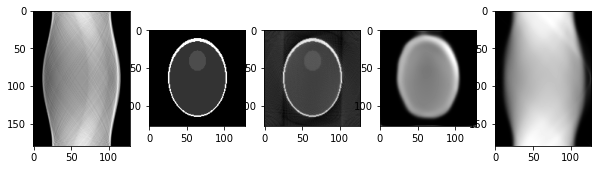

Epoch  143 ; Loss:  0.025713697


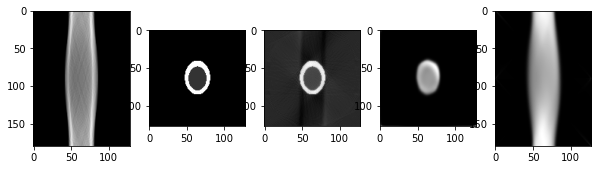

Epoch  144 ; Loss:  0.02616502


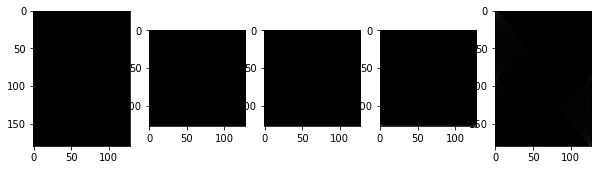

Epoch  145 ; Loss:  0.025905222


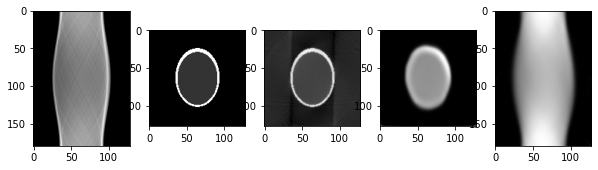

Epoch  146 ; Loss:  0.025405057


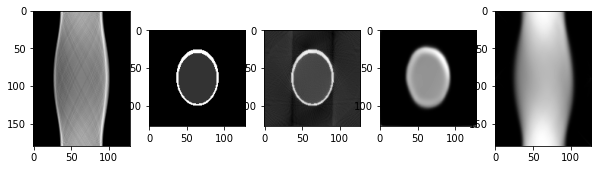

Epoch  147 ; Loss:  0.025240367


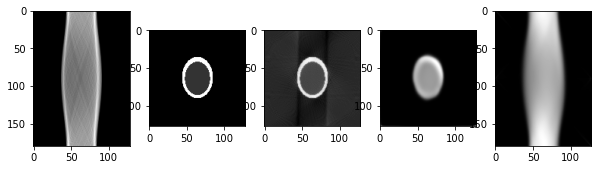

Epoch  148 ; Loss:  0.02503233


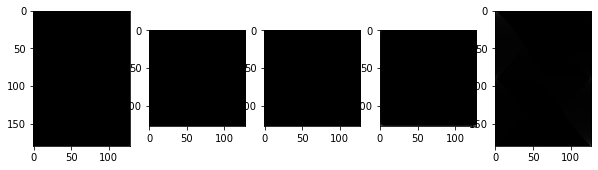

Epoch  149 ; Loss:  0.024794914


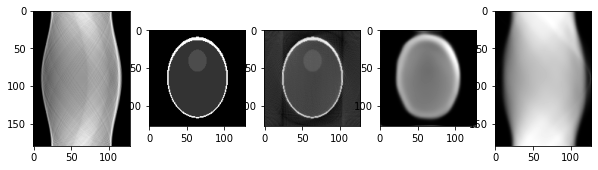

Epoch  150 ; Loss:  0.024867281


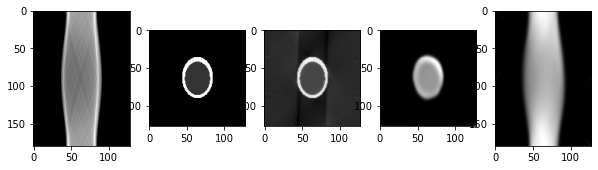

Epoch  151 ; Loss:  0.024767624


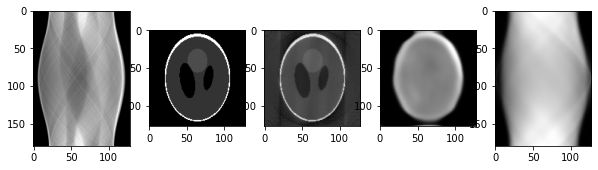

Epoch  152 ; Loss:  0.024544418


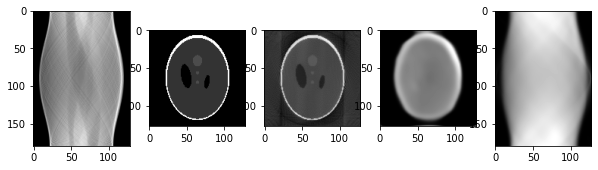

Epoch  153 ; Loss:  0.024296619


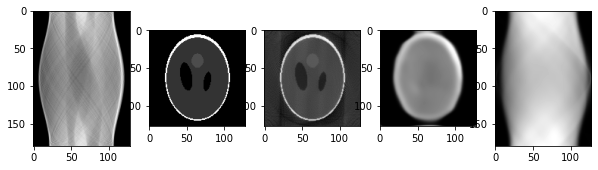

Epoch  154 ; Loss:  0.024422865


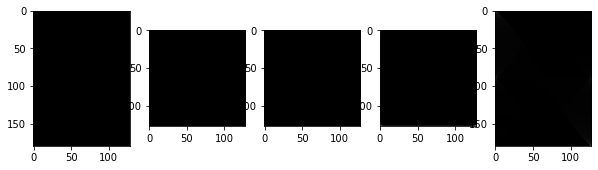

Epoch  155 ; Loss:  0.024116796


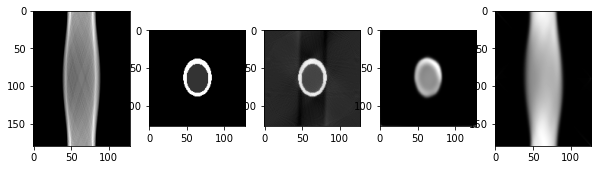

Epoch  156 ; Loss:  0.024103556


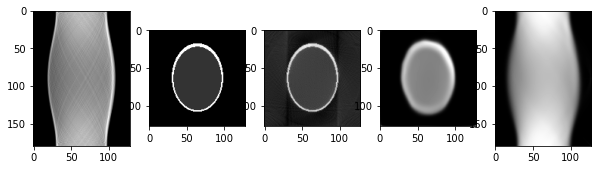

Epoch  157 ; Loss:  0.023728348


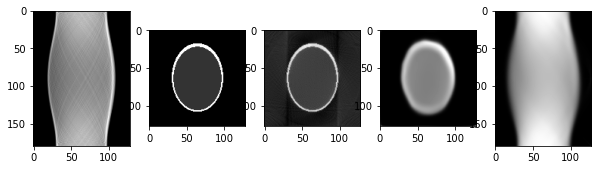

Epoch  158 ; Loss:  0.023601465


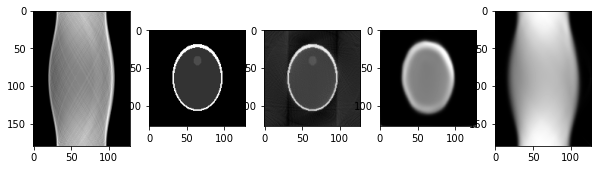

Epoch  159 ; Loss:  0.02342973


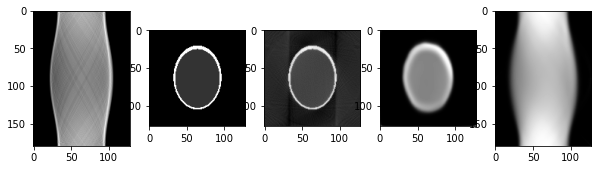

Epoch  160 ; Loss:  0.023420317


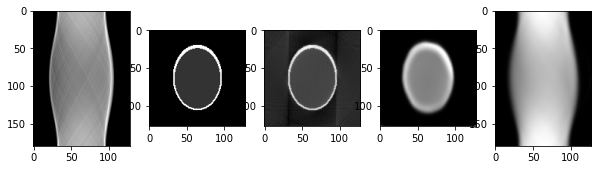

Epoch  161 ; Loss:  0.023176407


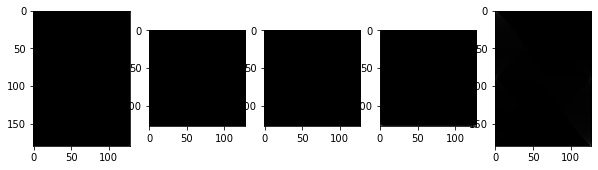

Epoch  162 ; Loss:  0.023116384


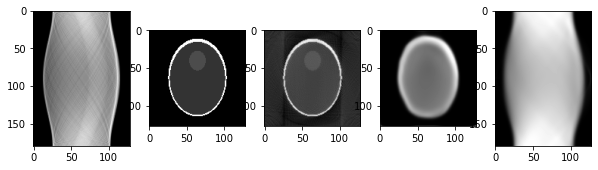

Epoch  163 ; Loss:  0.022922557


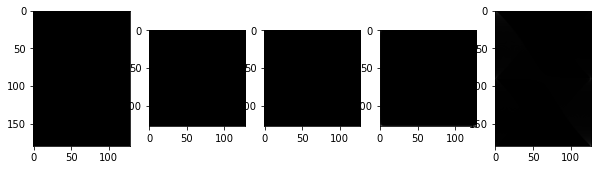

Epoch  164 ; Loss:  0.022750271


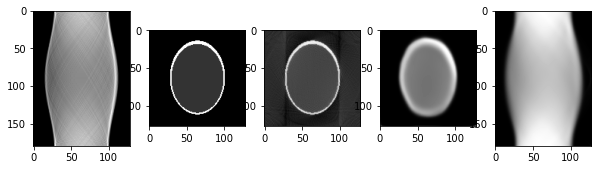

Epoch  165 ; Loss:  0.02244355


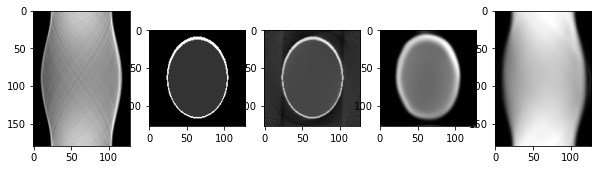

Epoch  166 ; Loss:  0.02254384


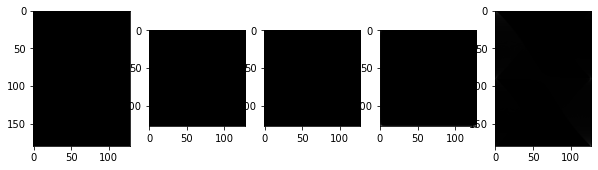

Epoch  167 ; Loss:  0.022300912


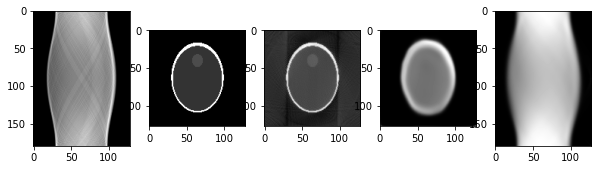

Epoch  168 ; Loss:  0.022153908


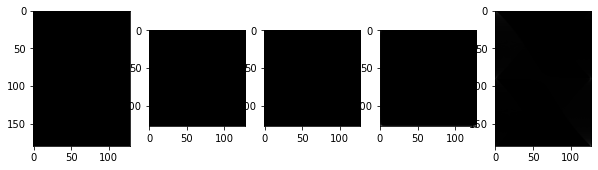

Epoch  169 ; Loss:  0.022130027


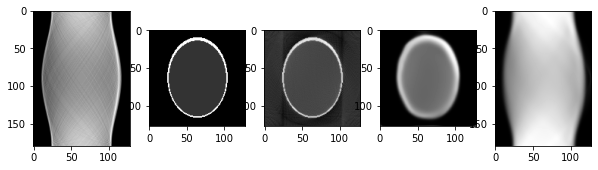

Epoch  170 ; Loss:  0.0218601


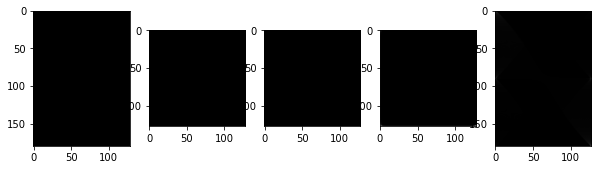

Epoch  171 ; Loss:  0.021614501


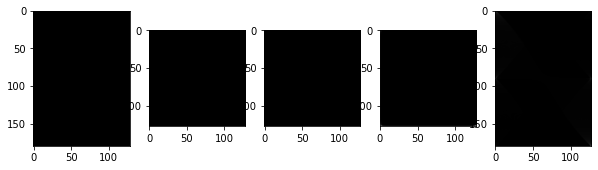

Epoch  172 ; Loss:  0.021508506


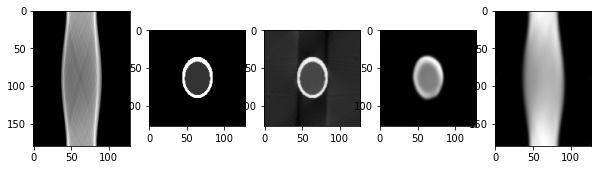

Epoch  173 ; Loss:  0.021428877


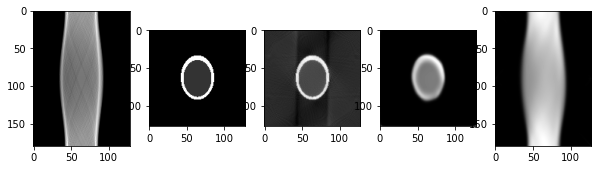

Epoch  174 ; Loss:  0.0214074


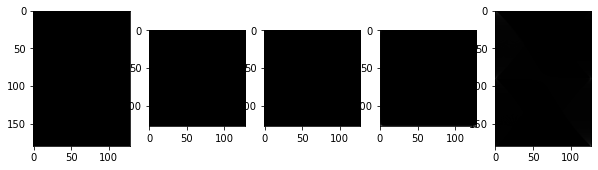

Epoch  175 ; Loss:  0.021186149


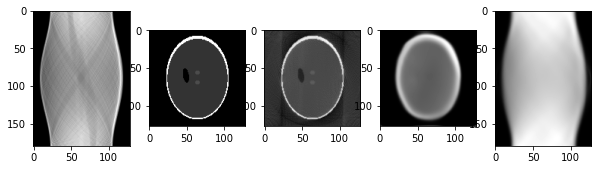

Epoch  176 ; Loss:  0.021247389


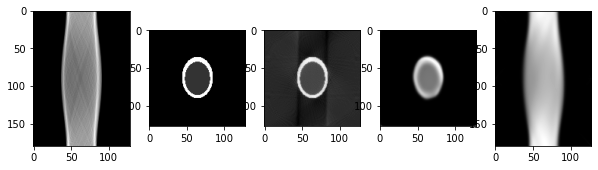

Epoch  177 ; Loss:  0.021593198


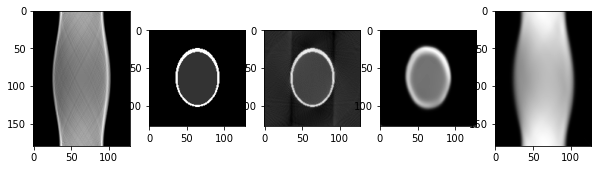

Epoch  178 ; Loss:  0.020656085


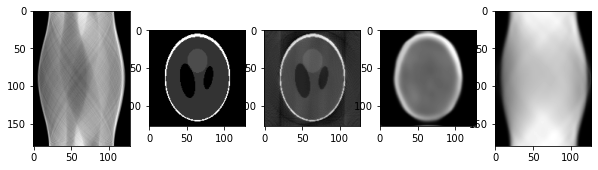

Epoch  179 ; Loss:  0.020669086


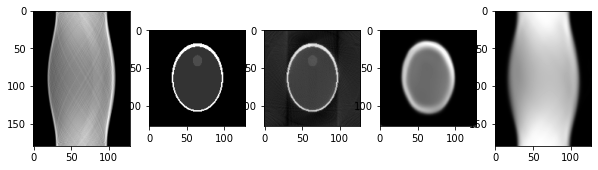

Epoch  180 ; Loss:  0.020593645


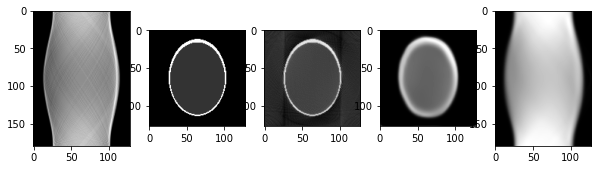

Epoch  181 ; Loss:  0.020469114


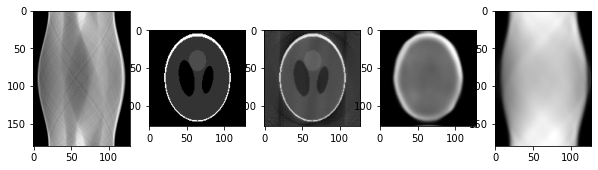

Epoch  182 ; Loss:  0.020468963


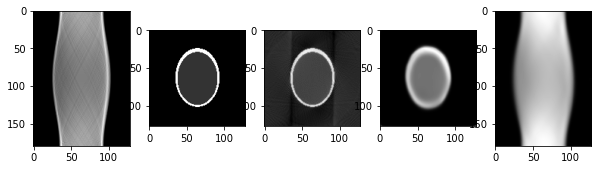

Epoch  183 ; Loss:  0.02027267


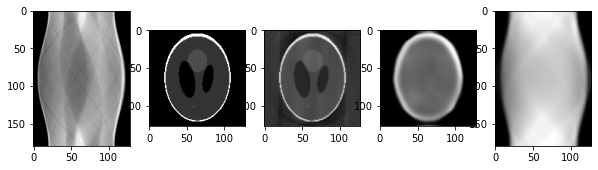

Epoch  184 ; Loss:  0.020123467


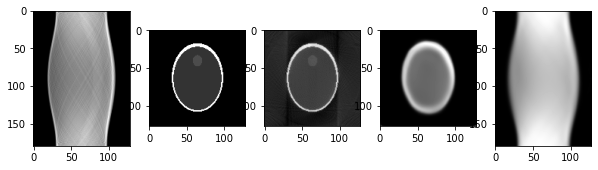

Epoch  185 ; Loss:  0.019945053


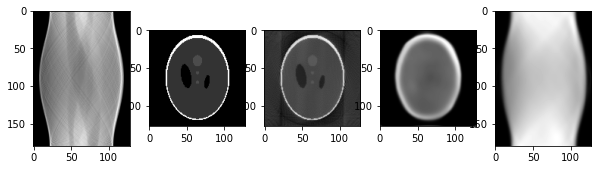

Epoch  186 ; Loss:  0.019886004


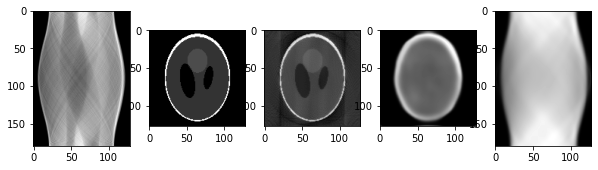

Epoch  187 ; Loss:  0.01983047


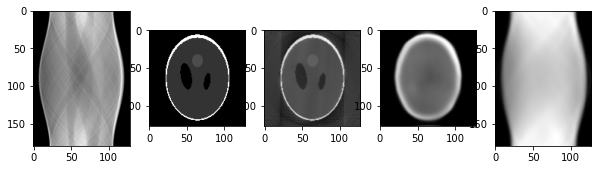

Epoch  188 ; Loss:  0.019664524


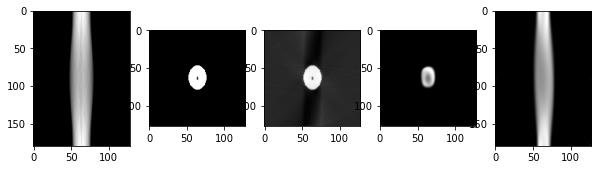

Epoch  189 ; Loss:  0.019394293


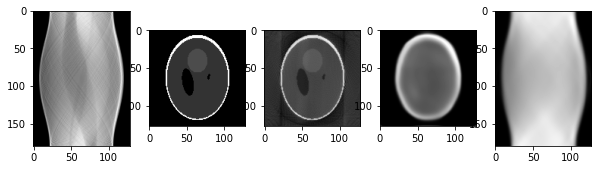

Epoch  190 ; Loss:  0.019373735


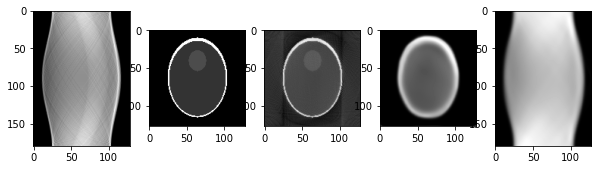

Epoch  191 ; Loss:  0.019438937


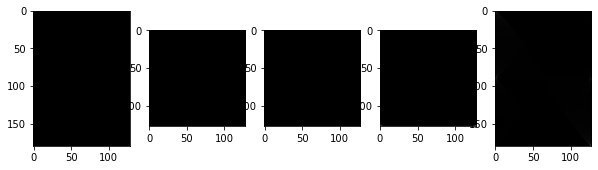

Epoch  192 ; Loss:  0.019183274


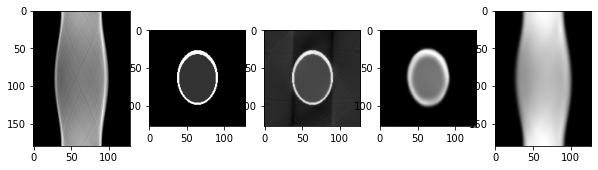

Epoch  193 ; Loss:  0.020283766


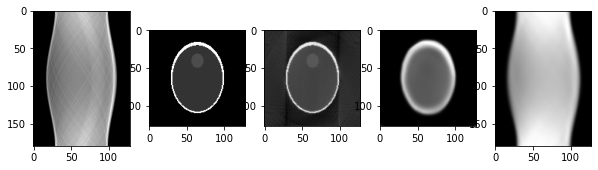

Epoch  194 ; Loss:  0.019957198


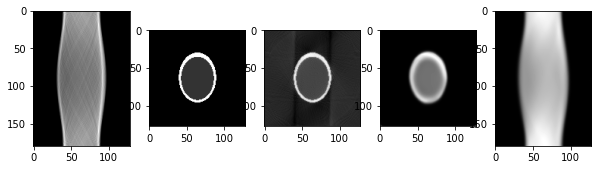

Epoch  195 ; Loss:  0.019351203


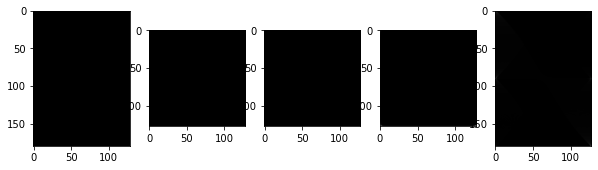

Epoch  196 ; Loss:  0.01915559


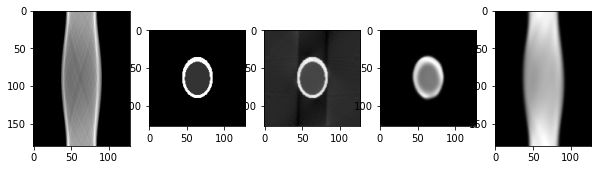

Epoch  197 ; Loss:  0.019030936


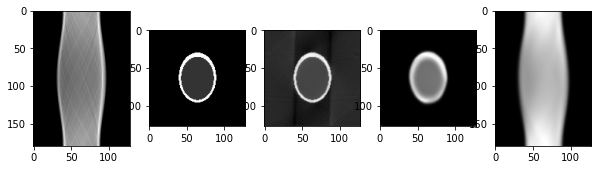

Epoch  198 ; Loss:  0.019145258


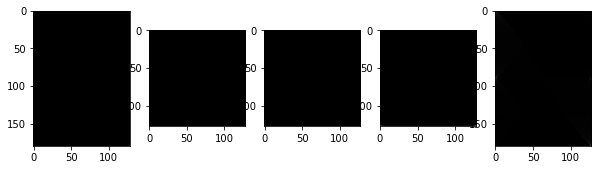

Epoch  199 ; Loss:  0.01892086


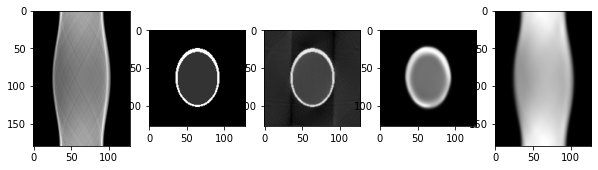

Epoch  200 ; Loss:  0.018830268


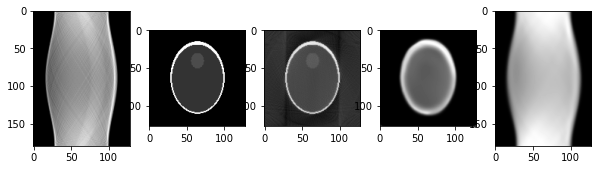

Epoch  201 ; Loss:  0.019632392


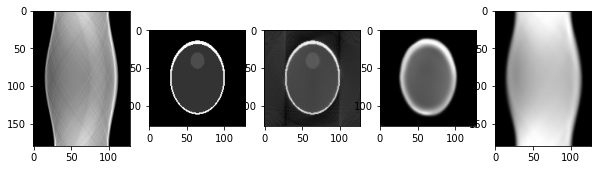

Epoch  202 ; Loss:  0.018650407


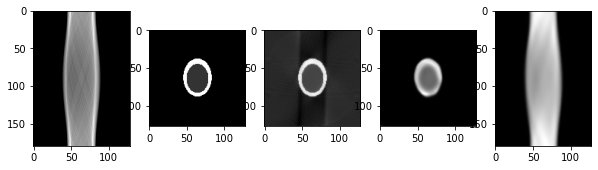

Epoch  203 ; Loss:  0.018947318


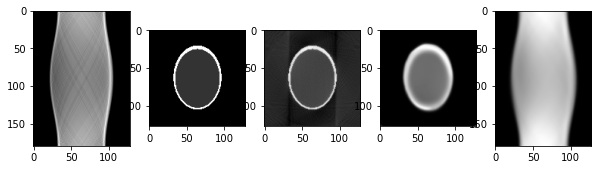

Epoch  204 ; Loss:  0.01849563


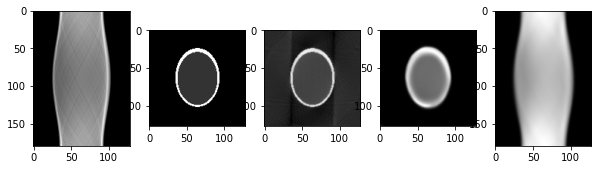

Epoch  205 ; Loss:  0.01846194


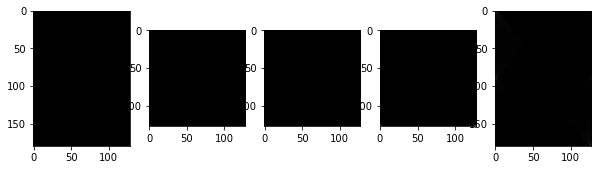

Epoch  206 ; Loss:  0.01822137


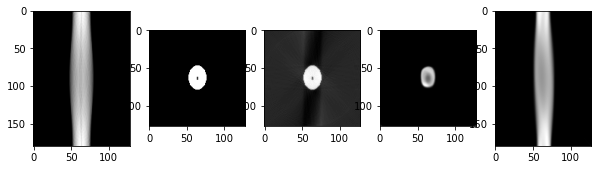

Epoch  207 ; Loss:  0.01821163


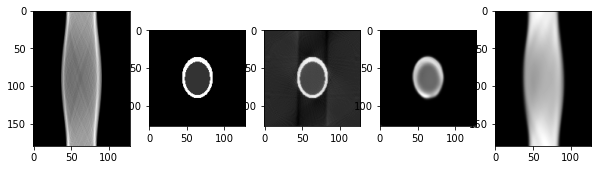

Epoch  208 ; Loss:  0.018008709


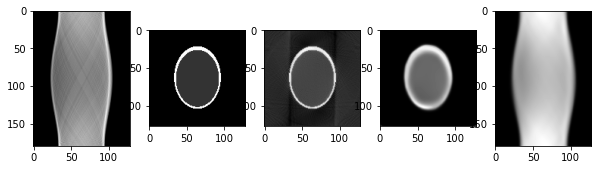

Epoch  209 ; Loss:  0.017828869


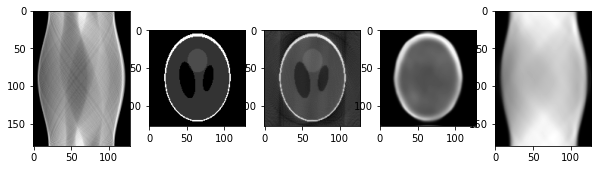

Epoch  210 ; Loss:  0.018187424


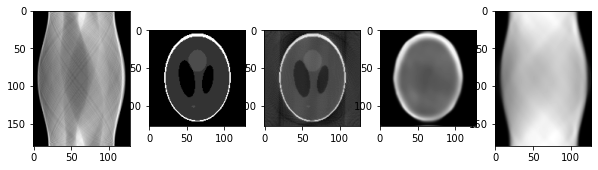

Epoch  211 ; Loss:  0.018277058


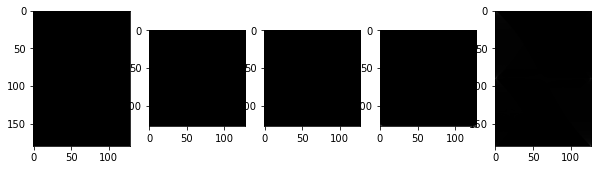

Epoch  212 ; Loss:  0.017880358


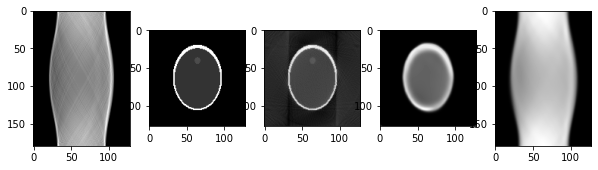

Epoch  213 ; Loss:  0.017781906


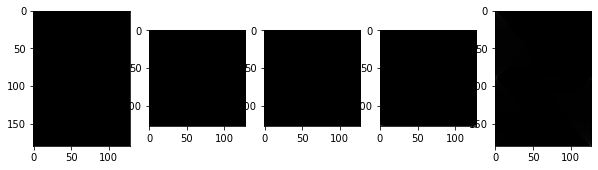

Epoch  214 ; Loss:  0.017719733


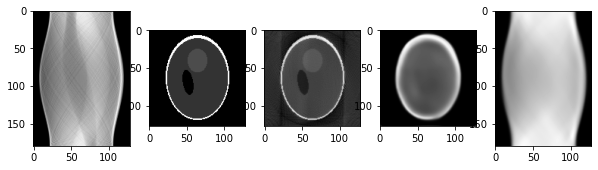

Epoch  215 ; Loss:  0.017436827


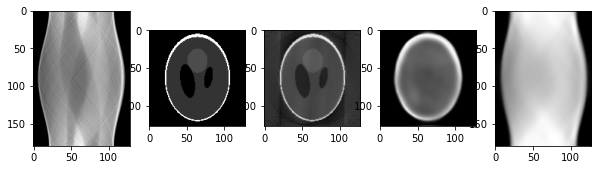

Epoch  216 ; Loss:  0.017623313


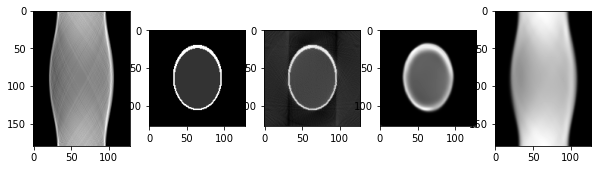

Epoch  217 ; Loss:  0.017537624


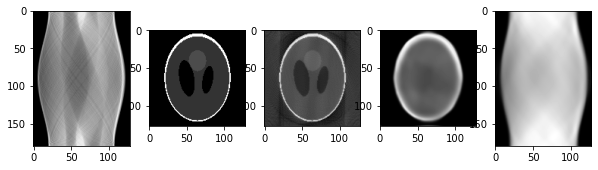

Epoch  218 ; Loss:  0.017133795


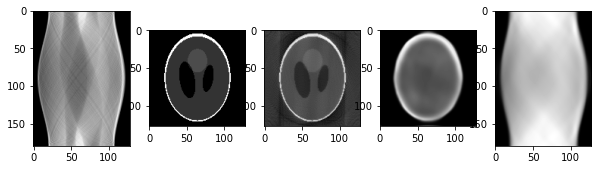

Epoch  219 ; Loss:  0.017026095


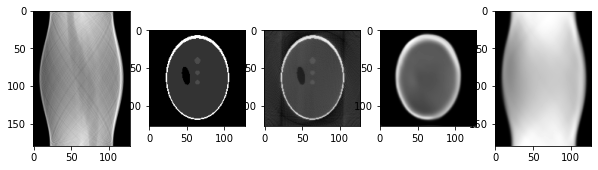

Epoch  220 ; Loss:  0.017116724


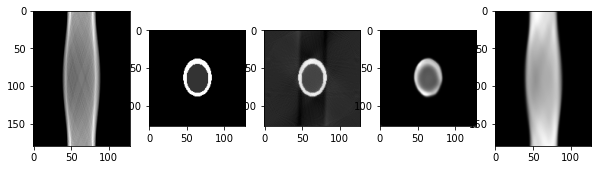

Epoch  221 ; Loss:  0.01731633


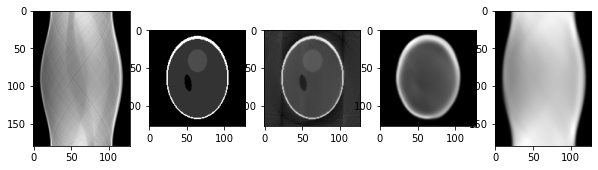

Epoch  222 ; Loss:  0.017223163


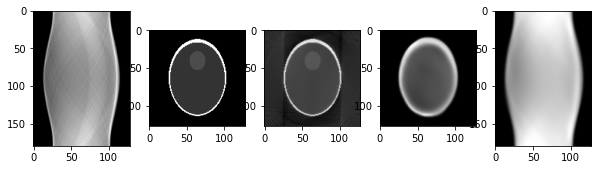

Epoch  223 ; Loss:  0.017134046


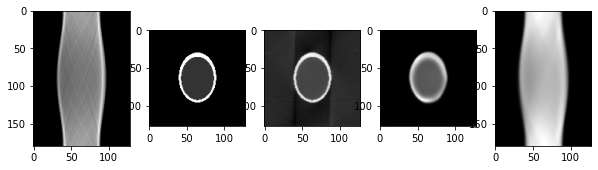

Epoch  224 ; Loss:  0.017459102


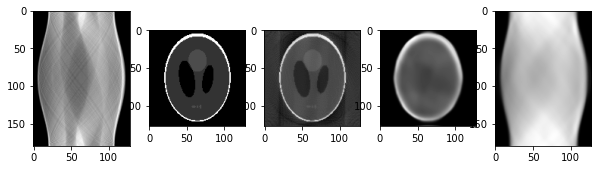

Epoch  225 ; Loss:  0.016953297


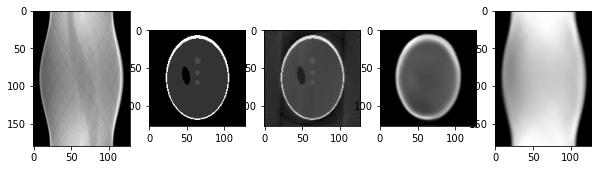

Epoch  226 ; Loss:  0.016768977


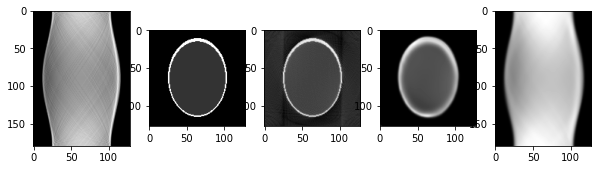

Epoch  227 ; Loss:  0.016878355


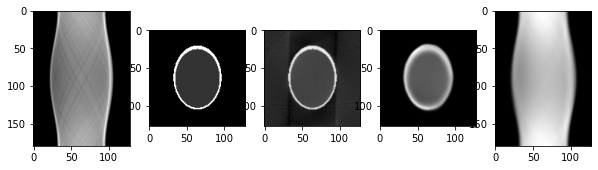

Epoch  228 ; Loss:  0.016726956


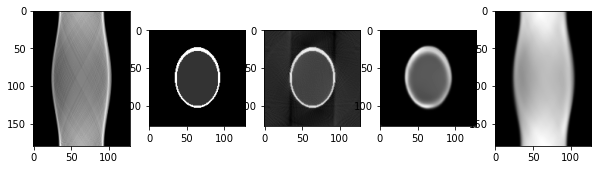

Epoch  229 ; Loss:  0.01662376


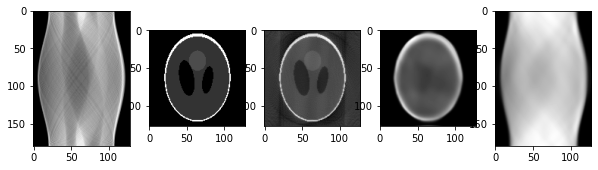

Epoch  230 ; Loss:  0.016614435


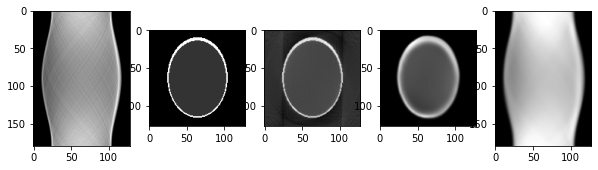

Epoch  231 ; Loss:  0.016619995


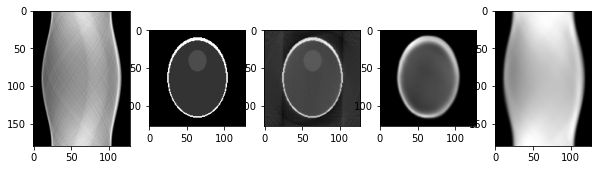

Epoch  232 ; Loss:  0.016389152


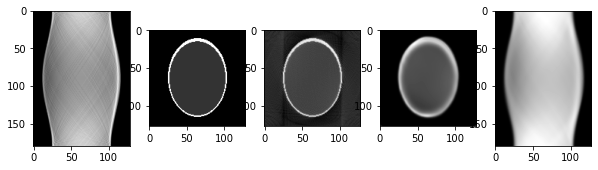

Epoch  233 ; Loss:  0.016310254


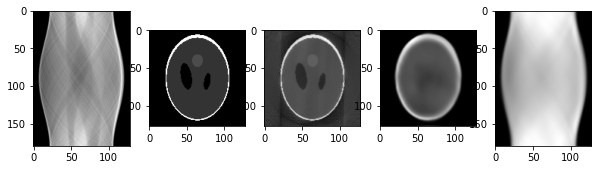

Epoch  234 ; Loss:  0.016648896


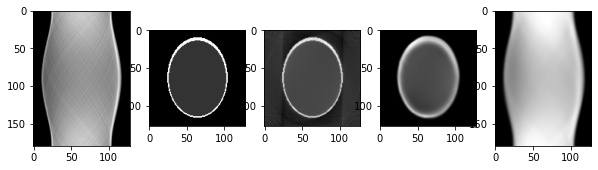

Epoch  235 ; Loss:  0.016375313


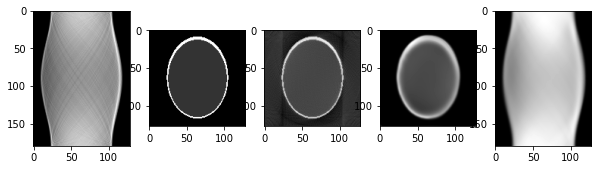

Epoch  236 ; Loss:  0.016133487


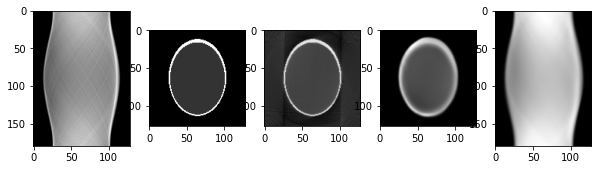

Epoch  237 ; Loss:  0.016270613


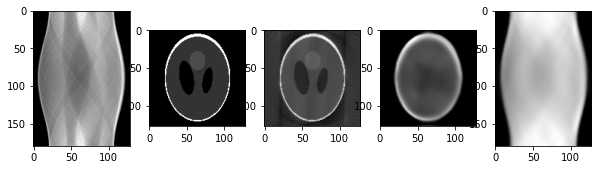

Epoch  238 ; Loss:  0.016276434


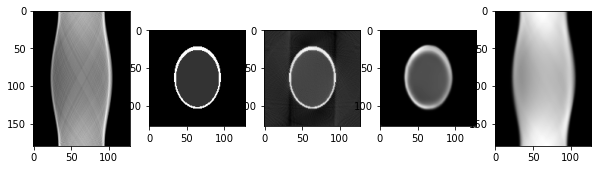

Epoch  239 ; Loss:  0.016710838


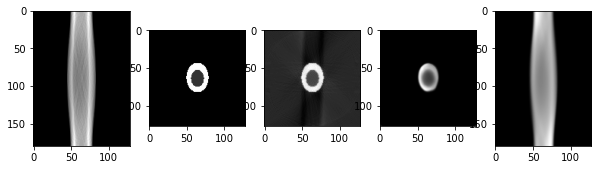

Epoch  240 ; Loss:  0.01606988


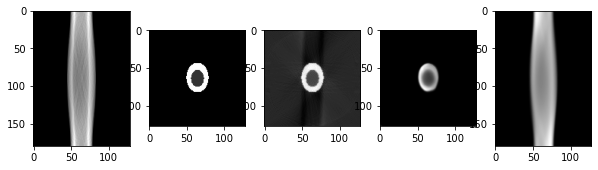

Epoch  241 ; Loss:  0.016647294


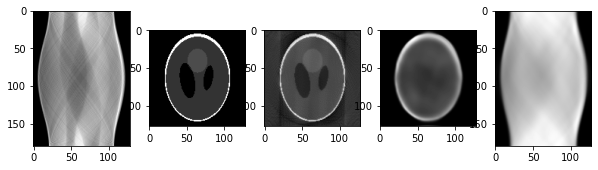

Epoch  242 ; Loss:  0.016791321


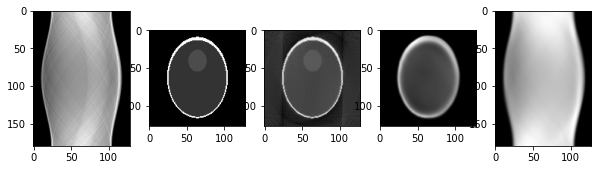

Epoch  243 ; Loss:  0.015885646


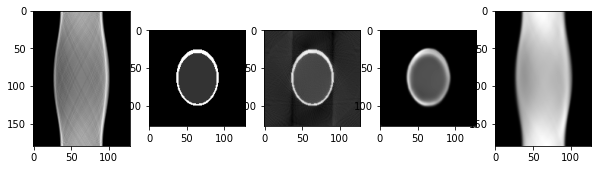

Epoch  244 ; Loss:  0.015980043


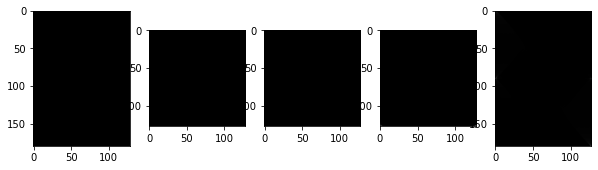

Epoch  245 ; Loss:  0.01644257


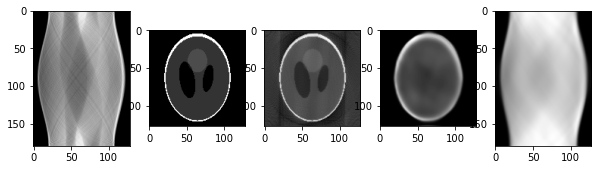

Epoch  246 ; Loss:  0.015781898


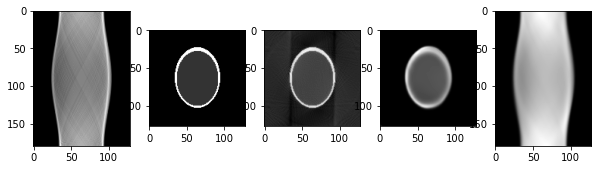

Epoch  247 ; Loss:  0.015759945


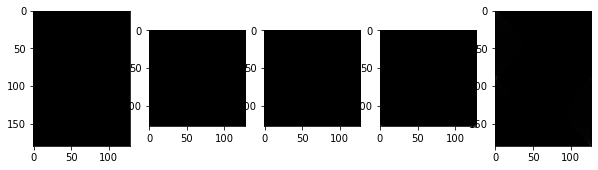

Epoch  248 ; Loss:  0.015869731


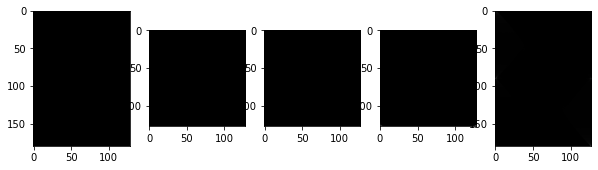

Epoch  249 ; Loss:  0.016014418


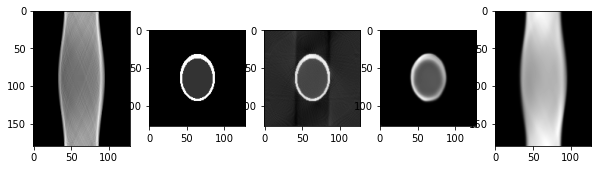

Epoch  250 ; Loss:  0.015713079


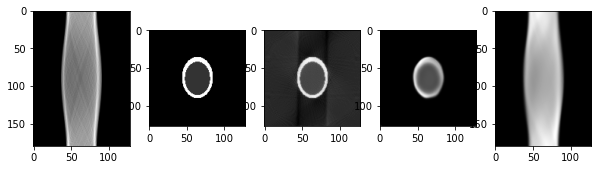

Epoch  251 ; Loss:  0.015723852


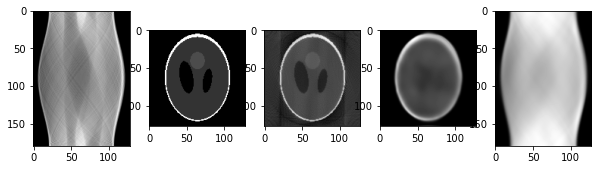

Epoch  252 ; Loss:  0.015516145


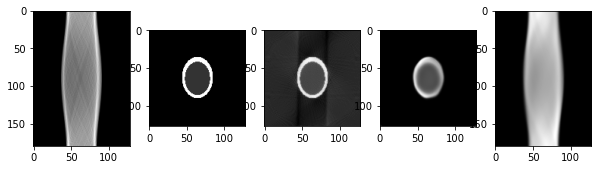

Epoch  253 ; Loss:  0.015662707


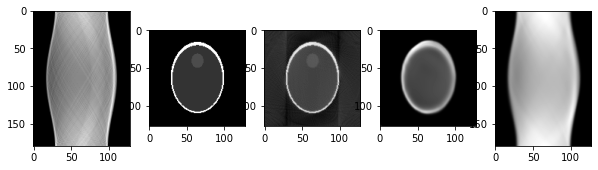

Epoch  254 ; Loss:  0.015406668


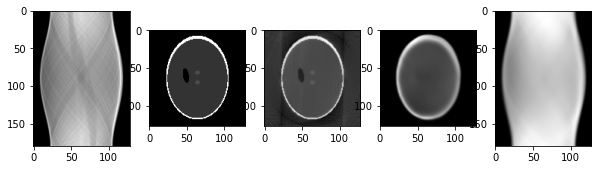

Epoch  255 ; Loss:  0.0154824685


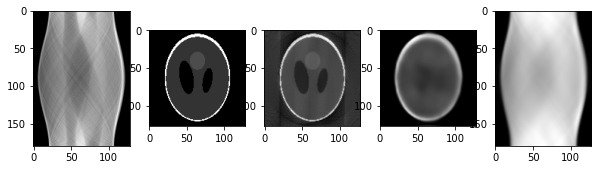

Epoch  256 ; Loss:  0.0153055


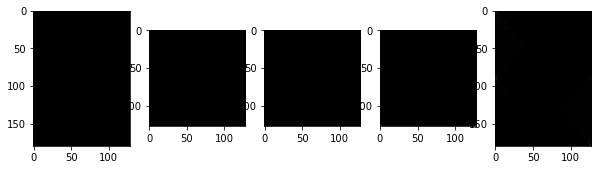

Epoch  257 ; Loss:  0.015357617


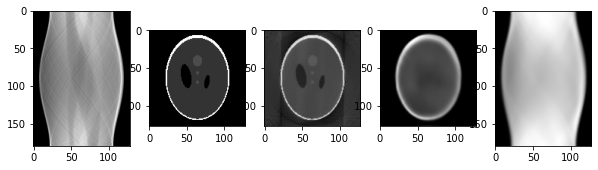

Epoch  258 ; Loss:  0.015278971


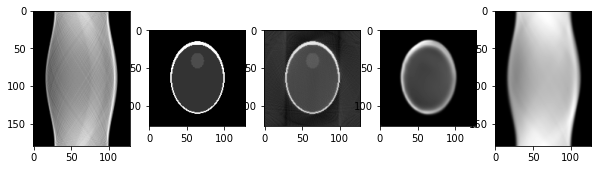

Epoch  259 ; Loss:  0.015355376


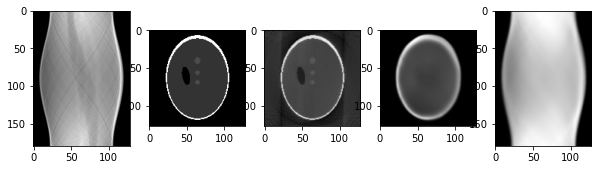

Epoch  260 ; Loss:  0.015718242


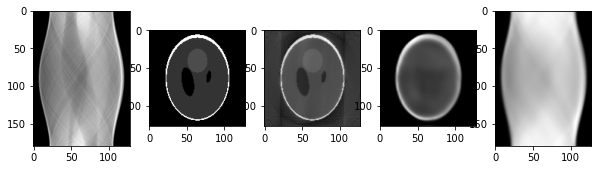

Epoch  261 ; Loss:  0.016004981


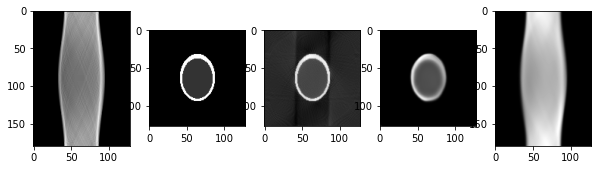

Epoch  262 ; Loss:  0.015228841


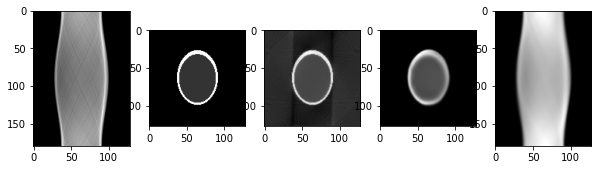

Epoch  263 ; Loss:  0.015028127


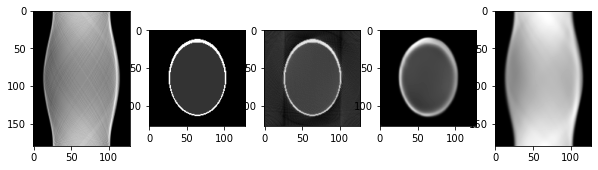

Epoch  264 ; Loss:  0.015116629


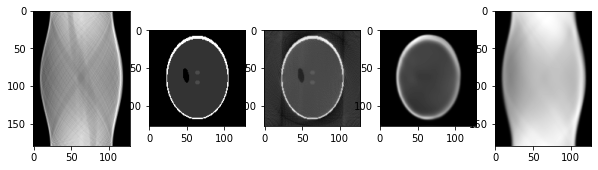

Epoch  265 ; Loss:  0.015271842


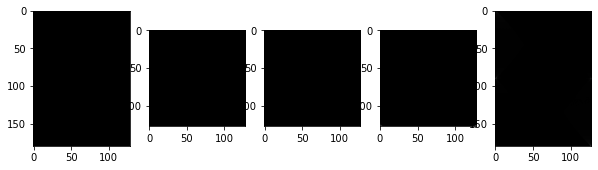

Epoch  266 ; Loss:  0.015055105


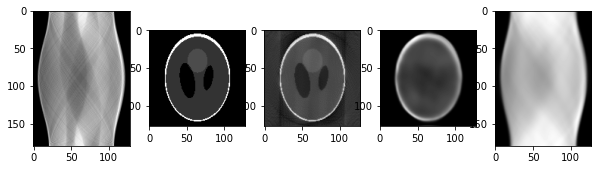

Epoch  267 ; Loss:  0.015033461


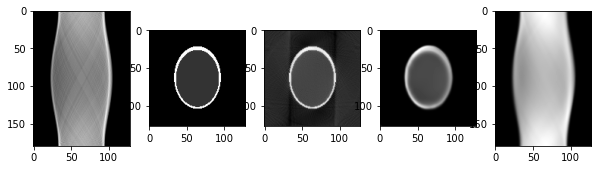

Epoch  268 ; Loss:  0.015178765


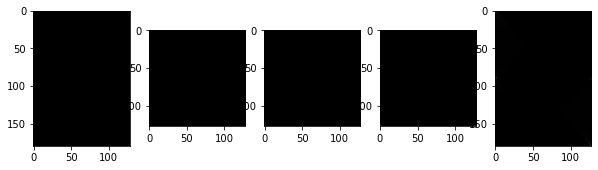

Epoch  269 ; Loss:  0.014989865


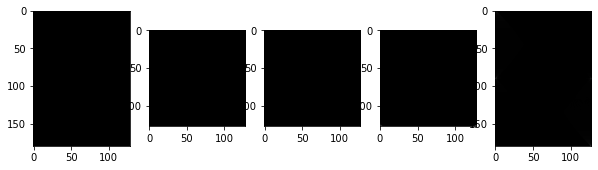

Epoch  270 ; Loss:  0.014946374


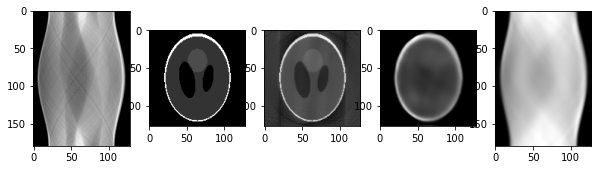

Epoch  271 ; Loss:  0.014819487


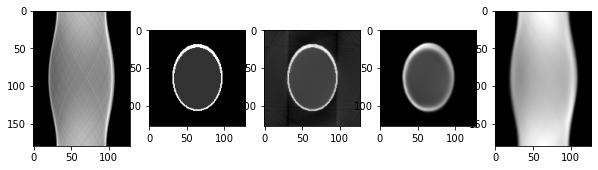

Epoch  272 ; Loss:  0.014755043


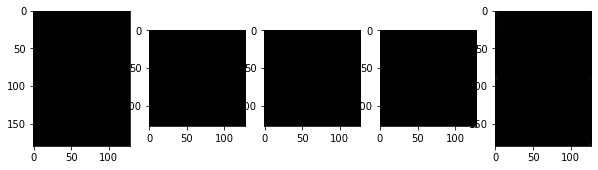

Epoch  273 ; Loss:  0.014928862


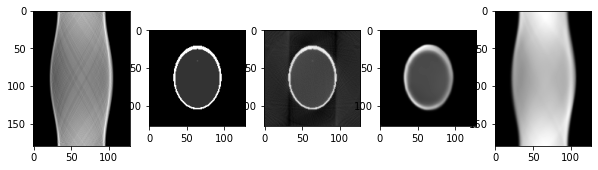

Epoch  274 ; Loss:  0.014927482


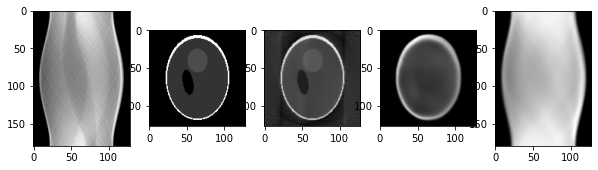

Epoch  275 ; Loss:  0.014892069


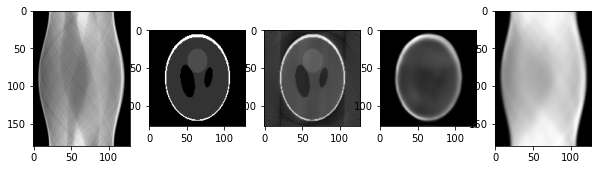

Epoch  276 ; Loss:  0.014728396


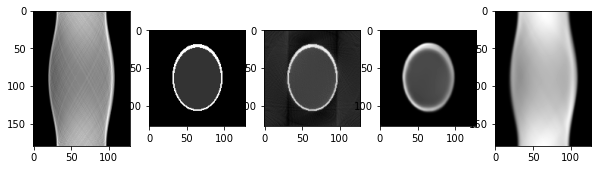

Epoch  277 ; Loss:  0.014938501


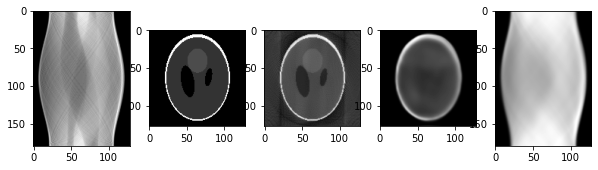

Epoch  278 ; Loss:  0.014568913


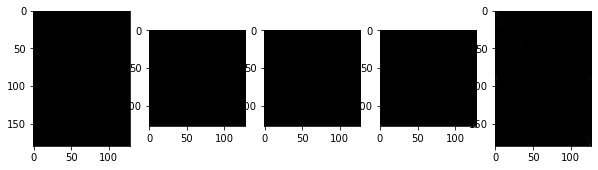

Epoch  279 ; Loss:  0.014807222


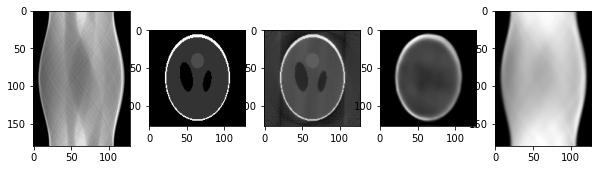

Epoch  280 ; Loss:  0.014849947


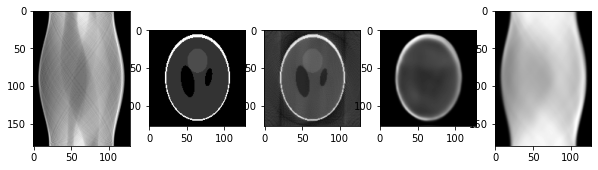

Epoch  281 ; Loss:  0.014940865


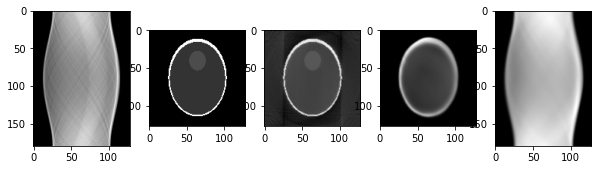

Epoch  282 ; Loss:  0.015385047


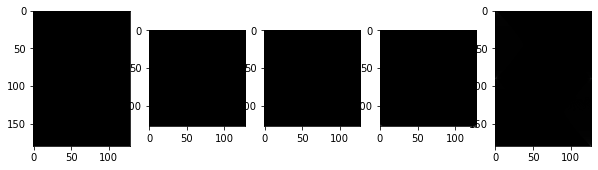

Epoch  283 ; Loss:  0.015393088


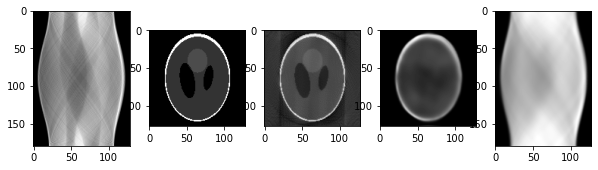

Epoch  284 ; Loss:  0.014652795


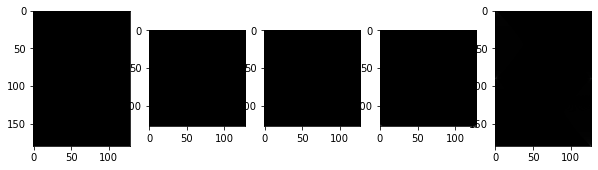

Epoch  285 ; Loss:  0.014443455


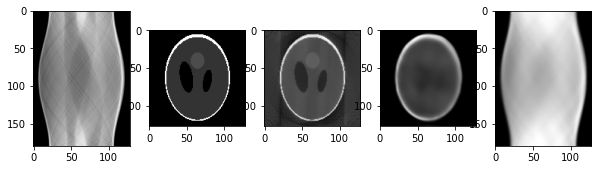

Epoch  286 ; Loss:  0.014704178


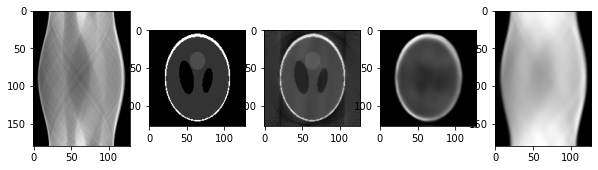

Epoch  287 ; Loss:  0.014707712


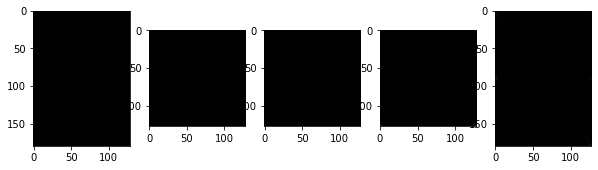

Epoch  288 ; Loss:  0.014211266


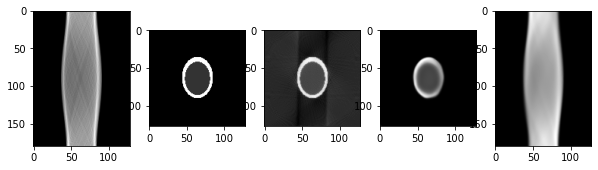

Epoch  289 ; Loss:  0.014275288


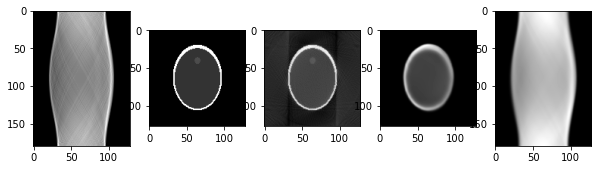

Epoch  290 ; Loss:  0.014187636


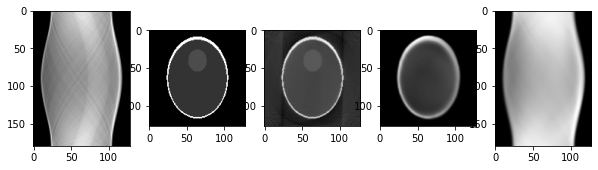

Epoch  291 ; Loss:  0.014161546


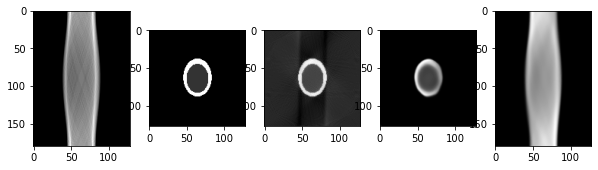

Epoch  292 ; Loss:  0.014347671


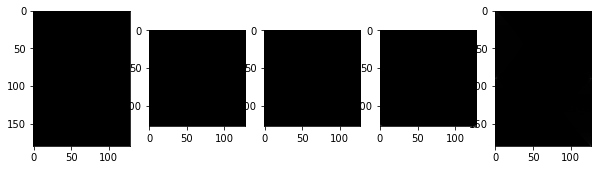

Epoch  293 ; Loss:  0.014302999


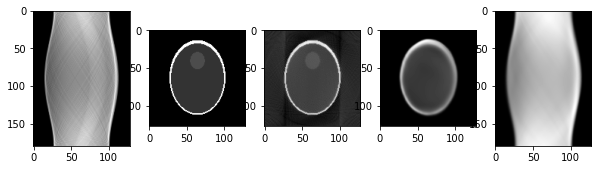

Epoch  294 ; Loss:  0.014357022


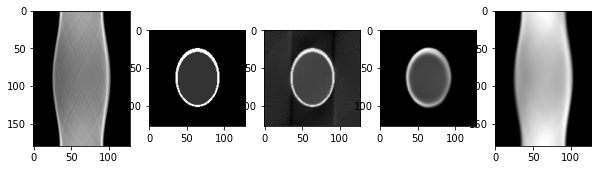

Epoch  295 ; Loss:  0.01409136


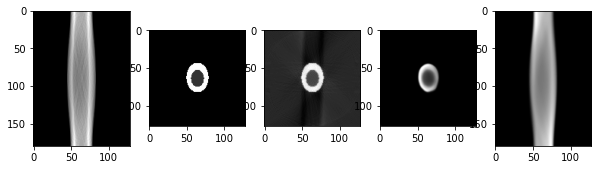

Epoch  296 ; Loss:  0.014104491


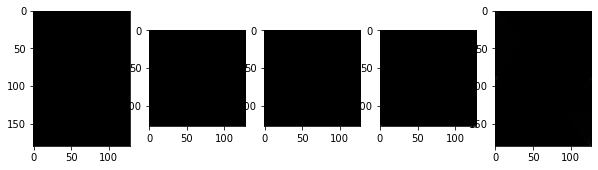

Epoch  297 ; Loss:  0.013993419


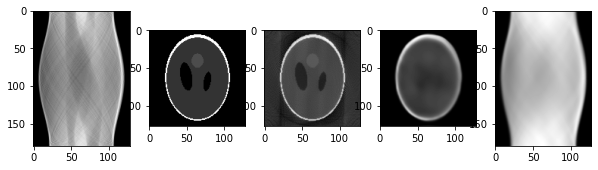

Epoch  298 ; Loss:  0.014218186


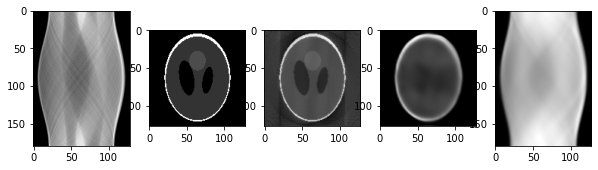

Epoch  299 ; Loss:  0.014129935


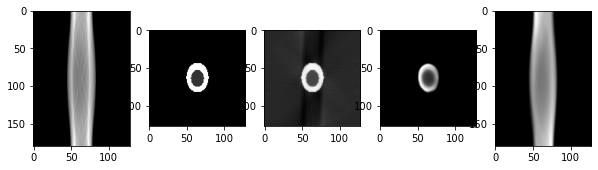

Epoch  300 ; Loss:  0.015104099


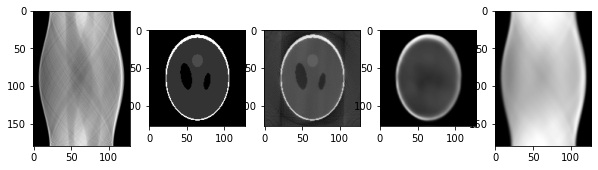

Epoch  301 ; Loss:  0.014477833


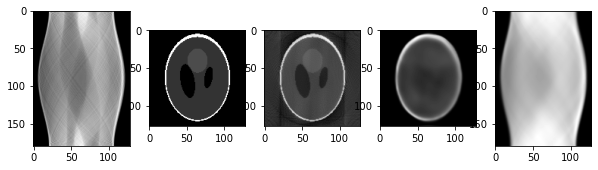

Epoch  302 ; Loss:  0.01382424


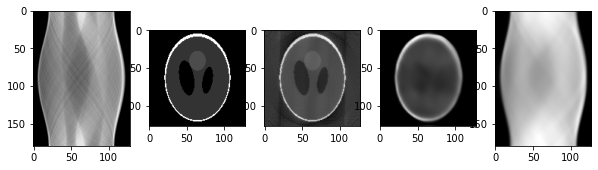

Epoch  303 ; Loss:  0.013919242


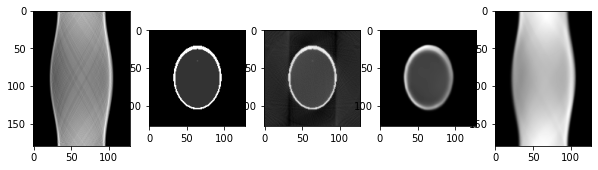

Epoch  304 ; Loss:  0.013842619


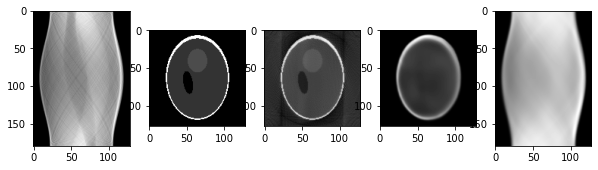

Epoch  305 ; Loss:  0.013785427


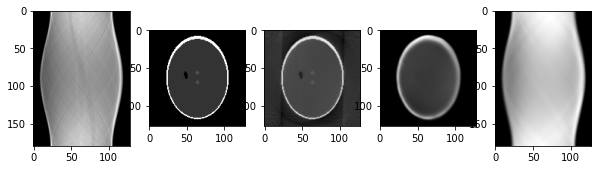

Epoch  306 ; Loss:  0.013653079


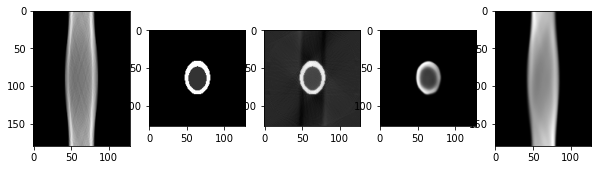

Epoch  307 ; Loss:  0.013880052


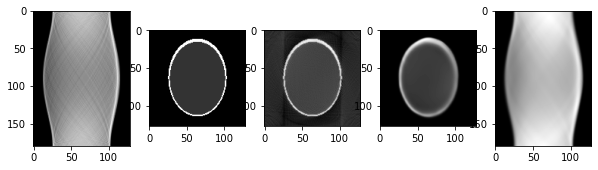

Epoch  308 ; Loss:  0.013698381


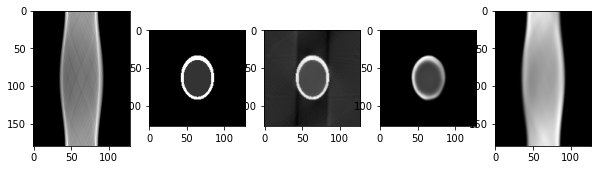

Epoch  309 ; Loss:  0.013836625


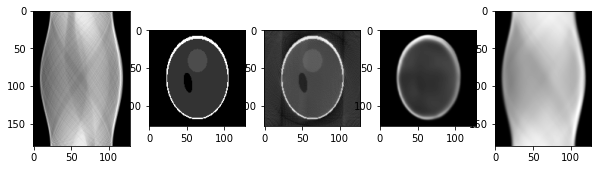

Epoch  310 ; Loss:  0.0144142


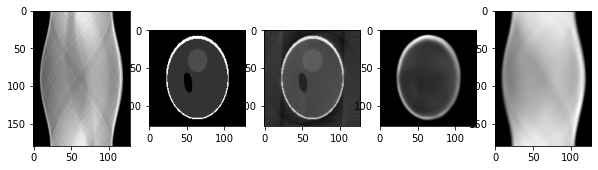

Epoch  311 ; Loss:  0.013616774


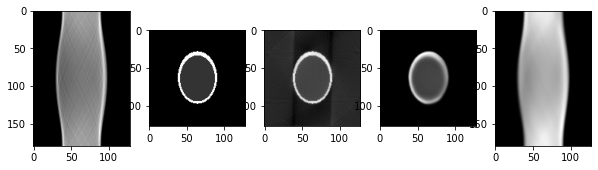

Epoch  312 ; Loss:  0.013460003


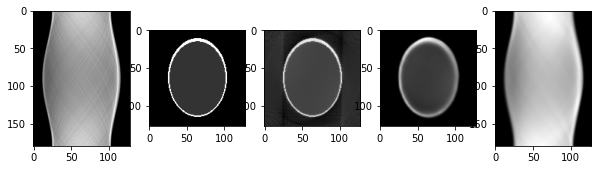

Epoch  313 ; Loss:  0.013536774


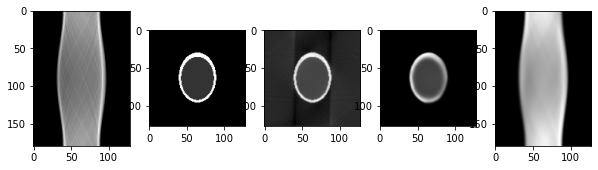

Epoch  314 ; Loss:  0.013423872


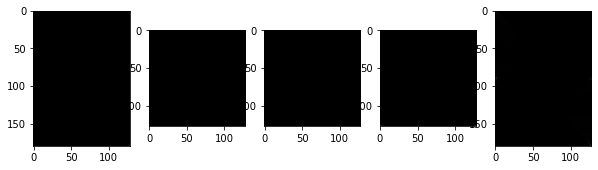

Epoch  315 ; Loss:  0.013594354


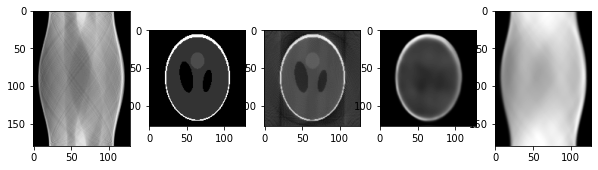

Epoch  316 ; Loss:  0.0133186355


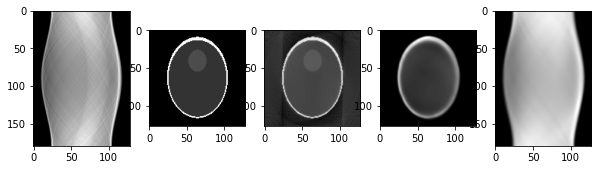

Epoch  317 ; Loss:  0.013243213


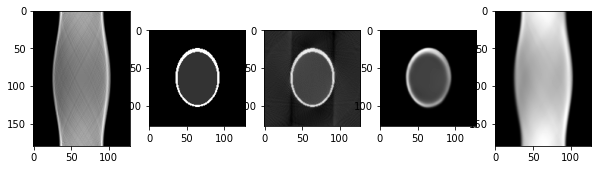

Epoch  318 ; Loss:  0.013628971


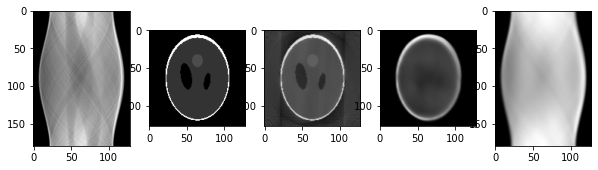

Epoch  319 ; Loss:  0.013607252


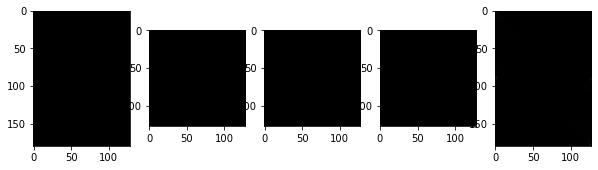

Epoch  320 ; Loss:  0.013222619


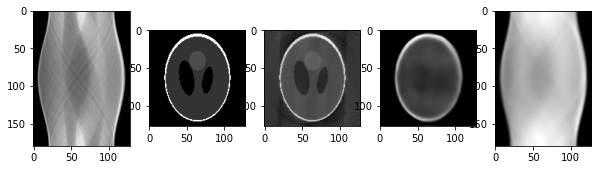

Epoch  321 ; Loss:  0.013281731


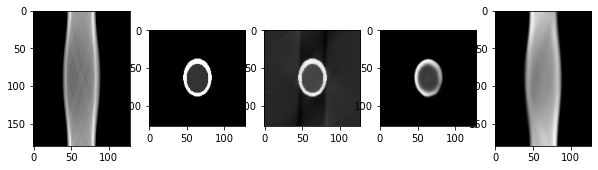

Epoch  322 ; Loss:  0.013152532


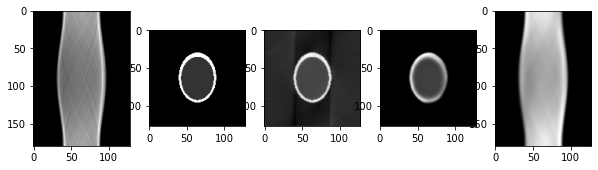

Epoch  323 ; Loss:  0.013248288


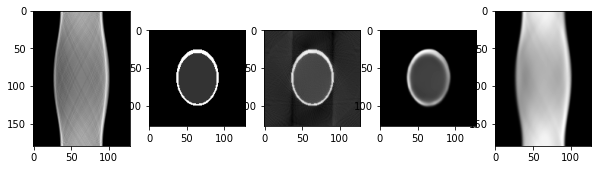

Epoch  324 ; Loss:  0.0130232


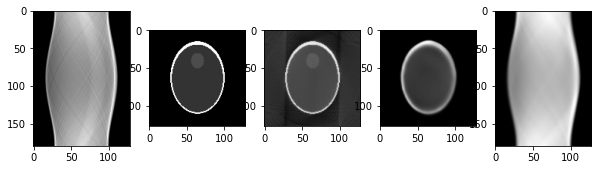

Epoch  325 ; Loss:  0.0133085055


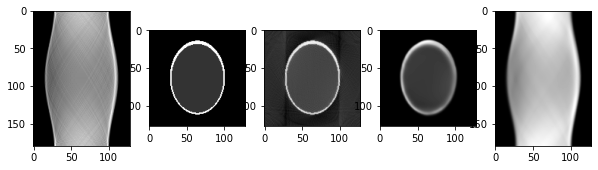

Epoch  326 ; Loss:  0.013481025


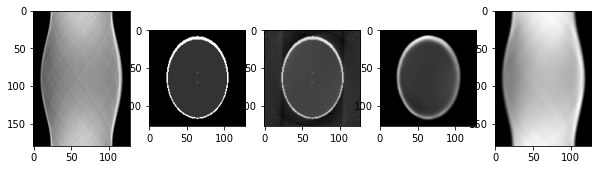

Epoch  327 ; Loss:  0.0132795265


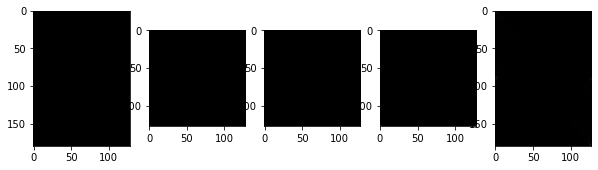

Epoch  328 ; Loss:  0.0130613735


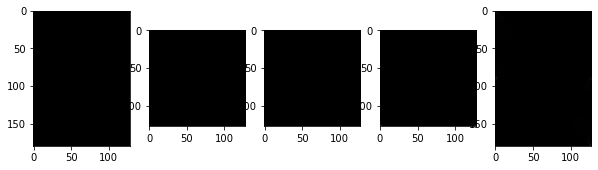

Epoch  329 ; Loss:  0.0131473765


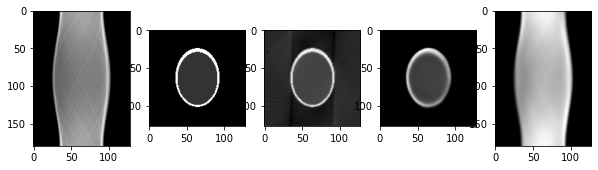

Epoch  330 ; Loss:  0.013041769


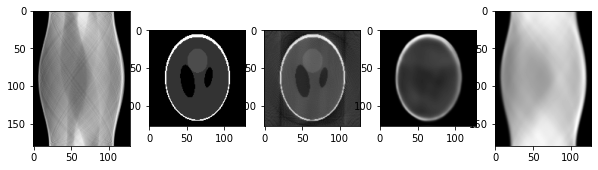

Epoch  331 ; Loss:  0.012853318


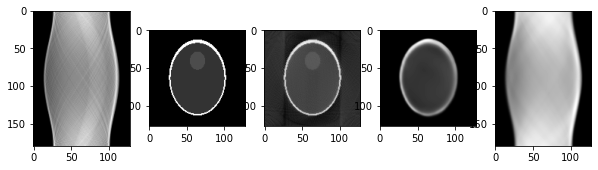

Epoch  332 ; Loss:  0.012761014


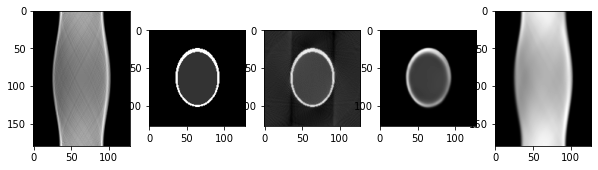

Epoch  333 ; Loss:  0.012961547


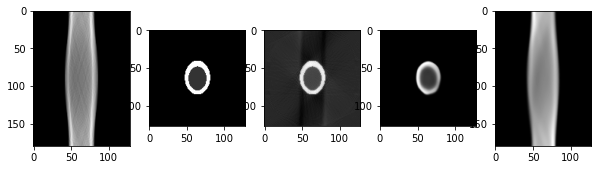

Epoch  334 ; Loss:  0.012895436


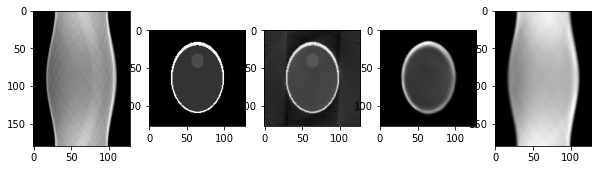

Epoch  335 ; Loss:  0.012725808


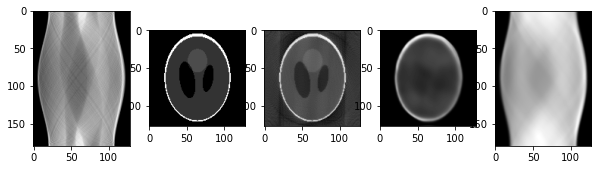

Epoch  336 ; Loss:  0.012798631


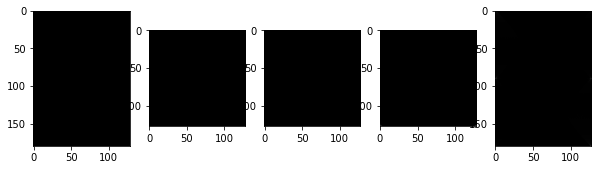

Epoch  337 ; Loss:  0.012713128


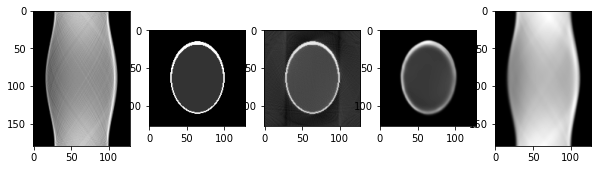

Epoch  338 ; Loss:  0.012553981


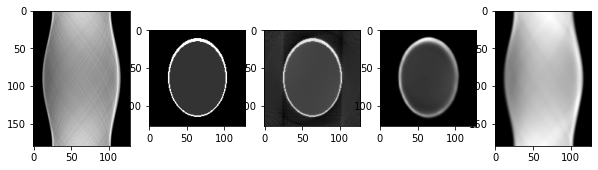

Epoch  339 ; Loss:  0.01251125


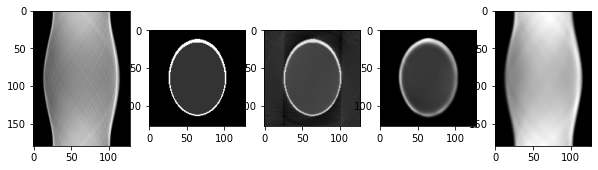

Epoch  340 ; Loss:  0.012643407


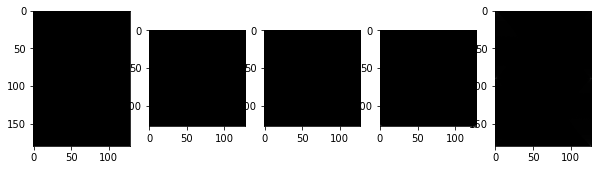

Epoch  341 ; Loss:  0.012560964


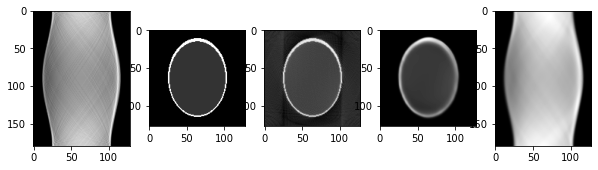

Epoch  342 ; Loss:  0.012484922


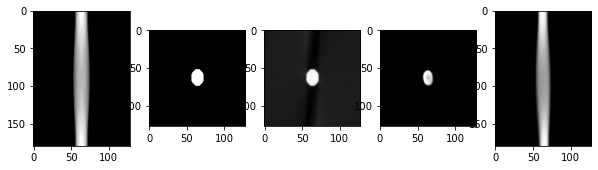

Epoch  343 ; Loss:  0.012668404


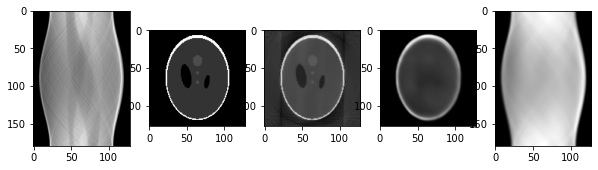

Epoch  344 ; Loss:  0.012575299


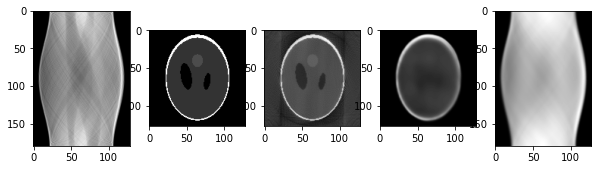

Epoch  345 ; Loss:  0.012607119


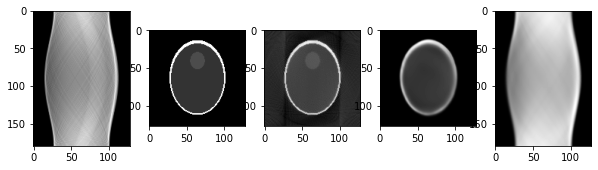

Epoch  346 ; Loss:  0.012278814


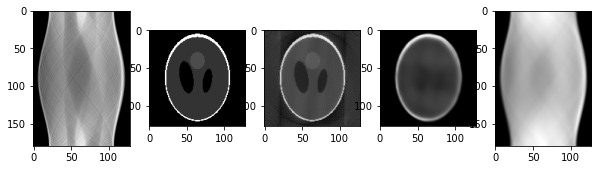

Epoch  347 ; Loss:  0.01236495


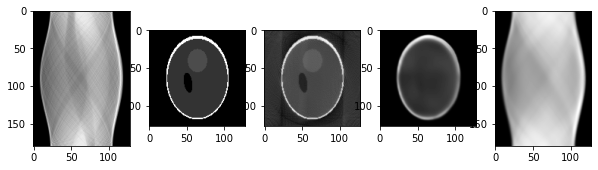

Epoch  348 ; Loss:  0.012428492


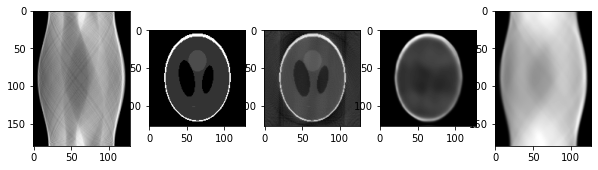

Epoch  349 ; Loss:  0.012421877


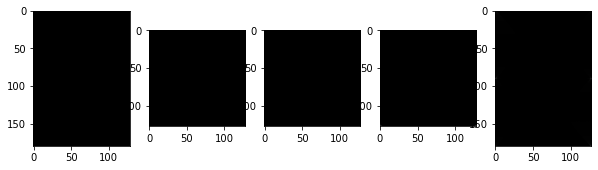

Epoch  350 ; Loss:  0.012245761


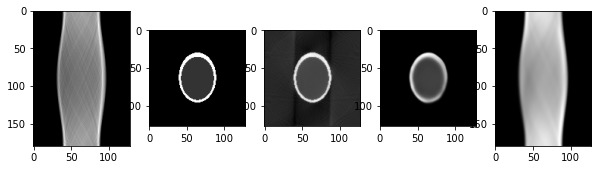

Epoch  351 ; Loss:  0.012457104


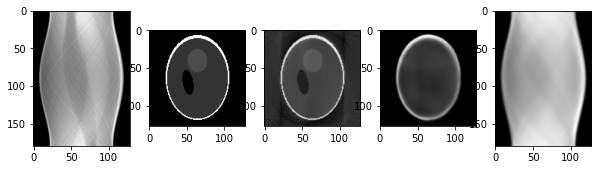

Epoch  352 ; Loss:  0.012206054


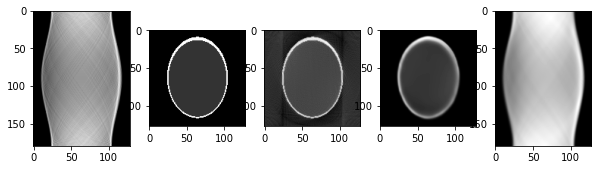

Epoch  353 ; Loss:  0.0128979


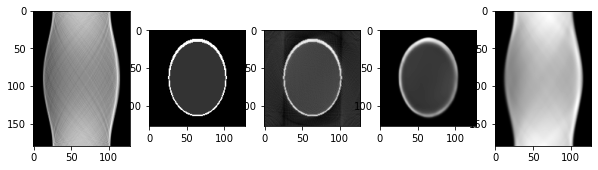

Epoch  354 ; Loss:  0.012451982


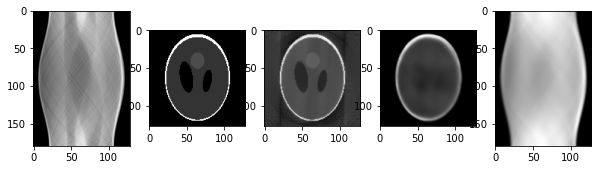

Epoch  355 ; Loss:  0.012193183


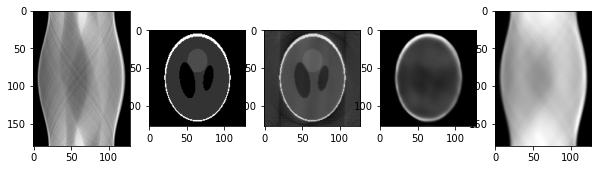

Epoch  356 ; Loss:  0.011977837


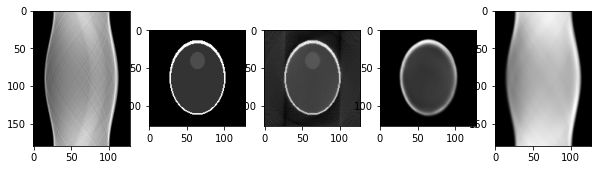

Epoch  357 ; Loss:  0.012195817


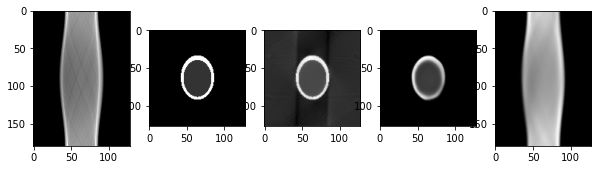

Epoch  358 ; Loss:  0.011989325


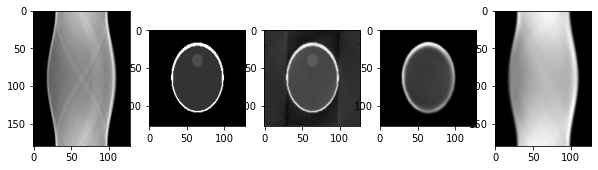

Epoch  359 ; Loss:  0.012100779


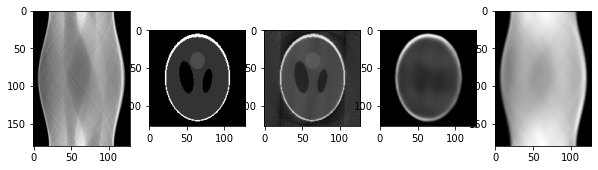

Epoch  360 ; Loss:  0.011904532


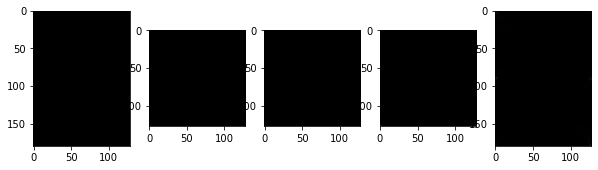

Epoch  361 ; Loss:  0.011987898


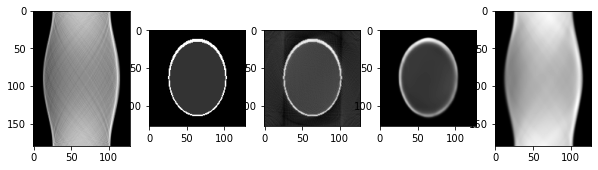

Epoch  362 ; Loss:  0.012125599


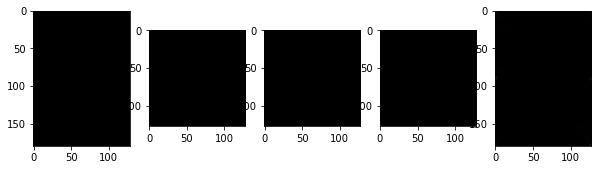

Epoch  363 ; Loss:  0.011965543


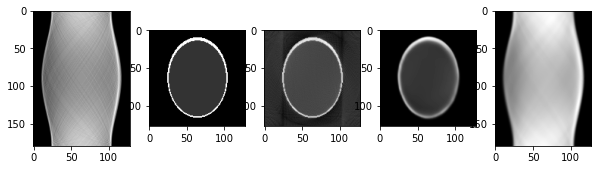

Epoch  364 ; Loss:  0.013189337


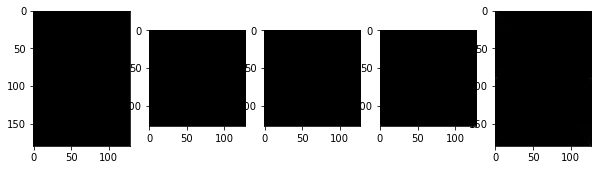

Epoch  365 ; Loss:  0.012101089


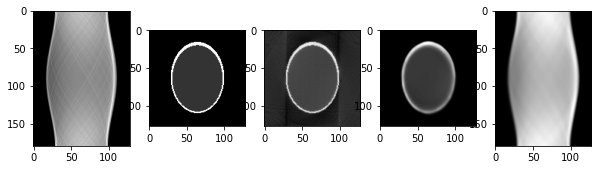

Epoch  366 ; Loss:  0.011859392


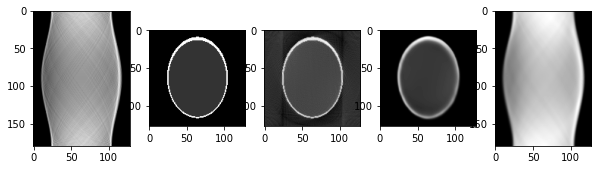

Epoch  367 ; Loss:  0.011933696


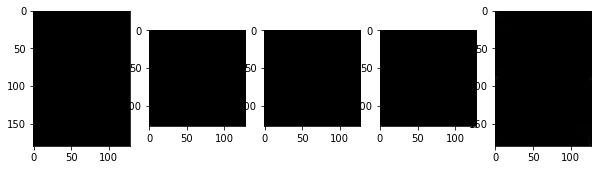

Epoch  368 ; Loss:  0.011887802


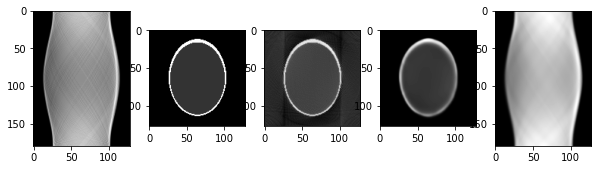

Epoch  369 ; Loss:  0.01168307


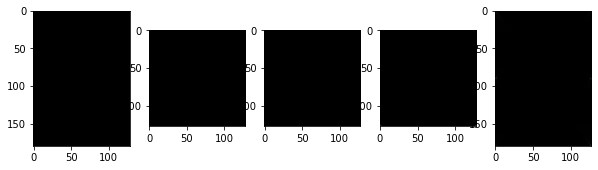

Epoch  370 ; Loss:  0.011854076


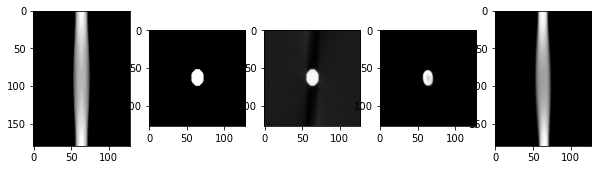

Epoch  371 ; Loss:  0.0118240705


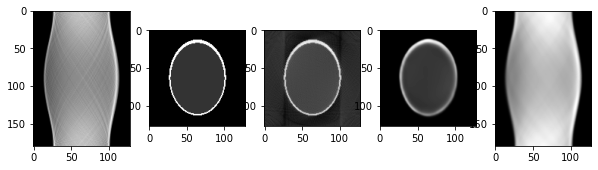

Epoch  372 ; Loss:  0.011853312


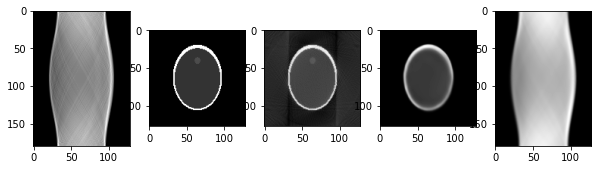

Epoch  373 ; Loss:  0.01162044


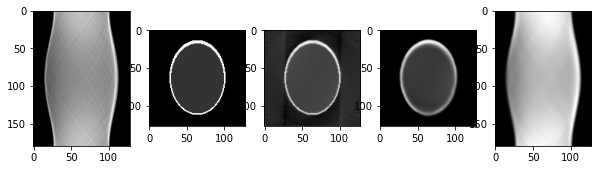

Epoch  374 ; Loss:  0.011518084


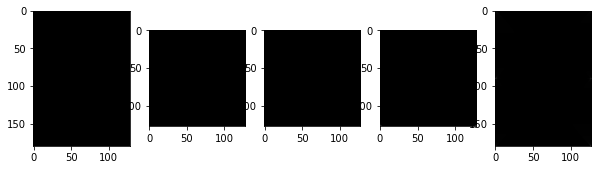

Epoch  375 ; Loss:  0.011503404


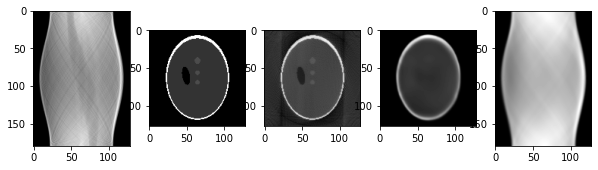

Epoch  376 ; Loss:  0.011638181


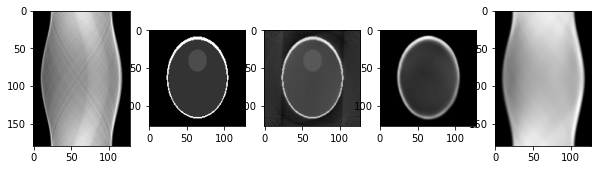

Epoch  377 ; Loss:  0.011656884


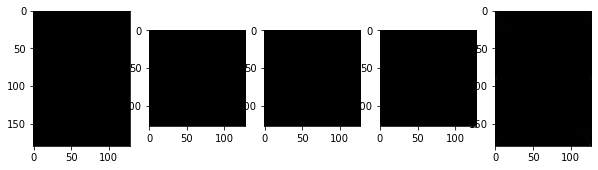

Epoch  378 ; Loss:  0.011422108


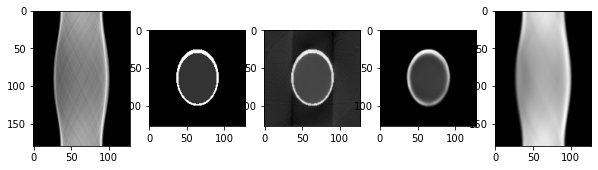

Epoch  379 ; Loss:  0.012229263


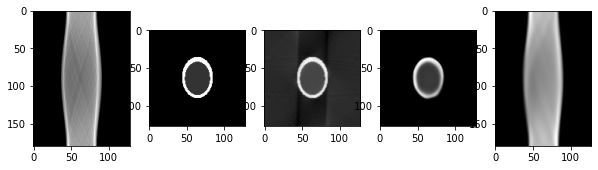

Epoch  380 ; Loss:  0.011421322


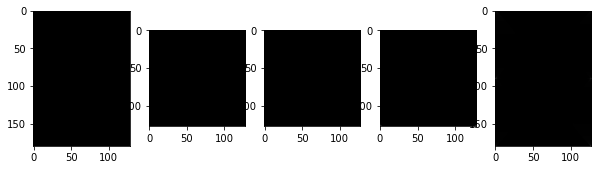

Epoch  381 ; Loss:  0.011571407


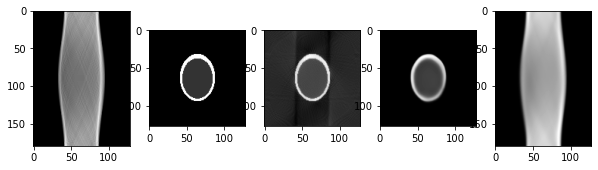

Epoch  382 ; Loss:  0.012376057


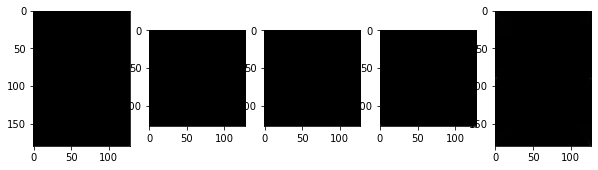

Epoch  383 ; Loss:  0.011471865


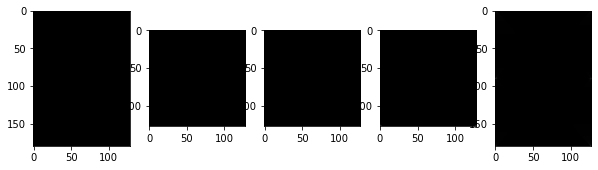

Epoch  384 ; Loss:  0.011499293


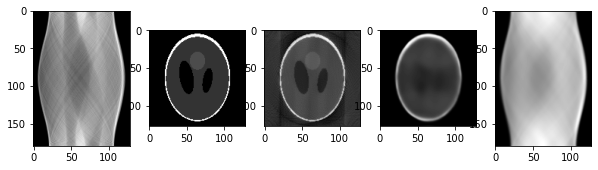

Epoch  385 ; Loss:  0.0113853915


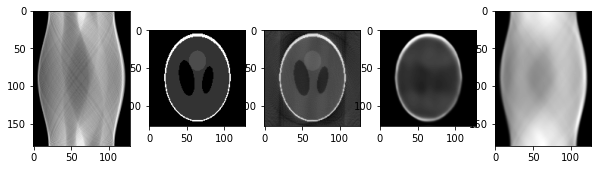

Epoch  386 ; Loss:  0.011144256


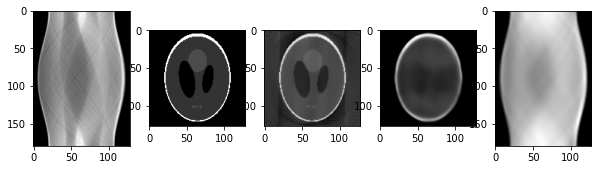

Epoch  387 ; Loss:  0.01133156


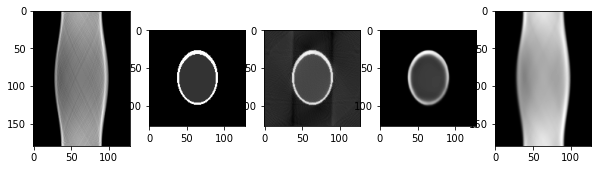

Epoch  388 ; Loss:  0.011137456


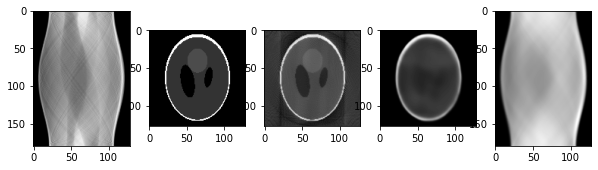

Epoch  389 ; Loss:  0.011326796


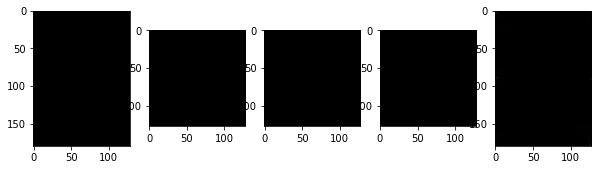

Epoch  390 ; Loss:  0.0110730985


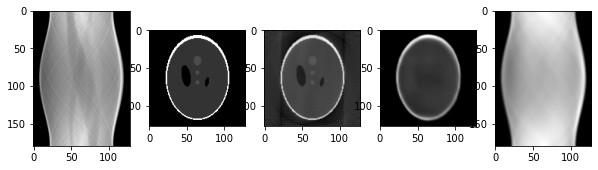

Epoch  391 ; Loss:  0.011033112


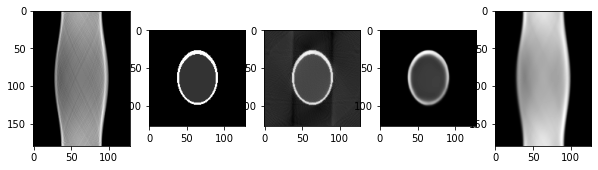

Epoch  392 ; Loss:  0.011645993


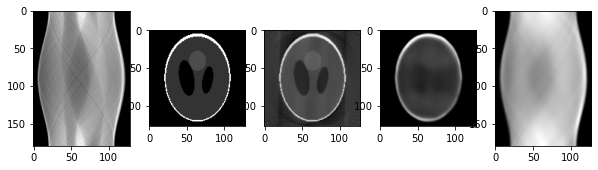

Epoch  393 ; Loss:  0.011297328


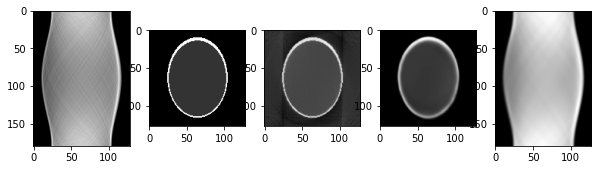

Epoch  394 ; Loss:  0.011004001


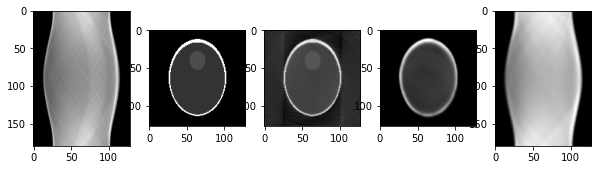

Epoch  395 ; Loss:  0.011352659


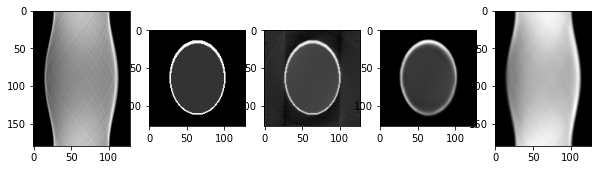

Epoch  396 ; Loss:  0.012517283


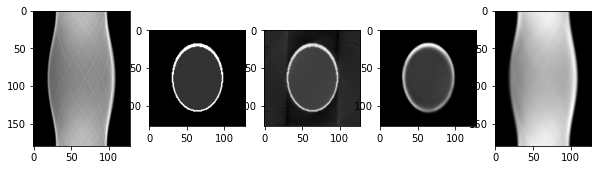

Epoch  397 ; Loss:  0.011535146


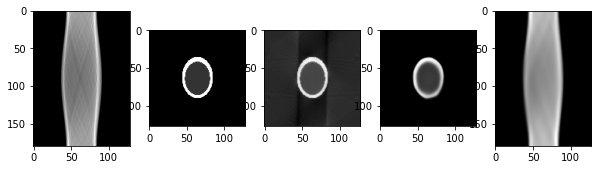

Epoch  398 ; Loss:  0.011065571


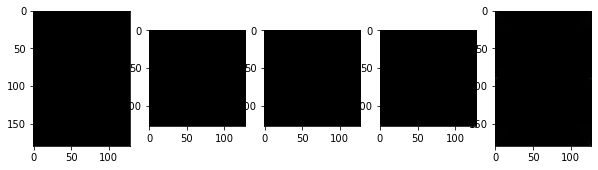

Epoch  399 ; Loss:  0.010885042


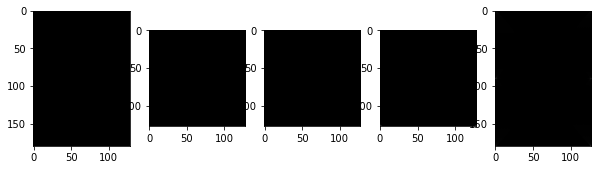

Epoch  400 ; Loss:  0.011052857


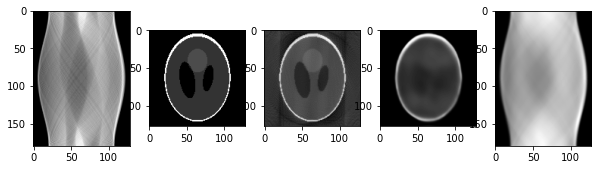

Epoch  401 ; Loss:  0.010978039


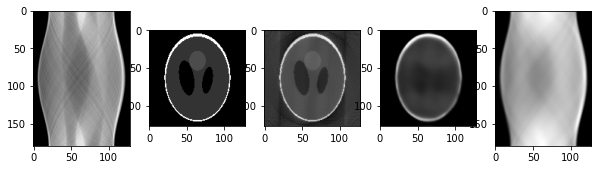

Epoch  402 ; Loss:  0.01133575


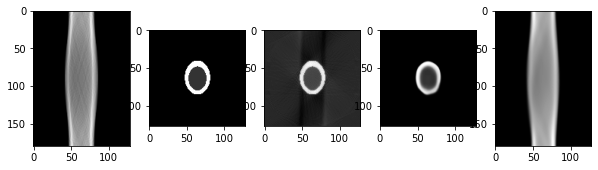

Epoch  403 ; Loss:  0.011222325


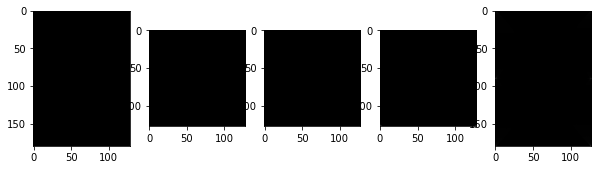

Epoch  404 ; Loss:  0.011106769


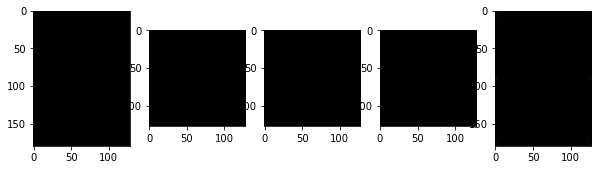

Epoch  405 ; Loss:  0.010944218


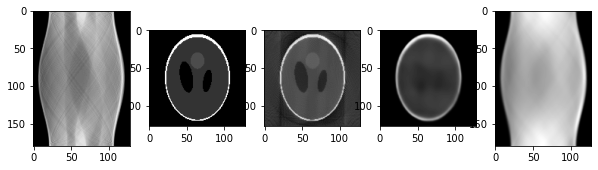

Epoch  406 ; Loss:  0.010768326


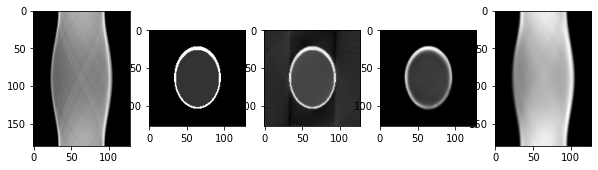

Epoch  407 ; Loss:  0.010719184


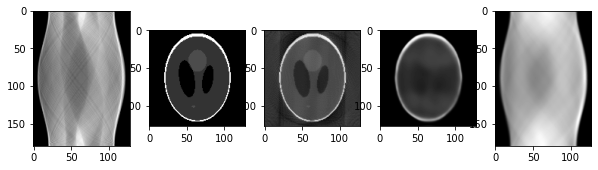

Epoch  408 ; Loss:  0.010736434


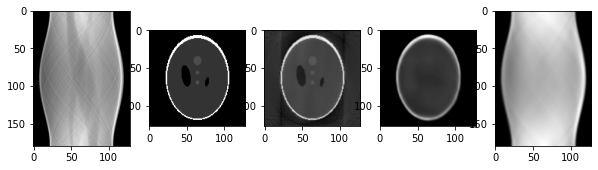

Epoch  409 ; Loss:  0.011171794


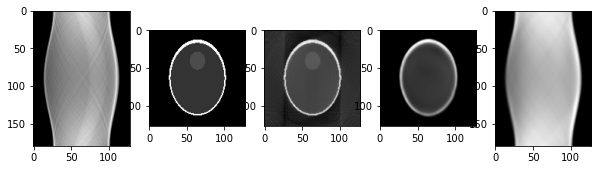

Epoch  410 ; Loss:  0.011128886


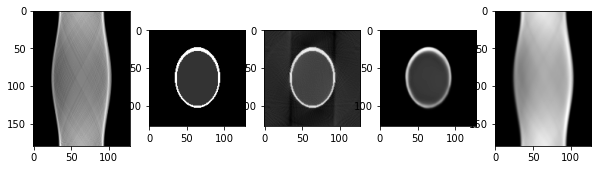

Epoch  411 ; Loss:  0.010746657


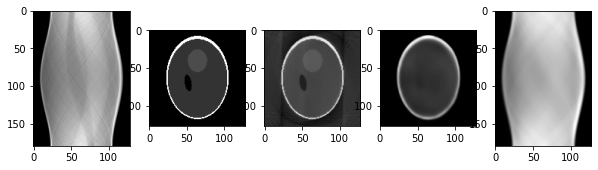

Epoch  412 ; Loss:  0.010761315


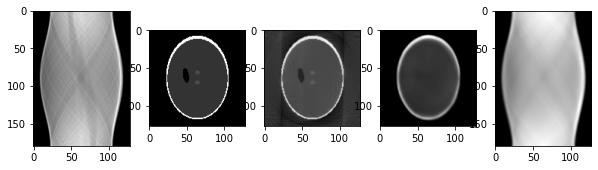

Epoch  413 ; Loss:  0.010602292


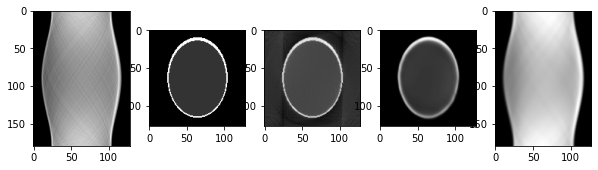

Epoch  414 ; Loss:  0.010571639


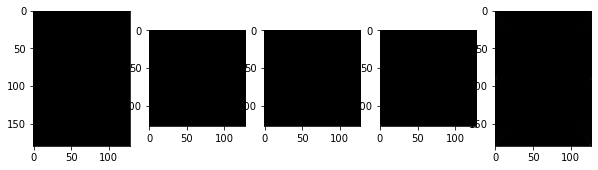

Epoch  415 ; Loss:  0.010847078


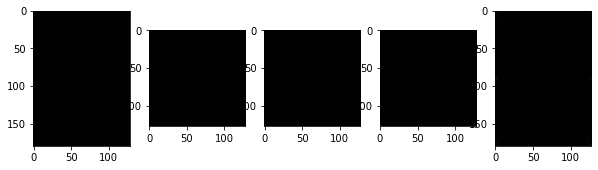

Epoch  416 ; Loss:  0.010584105


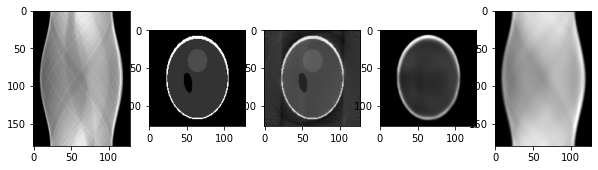

Epoch  417 ; Loss:  0.010564369


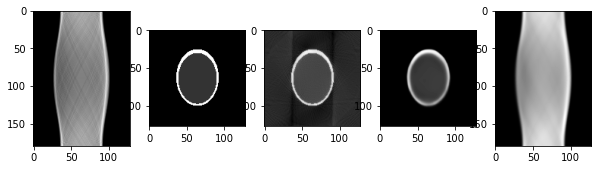

Epoch  418 ; Loss:  0.011165436


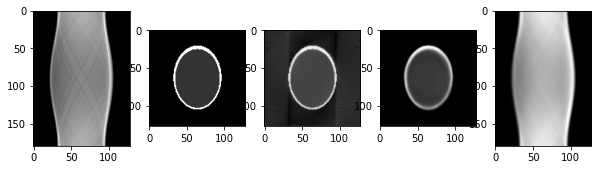

Epoch  419 ; Loss:  0.010664785


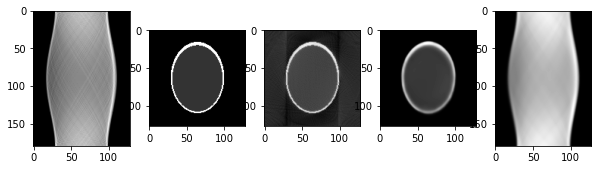

Epoch  420 ; Loss:  0.010491878


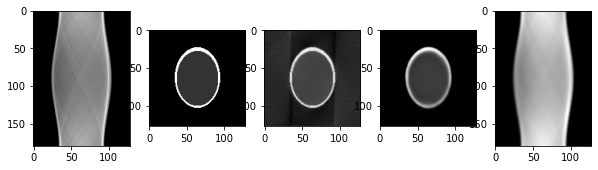

Epoch  421 ; Loss:  0.011371279


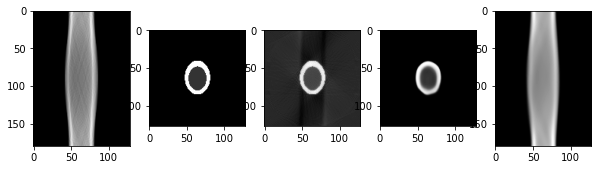

Epoch  422 ; Loss:  0.011018984


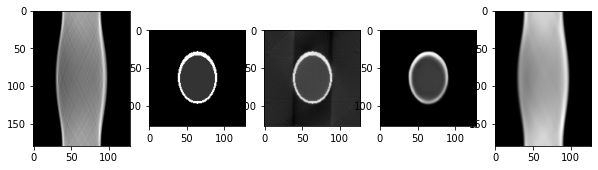

Epoch  423 ; Loss:  0.010428199


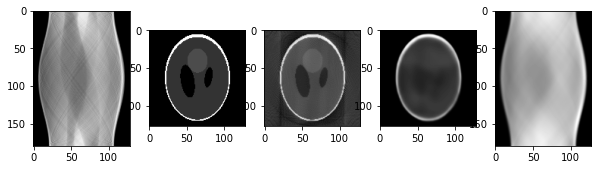

Epoch  424 ; Loss:  0.010467969


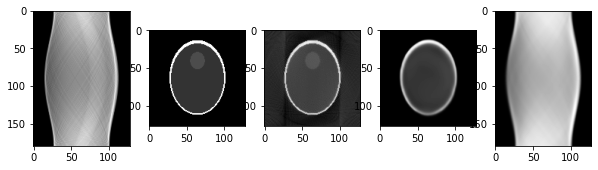

Epoch  425 ; Loss:  0.010619306


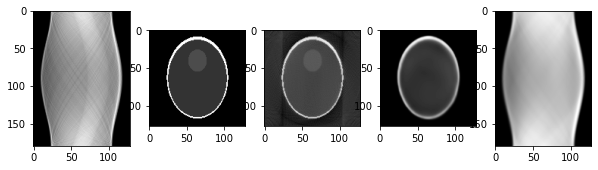

Epoch  426 ; Loss:  0.010366888


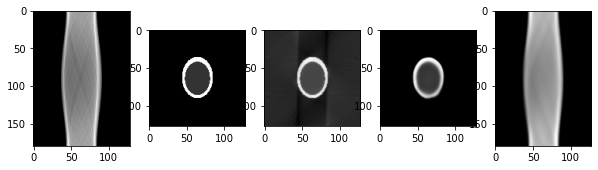

Epoch  427 ; Loss:  0.010382197


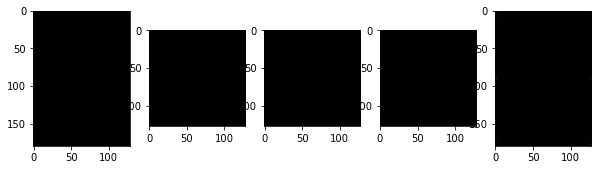

Epoch  428 ; Loss:  0.010337479


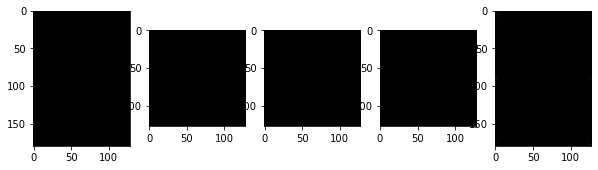

Epoch  429 ; Loss:  0.010502677


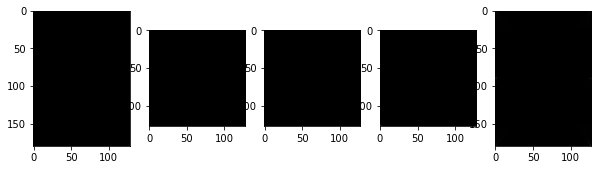

Epoch  430 ; Loss:  0.0108981095


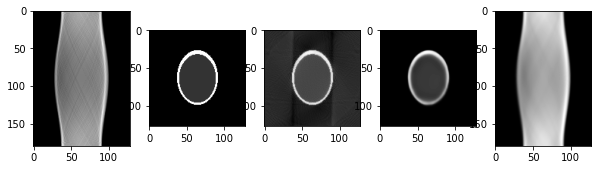

Epoch  431 ; Loss:  0.010626611


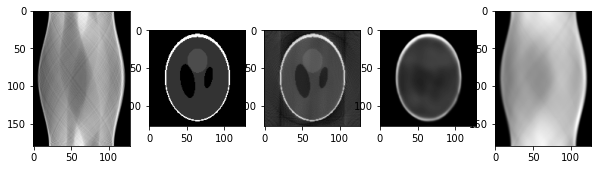

Epoch  432 ; Loss:  0.010798629


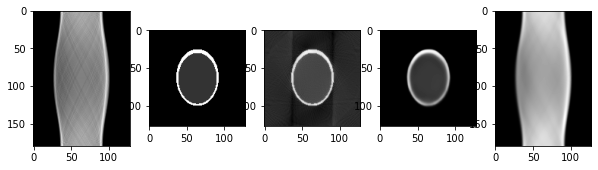

Epoch  433 ; Loss:  0.01099386


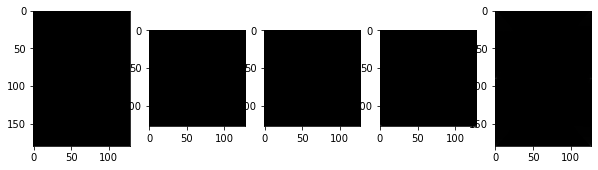

Epoch  434 ; Loss:  0.010629982


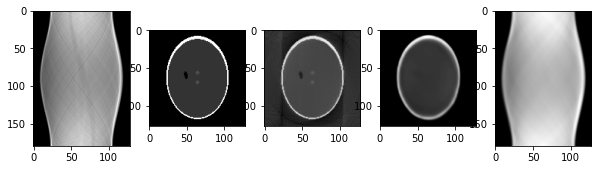

Epoch  435 ; Loss:  0.010560148


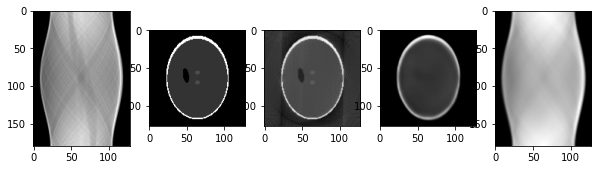

Epoch  436 ; Loss:  0.010332743


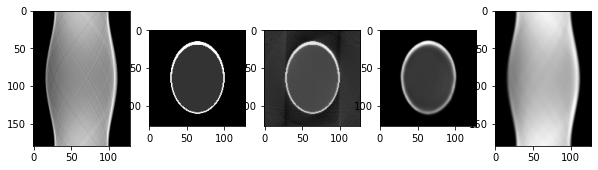

Epoch  437 ; Loss:  0.010631738


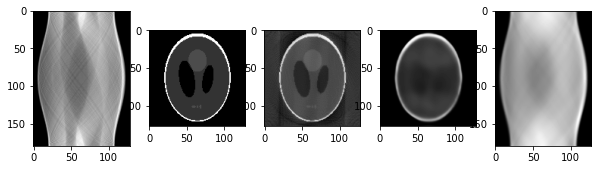

Epoch  438 ; Loss:  0.01042025


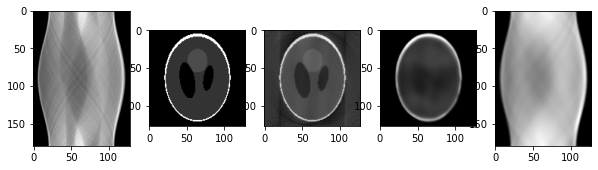

Epoch  439 ; Loss:  0.010175308


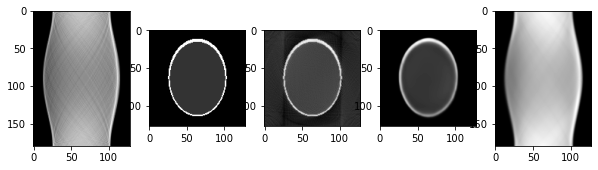

Epoch  440 ; Loss:  0.010143219


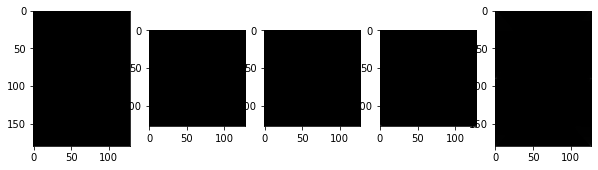

Epoch  441 ; Loss:  0.010648906


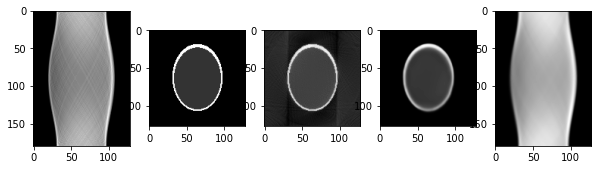

Epoch  442 ; Loss:  0.010273402


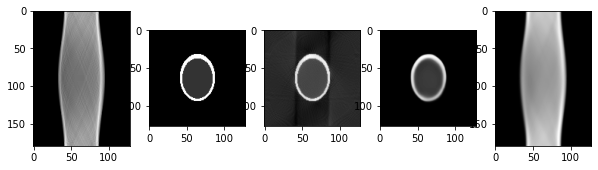

Epoch  443 ; Loss:  0.010335272


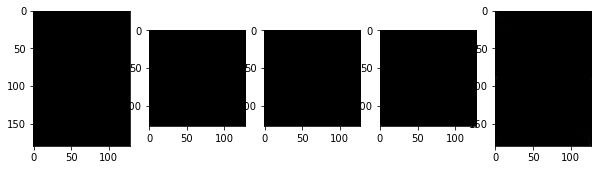

Epoch  444 ; Loss:  0.009977213


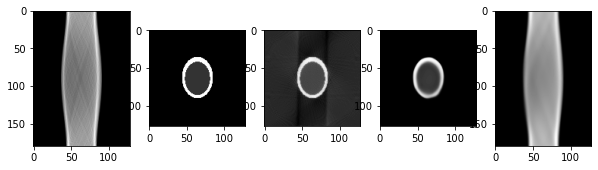

Epoch  445 ; Loss:  0.010038318


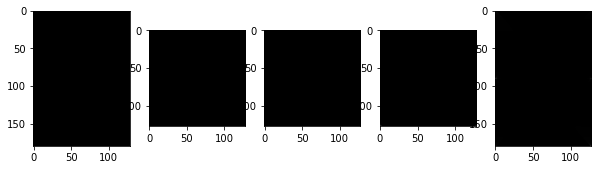

Epoch  446 ; Loss:  0.01008034


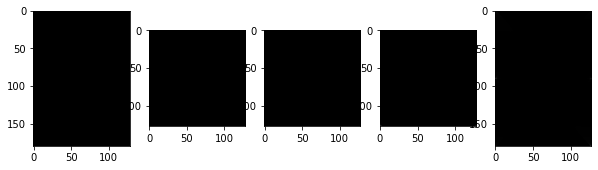

Epoch  447 ; Loss:  0.010131807


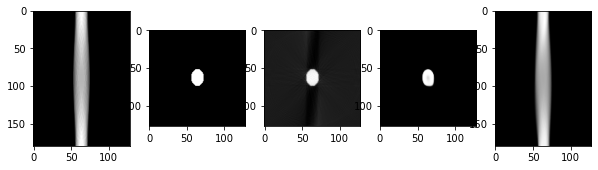

Epoch  448 ; Loss:  0.010048011


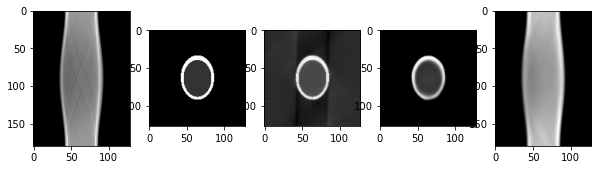

Epoch  449 ; Loss:  0.009911151


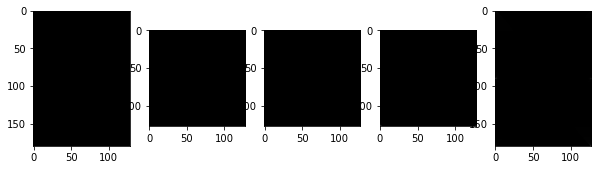

Epoch  450 ; Loss:  0.0100127915


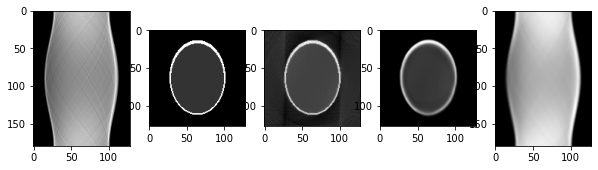

Epoch  451 ; Loss:  0.0100116385


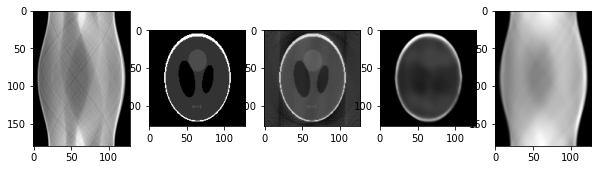

Epoch  452 ; Loss:  0.009944399


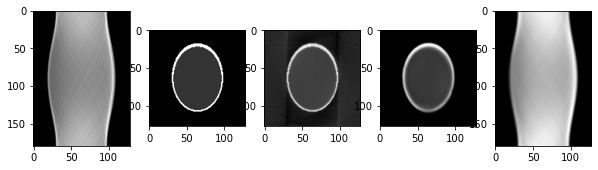

Epoch  453 ; Loss:  0.009977999


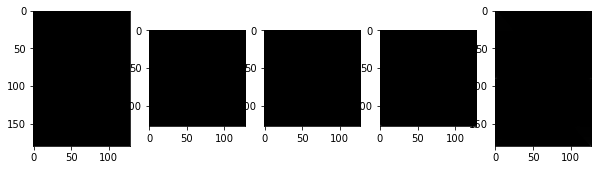

Epoch  454 ; Loss:  0.0102584455


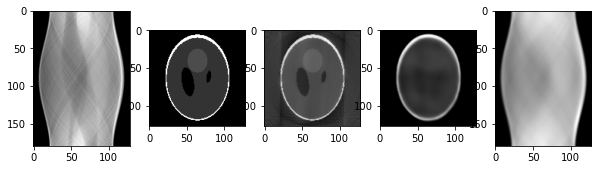

Epoch  455 ; Loss:  0.010561876


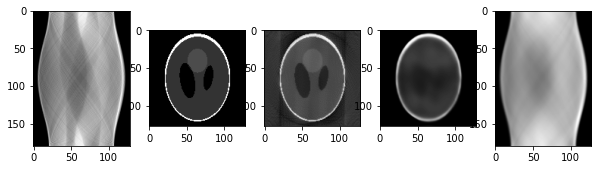

Epoch  456 ; Loss:  0.010091763


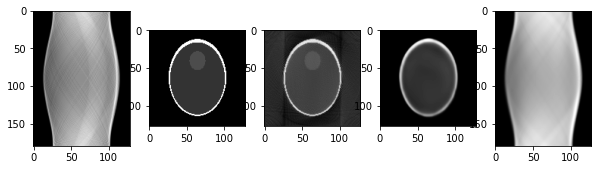

Epoch  457 ; Loss:  0.0098028835


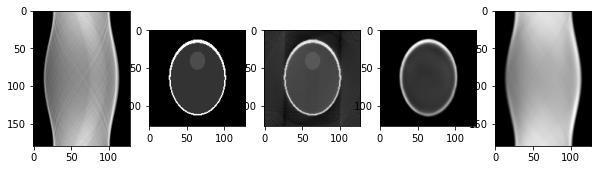

Epoch  458 ; Loss:  0.009816528


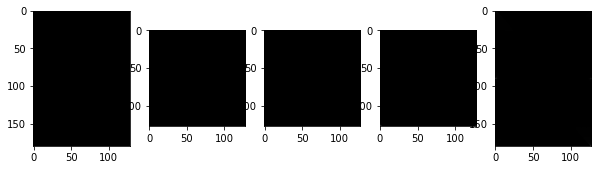

Epoch  459 ; Loss:  0.00971406


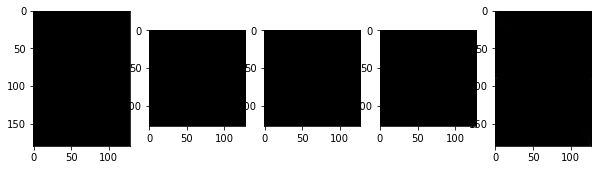

Epoch  460 ; Loss:  0.0098199705


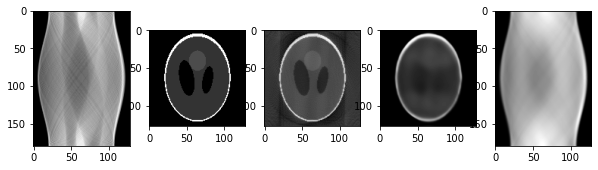

Epoch  461 ; Loss:  0.010159654


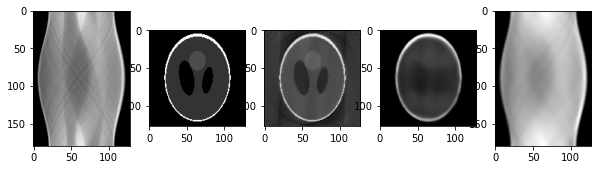

Epoch  462 ; Loss:  0.009733942


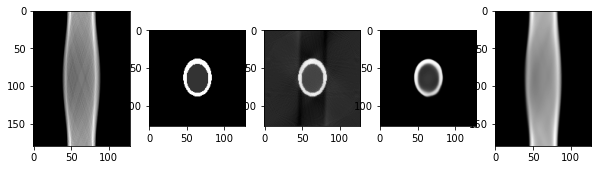

Epoch  463 ; Loss:  0.01009114


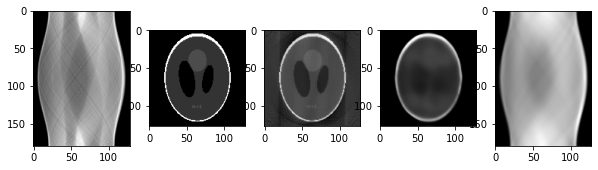

Epoch  464 ; Loss:  0.009835149


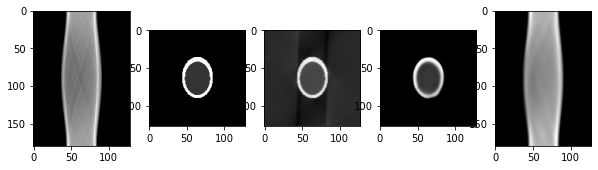

Epoch  465 ; Loss:  0.009906597


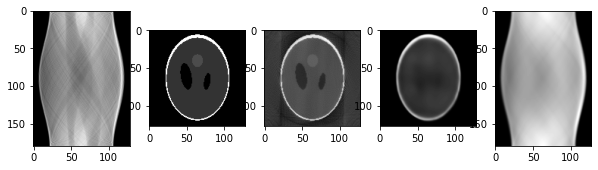

Epoch  466 ; Loss:  0.009954566


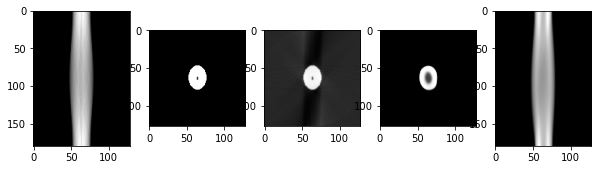

Epoch  467 ; Loss:  0.00983105


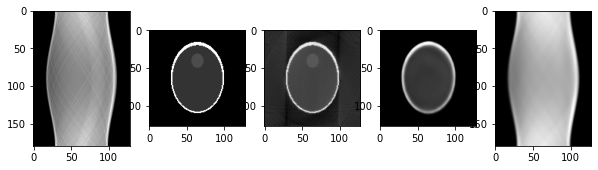

Epoch  468 ; Loss:  0.010135761


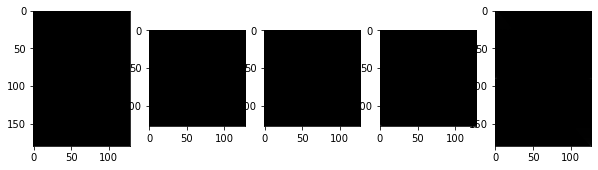

Epoch  469 ; Loss:  0.009722542


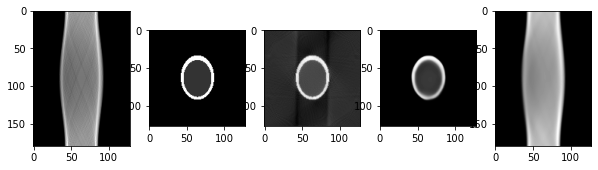

Epoch  470 ; Loss:  0.009571566


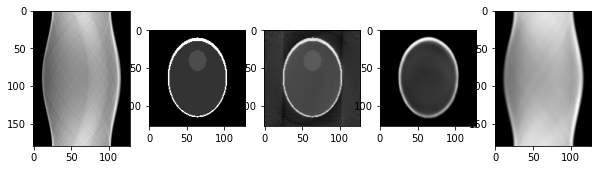

Epoch  471 ; Loss:  0.009842402


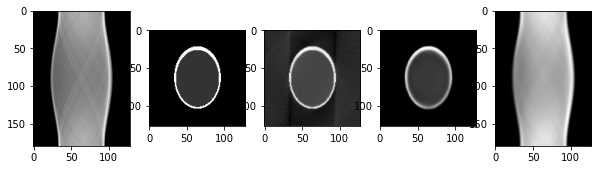

Epoch  472 ; Loss:  0.009636567


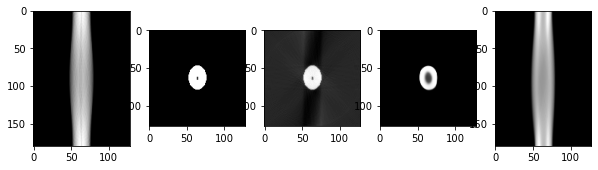

Epoch  473 ; Loss:  0.009855896


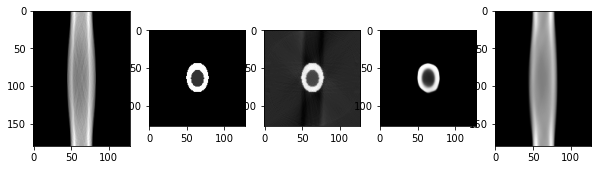

Epoch  474 ; Loss:  0.009612406


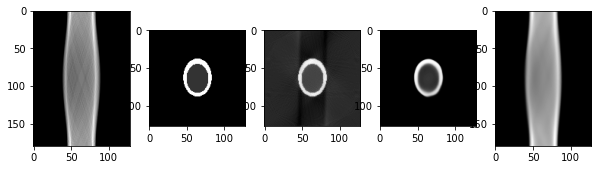

Epoch  475 ; Loss:  0.009640212


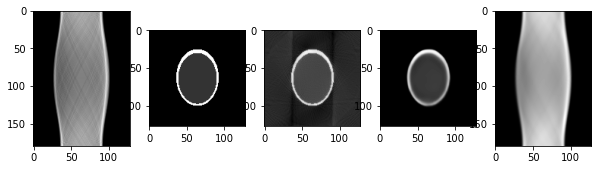

Epoch  476 ; Loss:  0.00948687


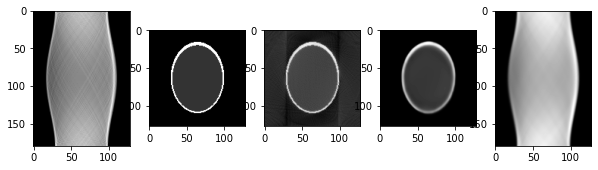

Epoch  477 ; Loss:  0.009509454


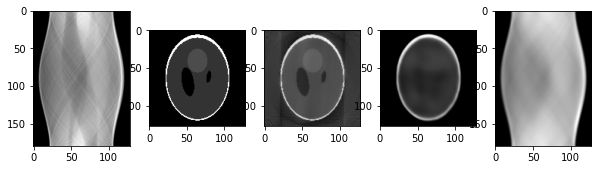

Epoch  478 ; Loss:  0.009576528


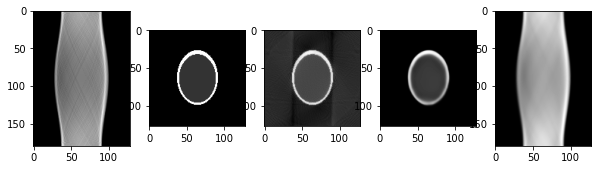

Epoch  479 ; Loss:  0.009759929


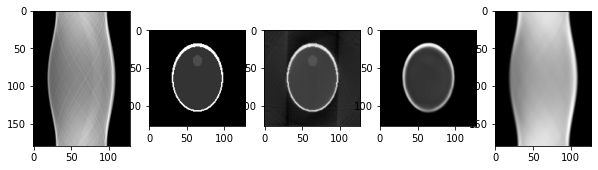

Epoch  480 ; Loss:  0.009639861


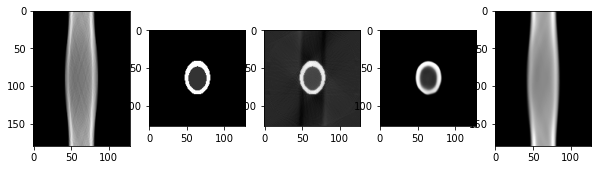

Epoch  481 ; Loss:  0.009495372


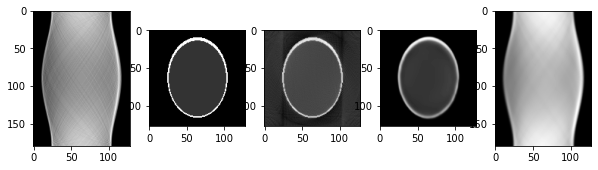

Epoch  482 ; Loss:  0.009466885


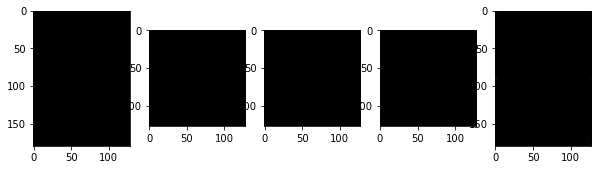

Epoch  483 ; Loss:  0.009490406


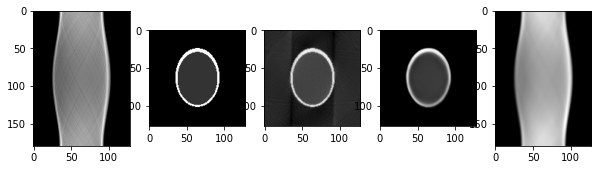

Epoch  484 ; Loss:  0.0095788585


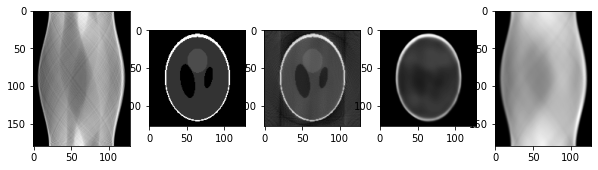

Epoch  485 ; Loss:  0.0098792175


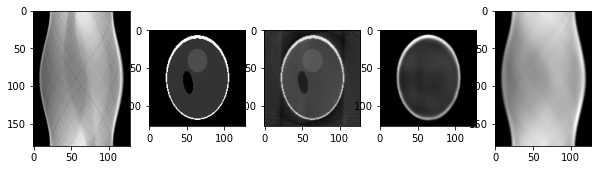

Epoch  486 ; Loss:  0.009349915


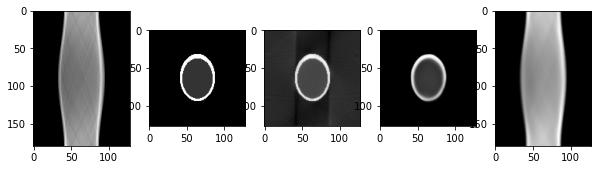

Epoch  487 ; Loss:  0.0094156405


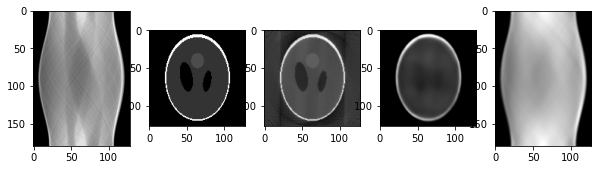

Epoch  488 ; Loss:  0.0095919855


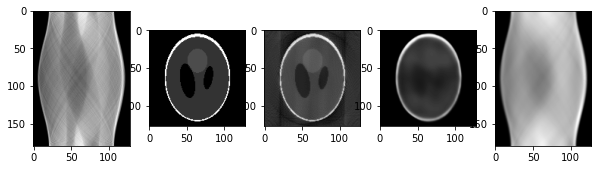

Epoch  489 ; Loss:  0.009266166


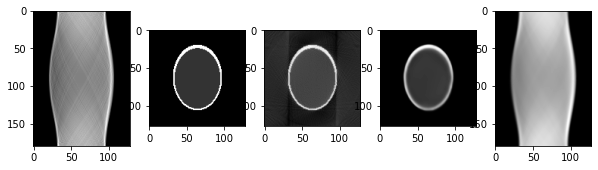

Epoch  490 ; Loss:  0.009395614


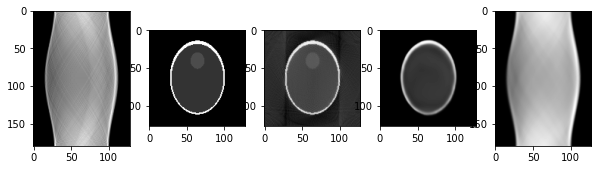

Epoch  491 ; Loss:  0.009450377


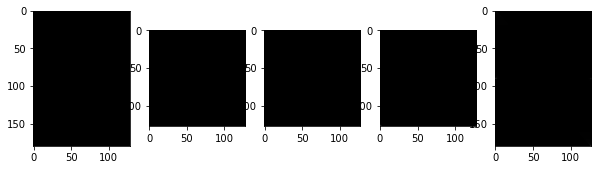

Epoch  492 ; Loss:  0.009565098


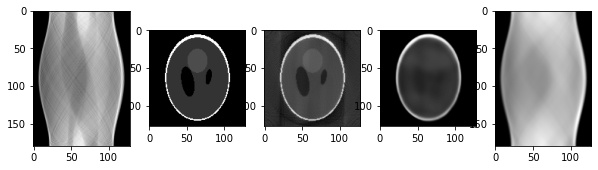

Epoch  493 ; Loss:  0.009391918


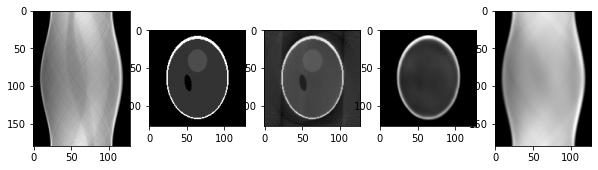

Epoch  494 ; Loss:  0.009274565


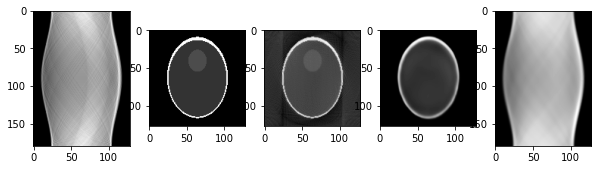

Epoch  495 ; Loss:  0.009284125


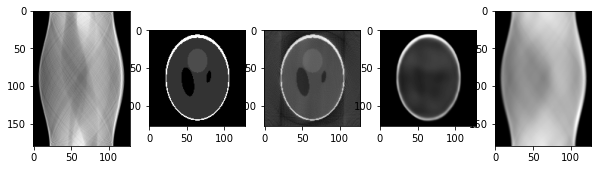

Epoch  496 ; Loss:  0.009354549


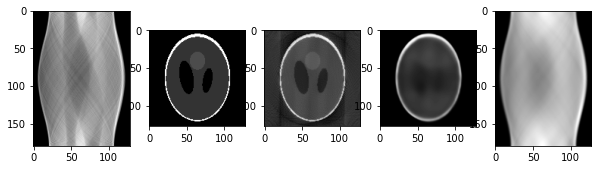

Epoch  497 ; Loss:  0.009954359


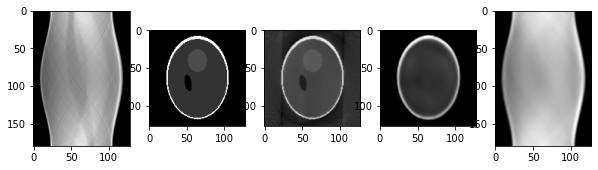

Epoch  498 ; Loss:  0.009614659


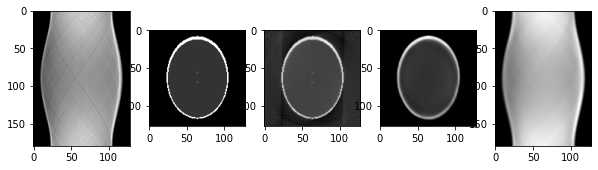

Epoch  499 ; Loss:  0.009472328


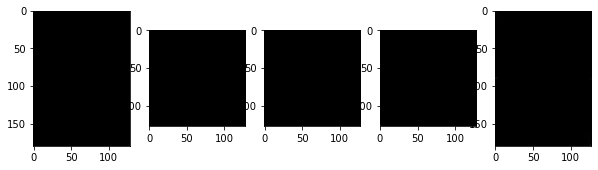

Epoch  500 ; Loss:  0.009281643


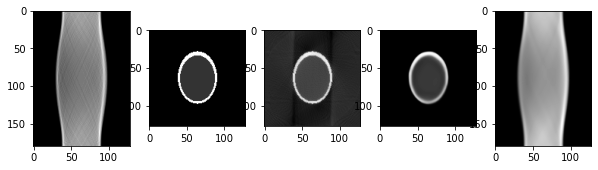

Epoch  501 ; Loss:  0.009321935


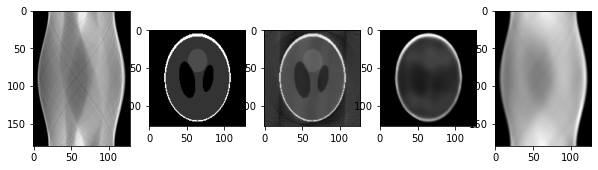

Epoch  502 ; Loss:  0.009753911


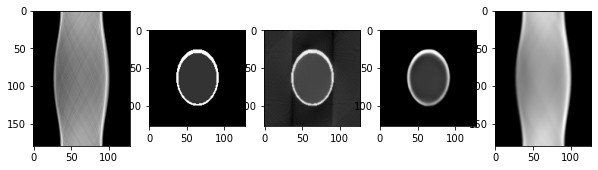

Epoch  503 ; Loss:  0.009321469


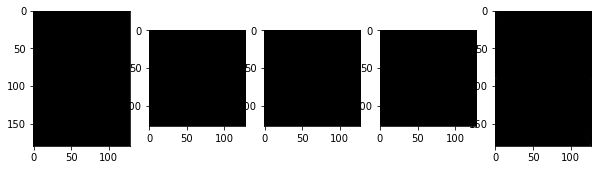

Epoch  504 ; Loss:  0.009276795


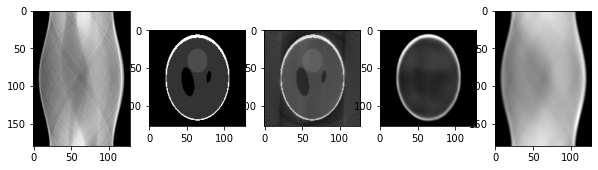

Epoch  505 ; Loss:  0.00916466


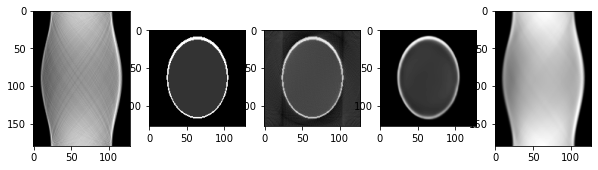

Epoch  506 ; Loss:  0.009359434


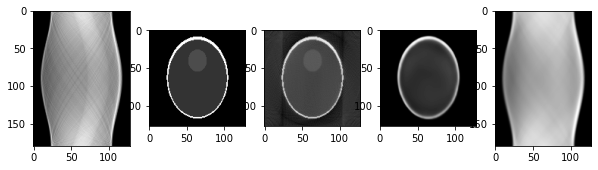

Epoch  507 ; Loss:  0.009133243


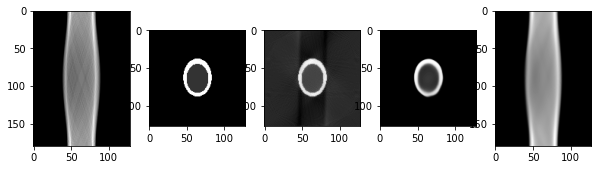

Epoch  508 ; Loss:  0.009159325


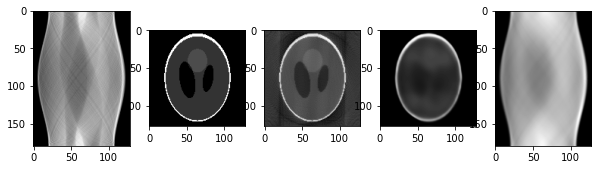

Epoch  509 ; Loss:  0.009127613


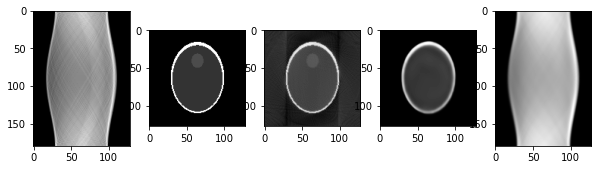

Epoch  510 ; Loss:  0.010042006


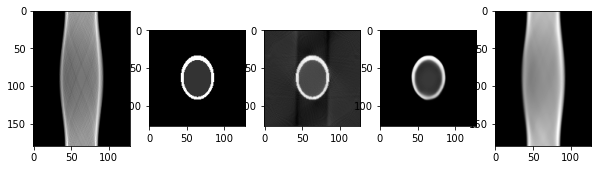

Epoch  511 ; Loss:  0.0093252305


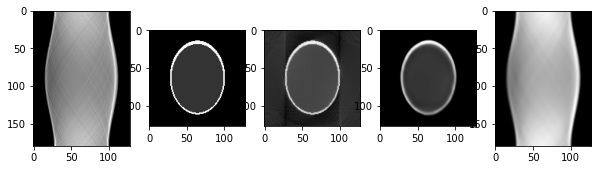

Epoch  512 ; Loss:  0.009429411


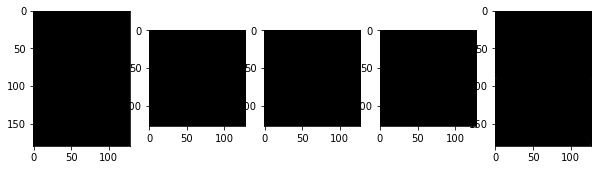

Epoch  513 ; Loss:  0.00902894


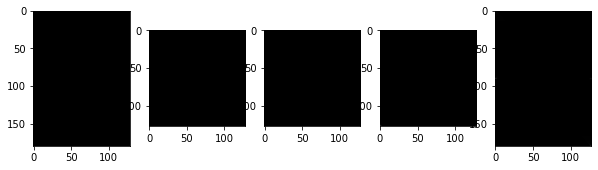

Epoch  514 ; Loss:  0.009218338


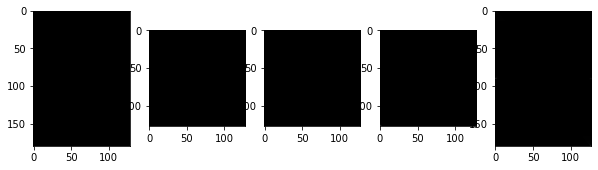

Epoch  515 ; Loss:  0.009086752


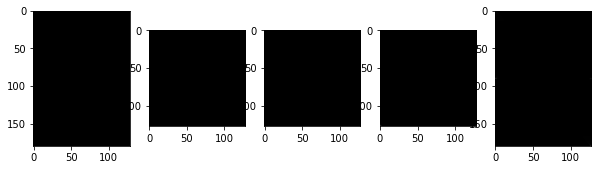

Epoch  516 ; Loss:  0.009197015


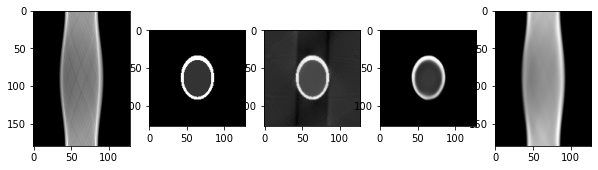

Epoch  517 ; Loss:  0.009100842


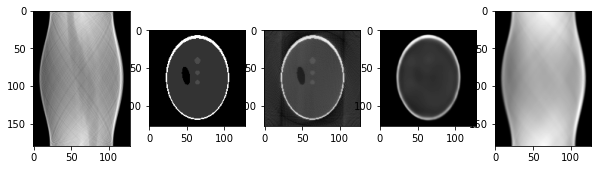

Epoch  518 ; Loss:  0.009163467


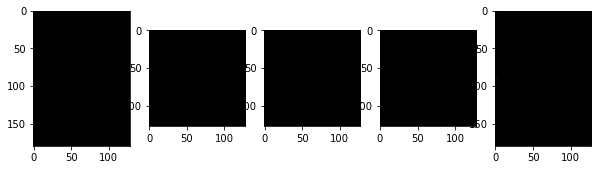

Epoch  519 ; Loss:  0.00902198


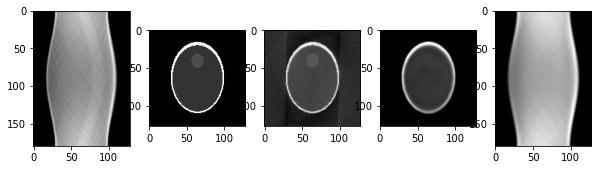

Epoch  520 ; Loss:  0.0092664445


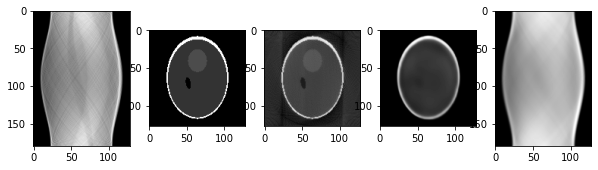

Epoch  521 ; Loss:  0.008994937


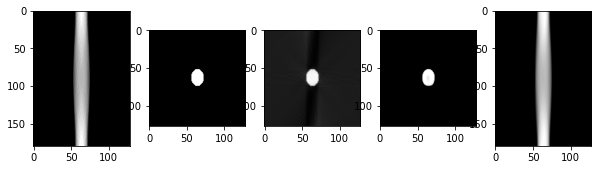

Epoch  522 ; Loss:  0.008976823


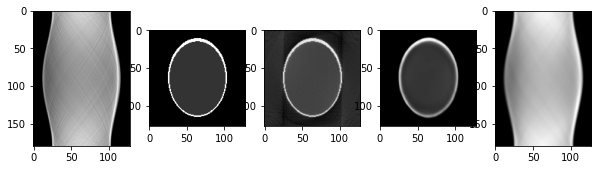

Epoch  523 ; Loss:  0.009001591


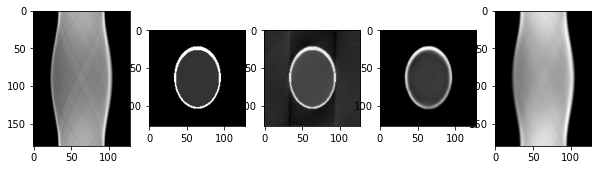

Epoch  524 ; Loss:  0.00904769


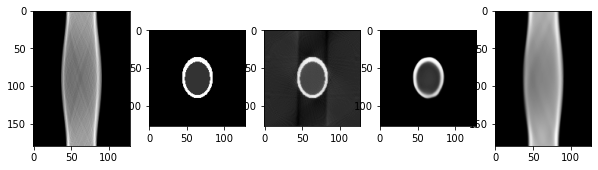

Epoch  525 ; Loss:  0.008999664


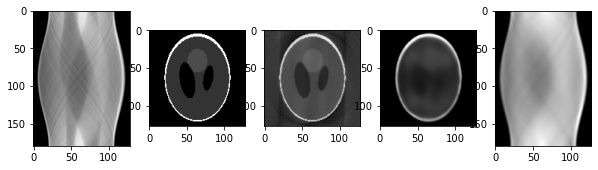

Epoch  526 ; Loss:  0.009059319


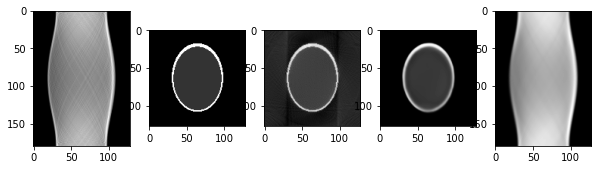

Epoch  527 ; Loss:  0.009160375


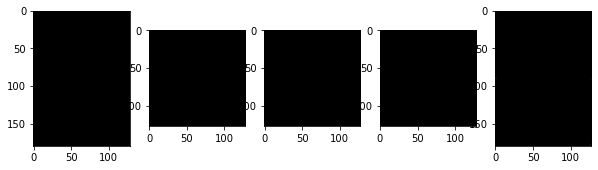

Epoch  528 ; Loss:  0.0090810275


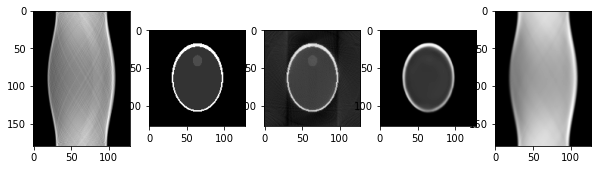

Epoch  529 ; Loss:  0.008926244


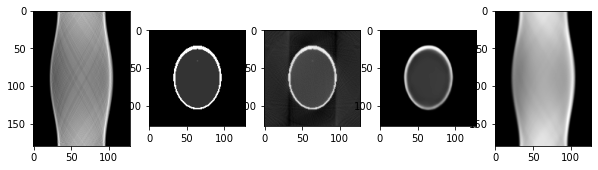

Epoch  530 ; Loss:  0.008857195


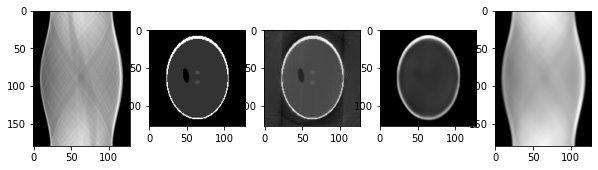

Epoch  531 ; Loss:  0.009110964


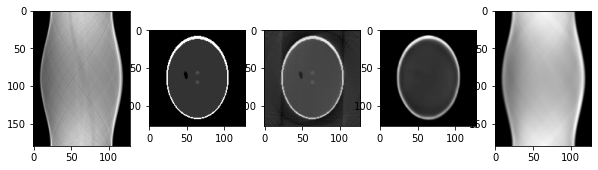

Epoch  532 ; Loss:  0.0091533065


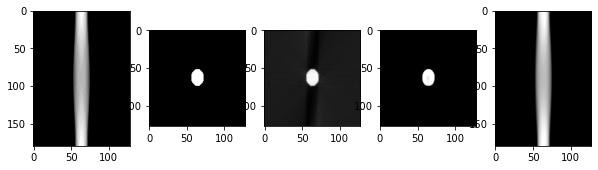

Epoch  533 ; Loss:  0.009272402


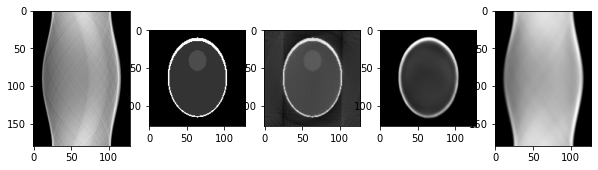

Epoch  534 ; Loss:  0.008972003


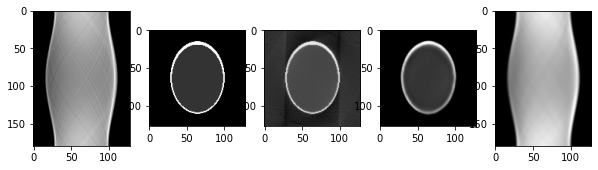

Epoch  535 ; Loss:  0.009000043


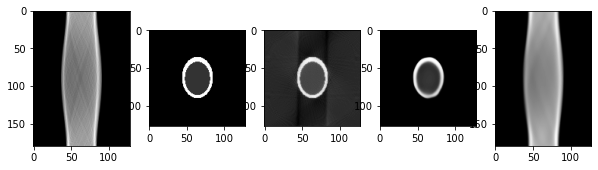

Epoch  536 ; Loss:  0.009152674


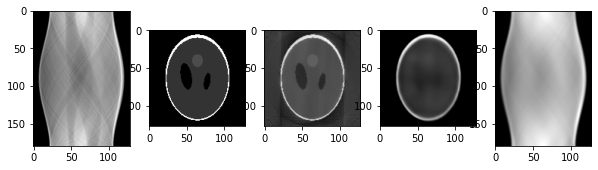

Epoch  537 ; Loss:  0.008854152


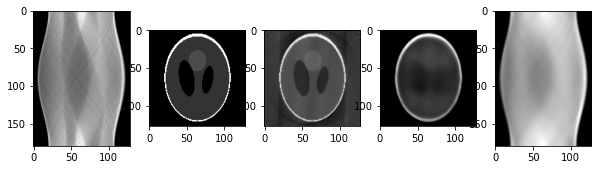

Epoch  538 ; Loss:  0.009078718


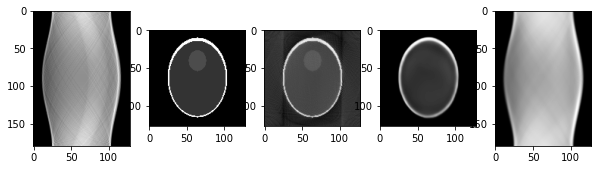

Epoch  539 ; Loss:  0.008924652


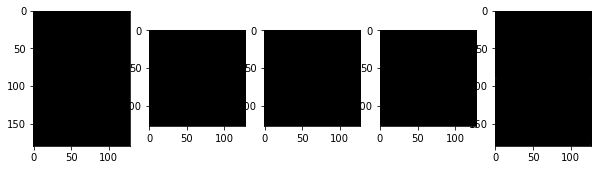

Epoch  540 ; Loss:  0.008824062


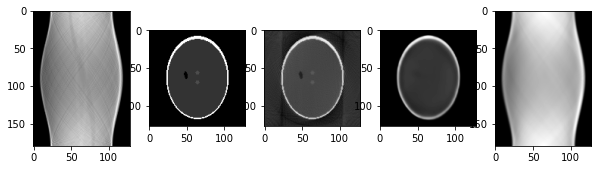

Epoch  541 ; Loss:  0.009271189


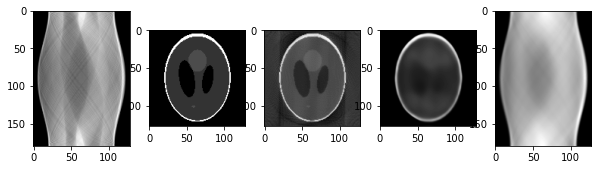

Epoch  542 ; Loss:  0.008928913


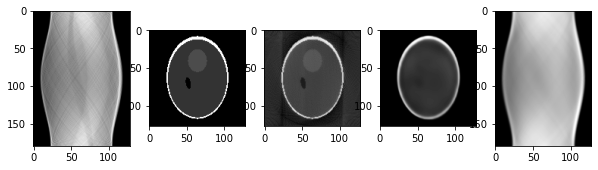

Epoch  543 ; Loss:  0.008746182


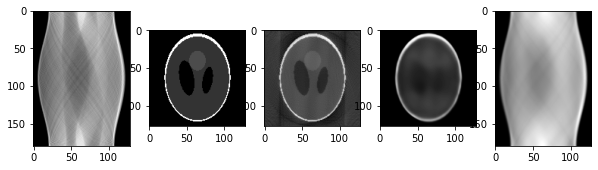

Epoch  544 ; Loss:  0.008781276


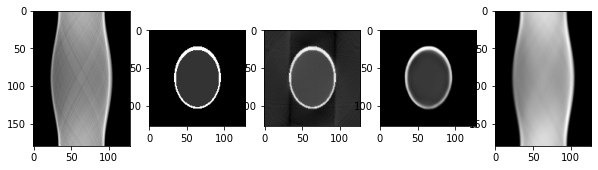

Epoch  545 ; Loss:  0.009282438


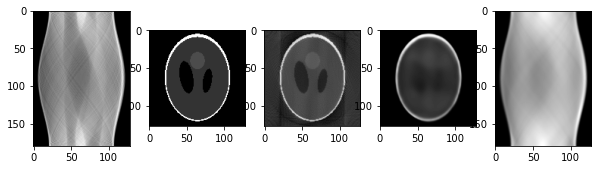

Epoch  546 ; Loss:  0.008815878


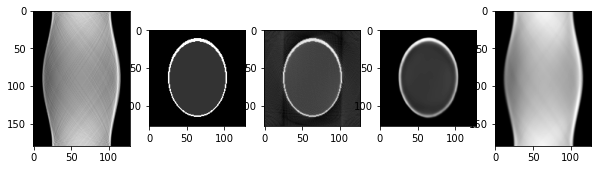

Epoch  547 ; Loss:  0.009087853


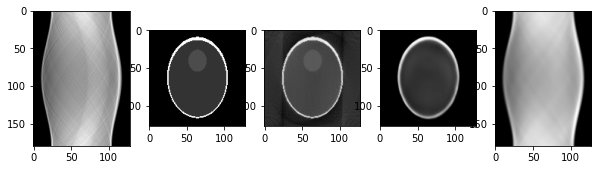

Epoch  548 ; Loss:  0.00880515


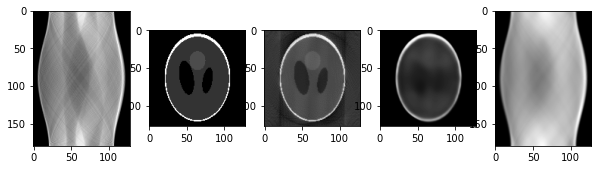

Epoch  549 ; Loss:  0.008859486


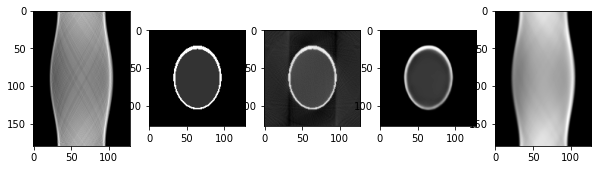

Epoch  550 ; Loss:  0.008693554


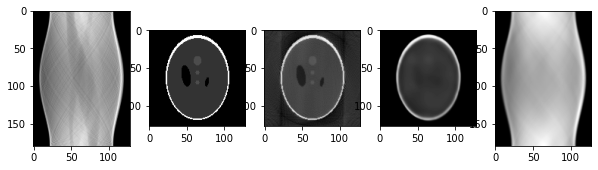

Epoch  551 ; Loss:  0.008964722


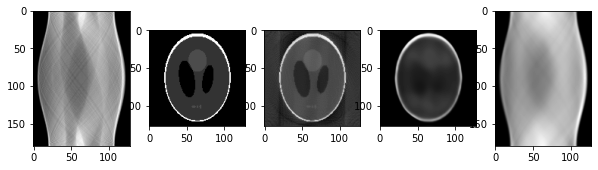

Epoch  552 ; Loss:  0.008866108


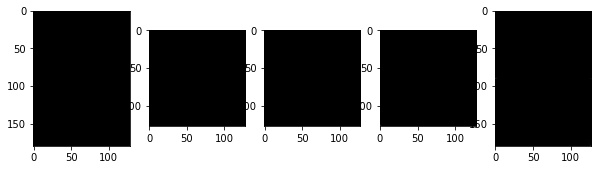

Epoch  553 ; Loss:  0.008764529


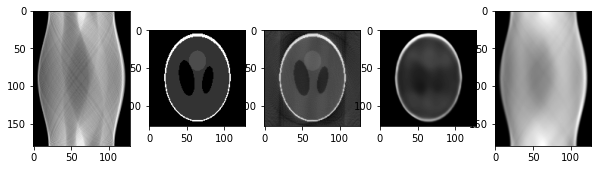

Epoch  554 ; Loss:  0.008585142


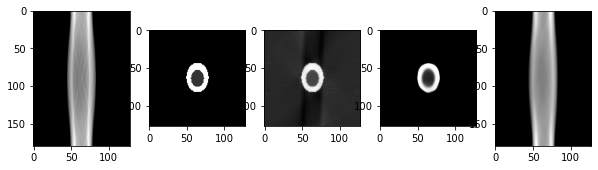

Epoch  555 ; Loss:  0.008721599


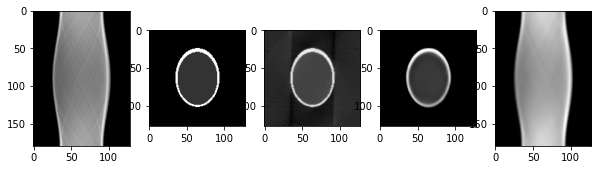

Epoch  556 ; Loss:  0.00895807


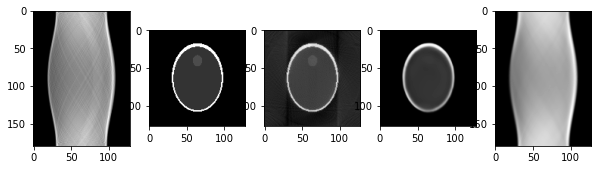

Epoch  557 ; Loss:  0.0088070035


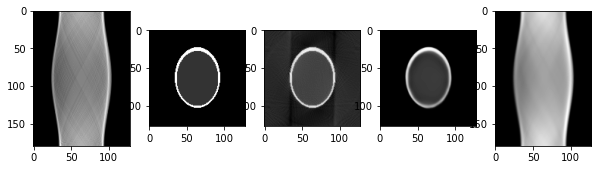

Epoch  558 ; Loss:  0.008656642


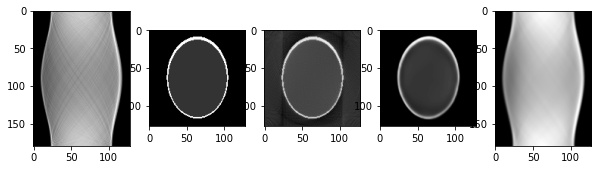

Epoch  559 ; Loss:  0.0089093605


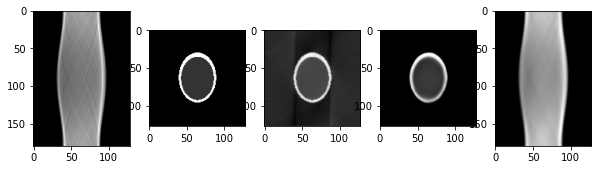

Epoch  560 ; Loss:  0.009033148


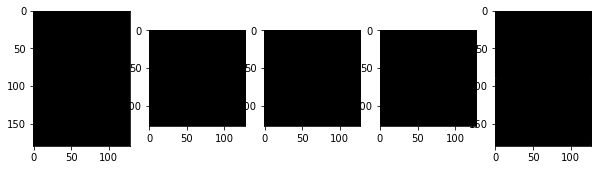

Epoch  561 ; Loss:  0.009250147


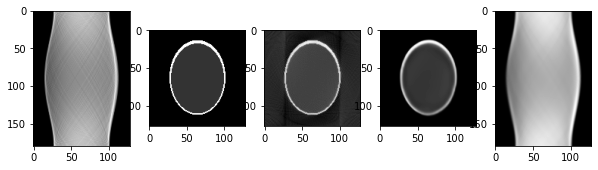

Epoch  562 ; Loss:  0.008666268


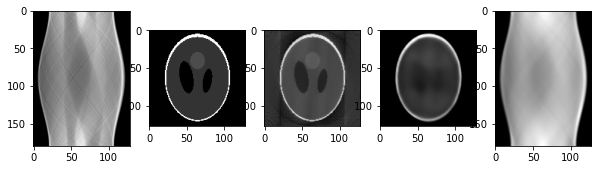

Epoch  563 ; Loss:  0.008607033


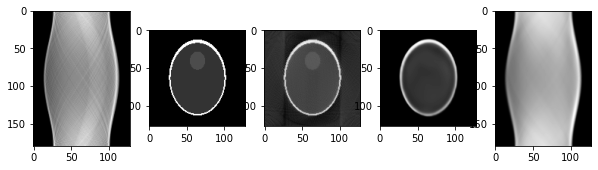

Epoch  564 ; Loss:  0.008743307


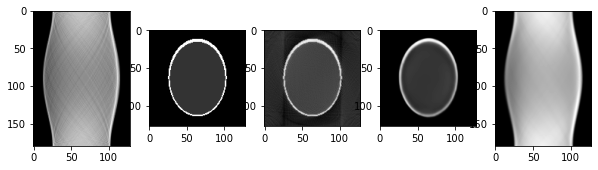

Epoch  565 ; Loss:  0.008519075


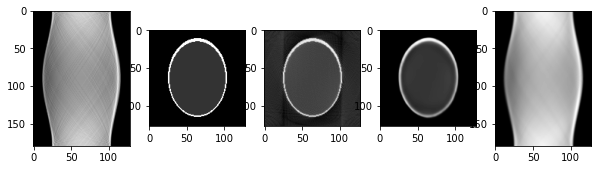

Epoch  566 ; Loss:  0.008564254


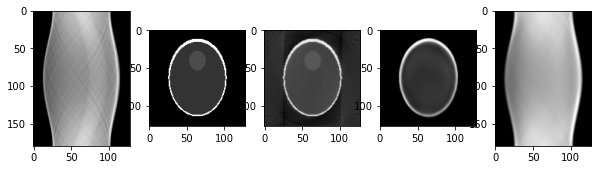

Epoch  567 ; Loss:  0.008681238


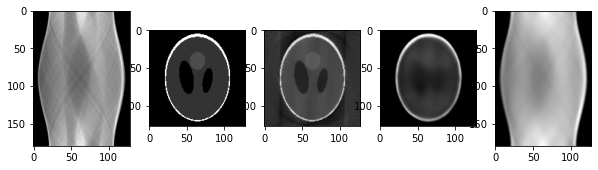

Epoch  568 ; Loss:  0.008699238


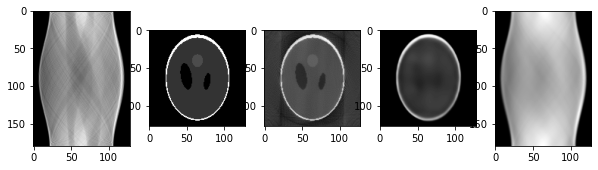

Epoch  569 ; Loss:  0.0085903285


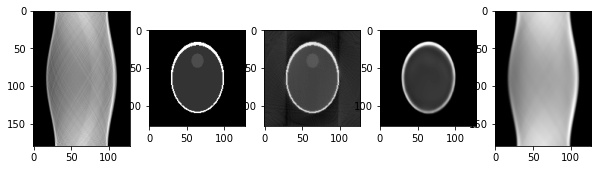

Epoch  570 ; Loss:  0.008563259


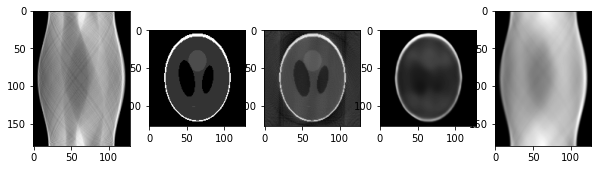

Epoch  571 ; Loss:  0.00849437


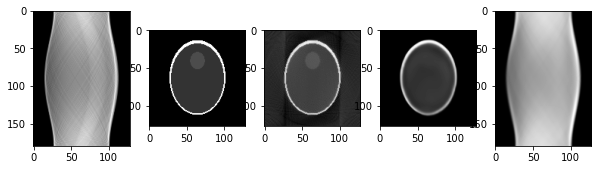

Epoch  572 ; Loss:  0.008538158


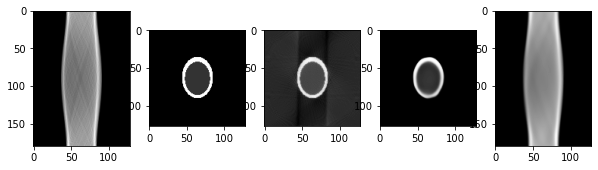

Epoch  573 ; Loss:  0.008823037


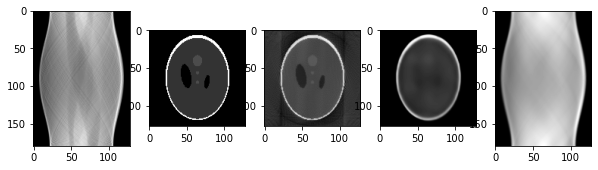

Epoch  574 ; Loss:  0.008583484


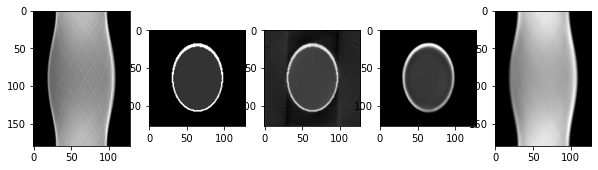

Epoch  575 ; Loss:  0.00875878


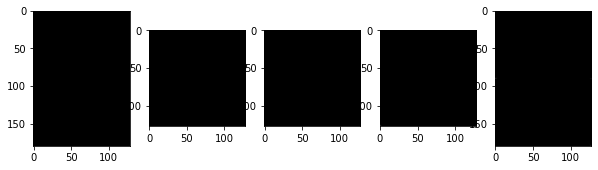

Epoch  576 ; Loss:  0.008446596


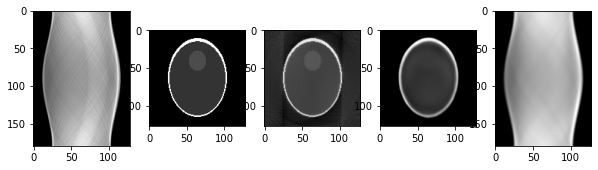

Epoch  577 ; Loss:  0.008883682


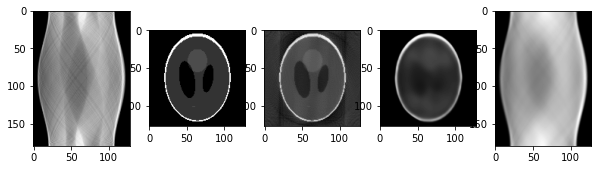

Epoch  578 ; Loss:  0.008699996


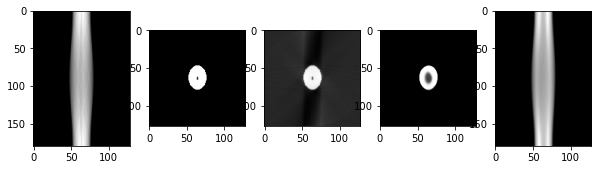

Epoch  579 ; Loss:  0.008798532


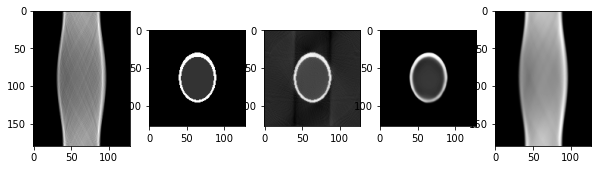

Epoch  580 ; Loss:  0.00855269


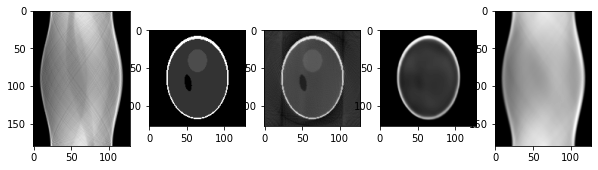

Epoch  581 ; Loss:  0.00853406


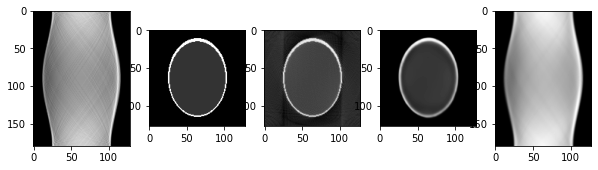

Epoch  582 ; Loss:  0.008595954


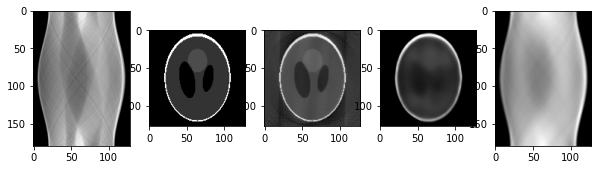

Epoch  583 ; Loss:  0.009004394


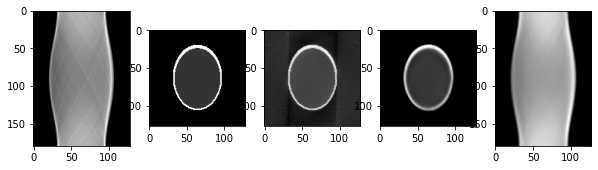

Epoch  584 ; Loss:  0.008572854


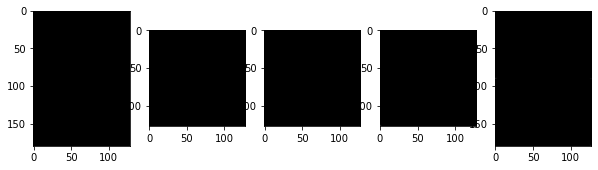

Epoch  585 ; Loss:  0.008432509


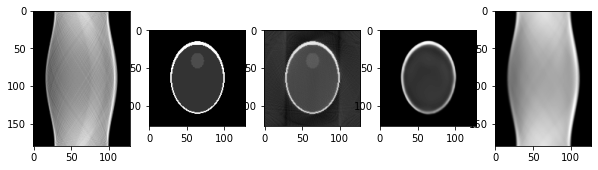

Epoch  586 ; Loss:  0.008430583


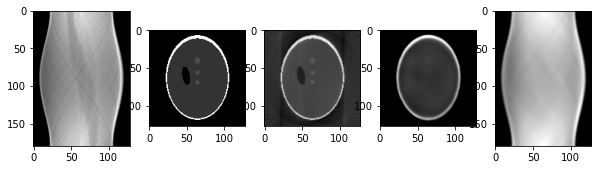

Epoch  587 ; Loss:  0.009022201


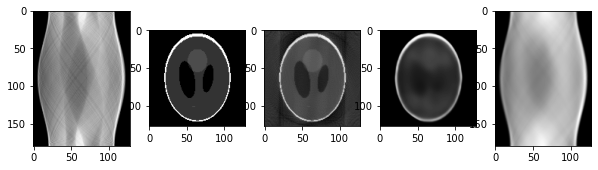

Epoch  588 ; Loss:  0.008588885


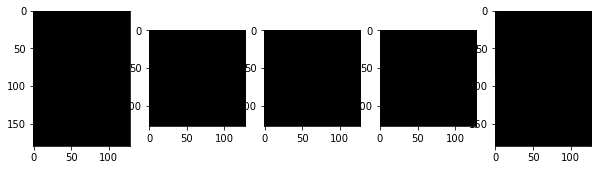

Epoch  589 ; Loss:  0.008770045


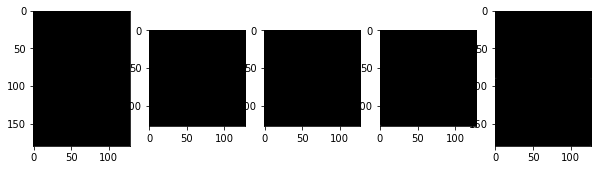

Epoch  590 ; Loss:  0.009087994


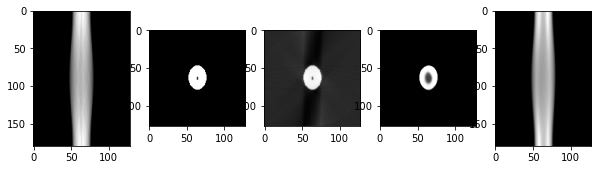

Epoch  591 ; Loss:  0.008421828


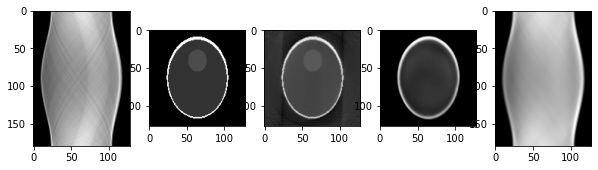

Epoch  592 ; Loss:  0.008457562


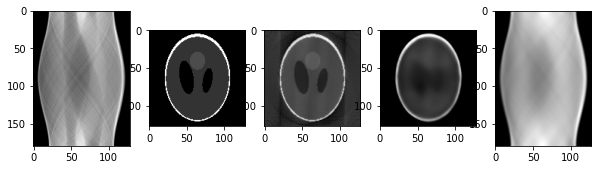

Epoch  593 ; Loss:  0.008482356


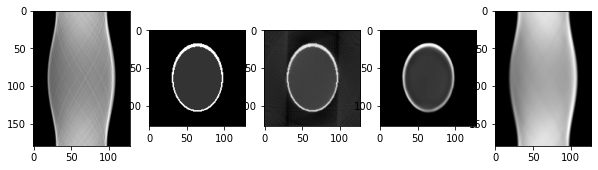

Epoch  594 ; Loss:  0.008311787


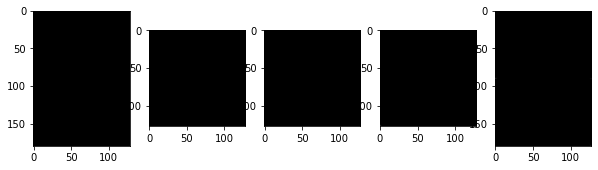

Epoch  595 ; Loss:  0.008416397


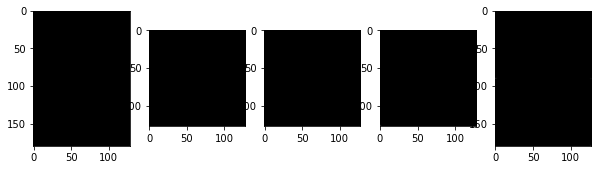

Epoch  596 ; Loss:  0.00838823


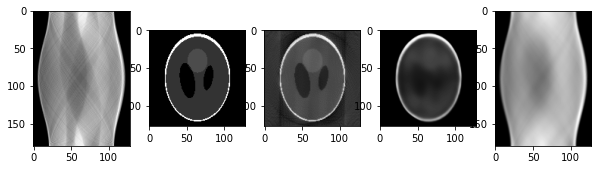

Epoch  597 ; Loss:  0.008575926


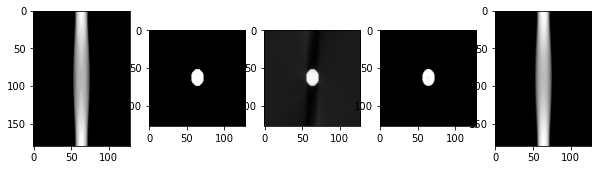

Epoch  598 ; Loss:  0.008307879


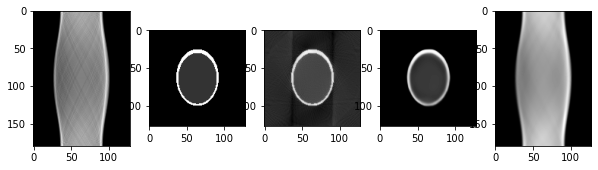

Epoch  599 ; Loss:  0.008647371


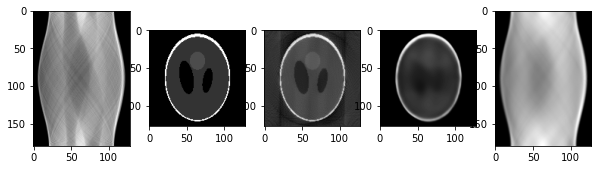

Epoch  600 ; Loss:  0.008315011


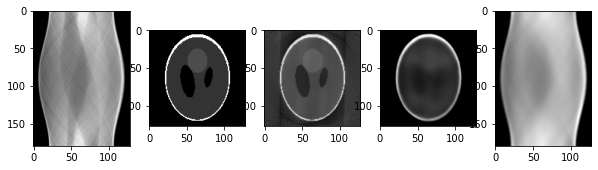

Epoch  601 ; Loss:  0.008491943


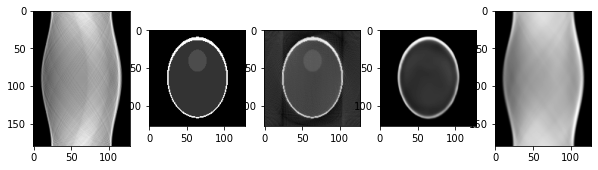

Epoch  602 ; Loss:  0.0086504975


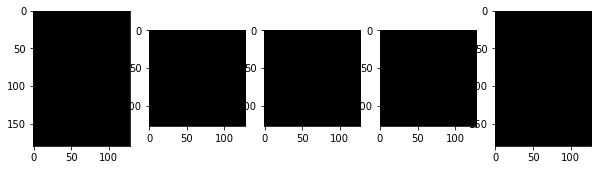

Epoch  603 ; Loss:  0.008316427


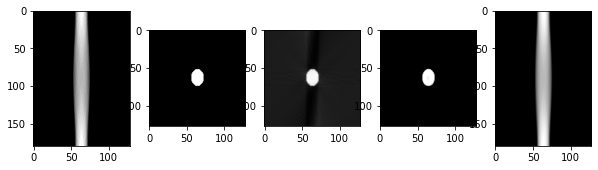

Epoch  604 ; Loss:  0.008242801


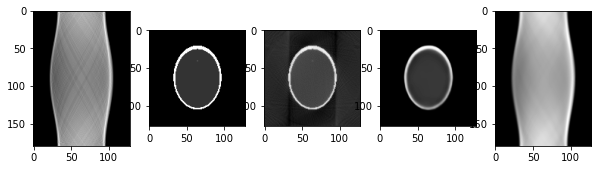

Epoch  605 ; Loss:  0.008947666


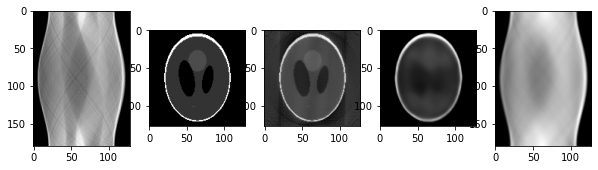

Epoch  606 ; Loss:  0.008296558


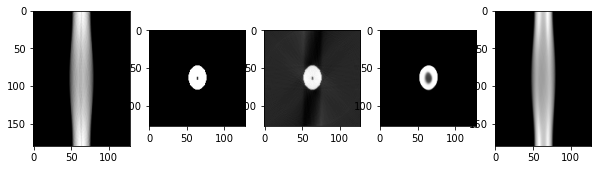

Epoch  607 ; Loss:  0.008319137


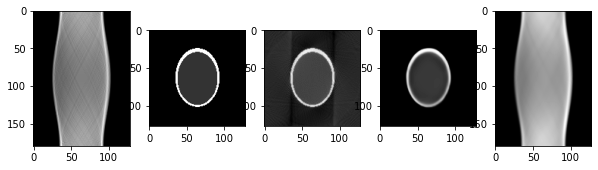

Epoch  608 ; Loss:  0.008320067


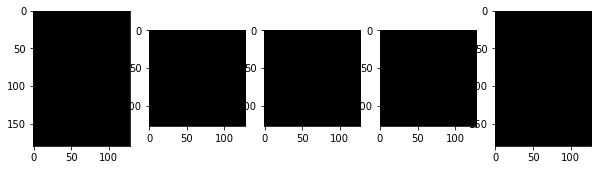

Epoch  609 ; Loss:  0.008393867


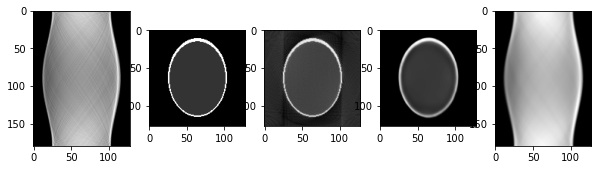

Epoch  610 ; Loss:  0.008428148


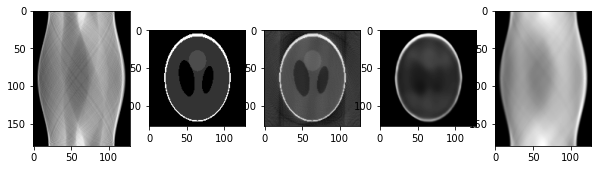

Epoch  611 ; Loss:  0.008354498


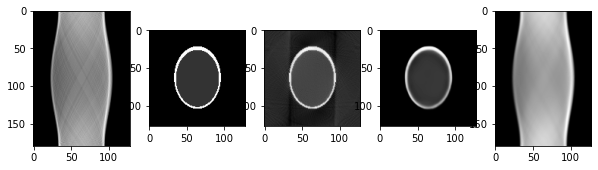

Epoch  612 ; Loss:  0.008279151


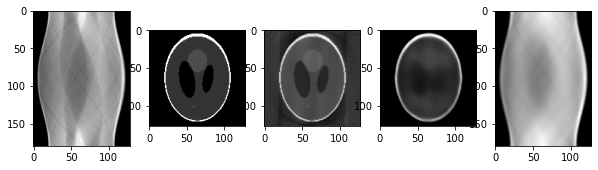

Epoch  613 ; Loss:  0.008227898


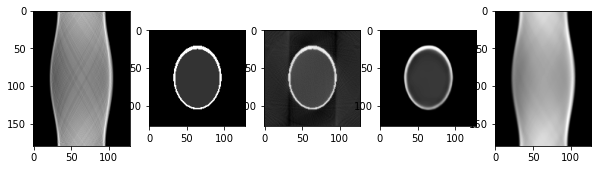

Epoch  614 ; Loss:  0.008814038


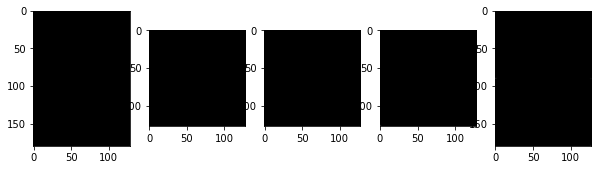

Epoch  615 ; Loss:  0.008402623


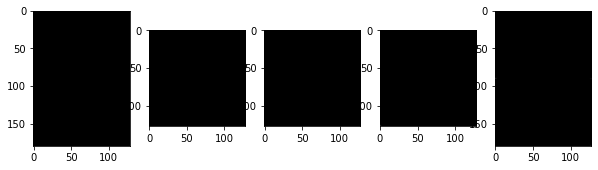

Epoch  616 ; Loss:  0.008788478


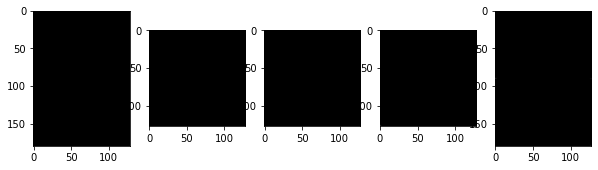

Epoch  617 ; Loss:  0.008453543


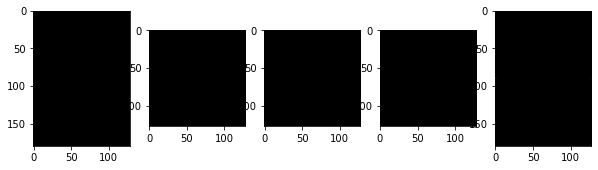

Epoch  618 ; Loss:  0.008371574


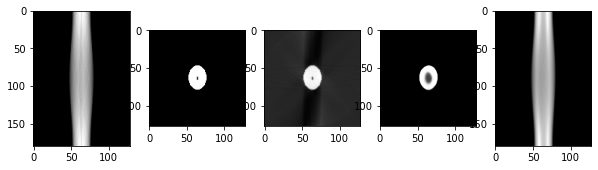

Epoch  619 ; Loss:  0.008273349


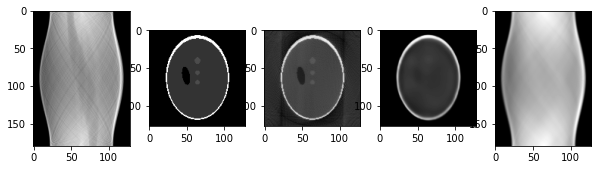

Epoch  620 ; Loss:  0.008547165


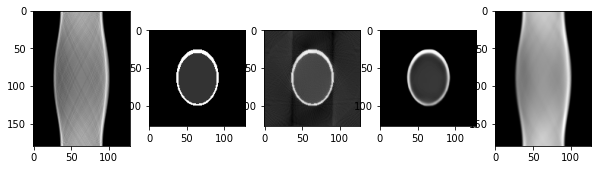

Epoch  621 ; Loss:  0.00826292


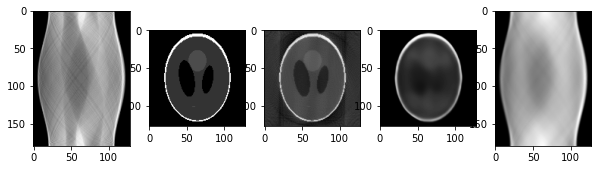

Epoch  622 ; Loss:  0.008187566


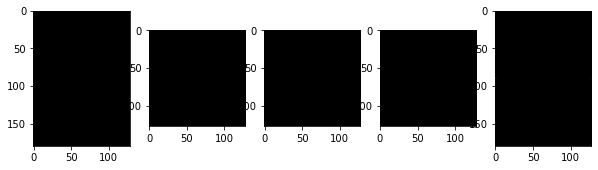

Epoch  623 ; Loss:  0.008671417


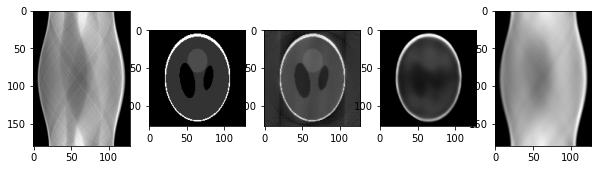

Epoch  624 ; Loss:  0.0082323365


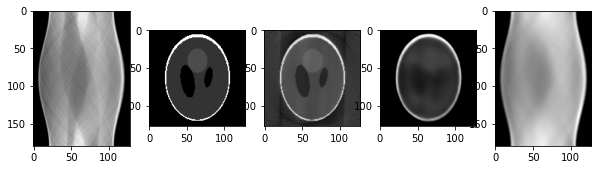

Epoch  625 ; Loss:  0.008252466


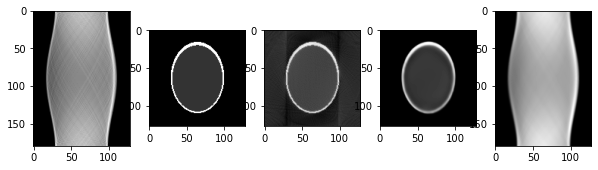

Epoch  626 ; Loss:  0.008259018


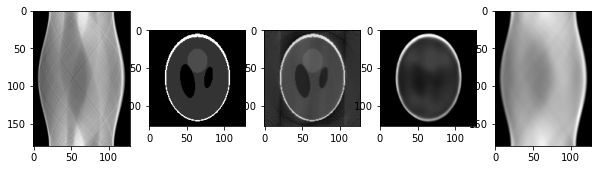

Epoch  627 ; Loss:  0.008316604


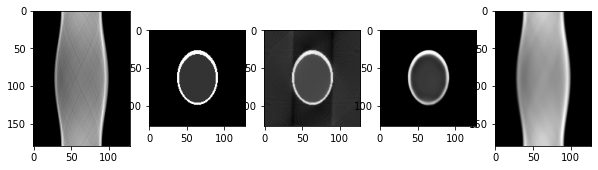

Epoch  628 ; Loss:  0.008204223


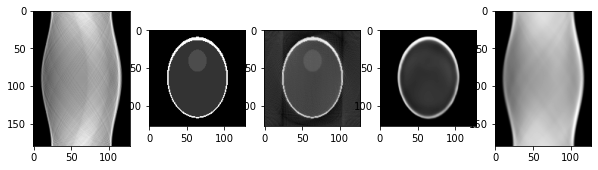

Epoch  629 ; Loss:  0.008148324


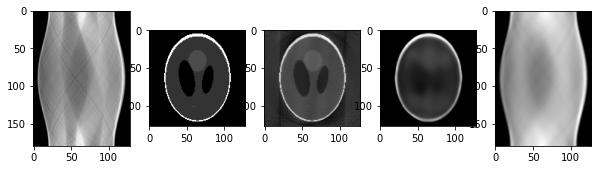

Epoch  630 ; Loss:  0.008163932


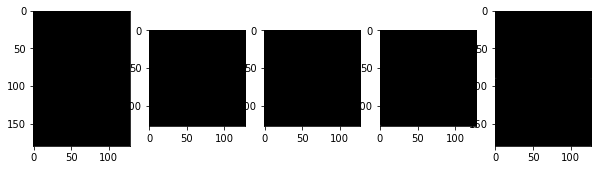

Epoch  631 ; Loss:  0.008174539


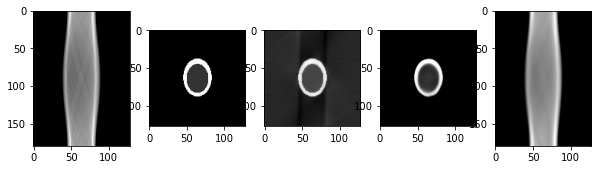

Epoch  632 ; Loss:  0.008903488


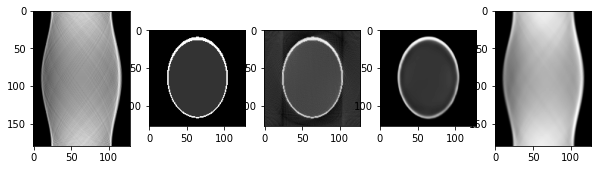

Epoch  633 ; Loss:  0.008918873


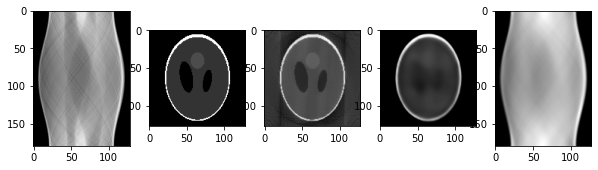

Epoch  634 ; Loss:  0.008313499


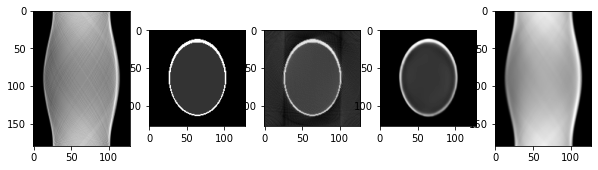

Epoch  635 ; Loss:  0.008231644


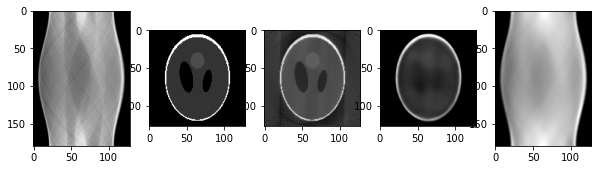

Epoch  636 ; Loss:  0.008172418


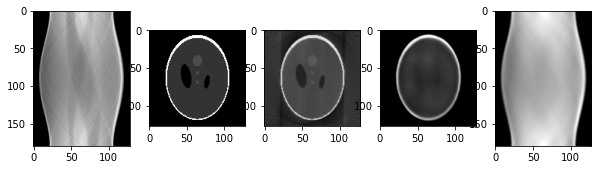

Epoch  637 ; Loss:  0.008563298


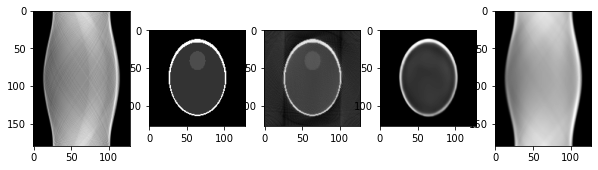

Epoch  638 ; Loss:  0.008032349


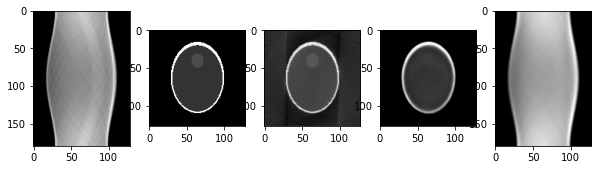

Epoch  639 ; Loss:  0.008131087


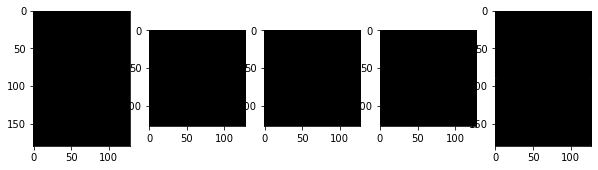

Epoch  640 ; Loss:  0.008373348


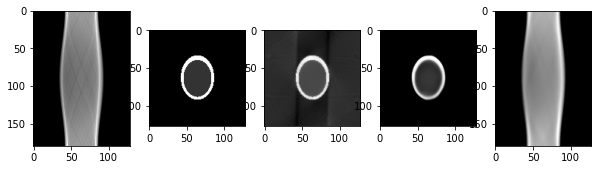

Epoch  641 ; Loss:  0.008136048


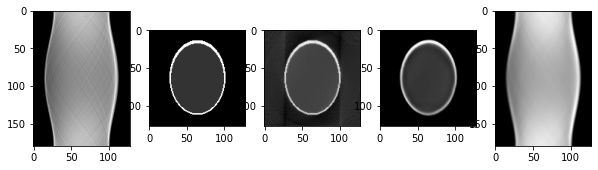

Epoch  642 ; Loss:  0.008814289


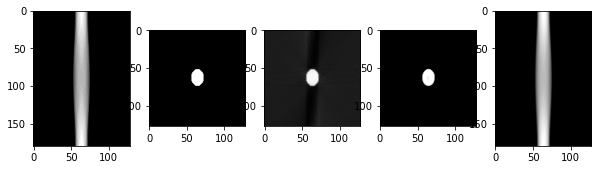

Epoch  643 ; Loss:  0.008599001


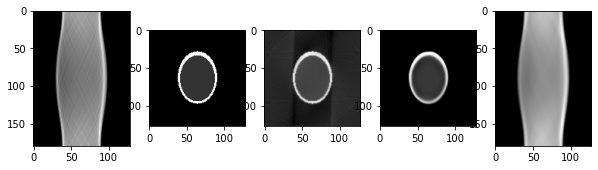

Epoch  644 ; Loss:  0.008048348


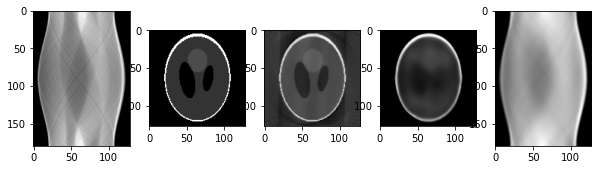

Epoch  645 ; Loss:  0.008113393


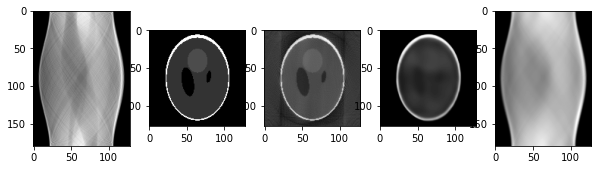

Epoch  646 ; Loss:  0.007990468


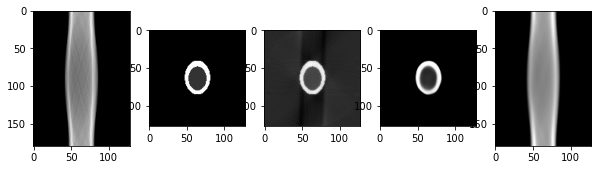

Epoch  647 ; Loss:  0.00797683


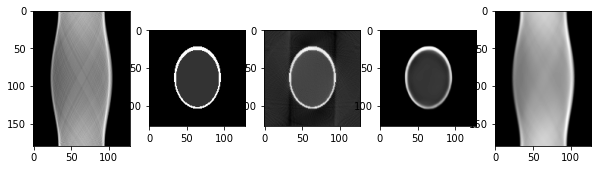

Epoch  648 ; Loss:  0.008315743


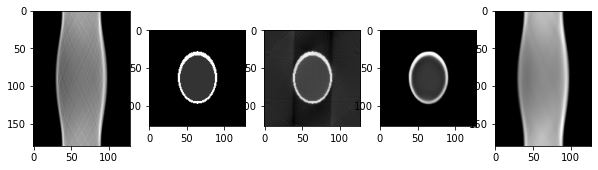

Epoch  649 ; Loss:  0.008056602


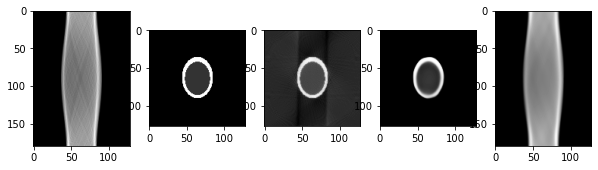

Epoch  650 ; Loss:  0.008122512


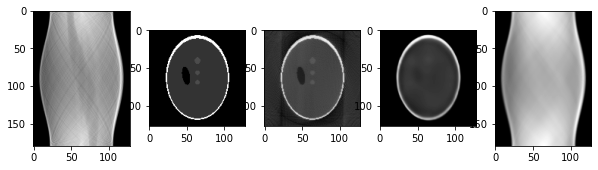

Epoch  651 ; Loss:  0.008052197


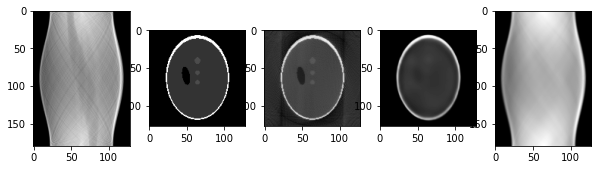

Epoch  652 ; Loss:  0.008199397


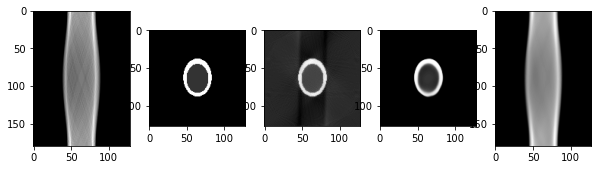

Epoch  653 ; Loss:  0.008329197


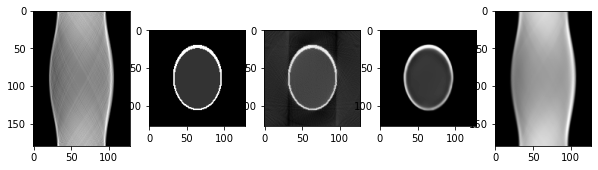

Epoch  654 ; Loss:  0.007994707


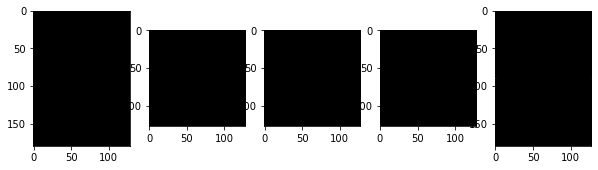

Epoch  655 ; Loss:  0.008011605


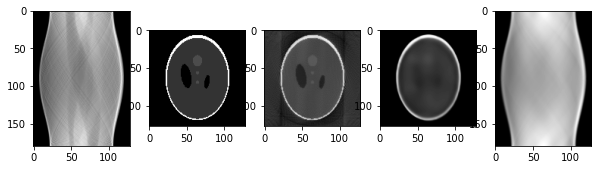

Epoch  656 ; Loss:  0.00819595


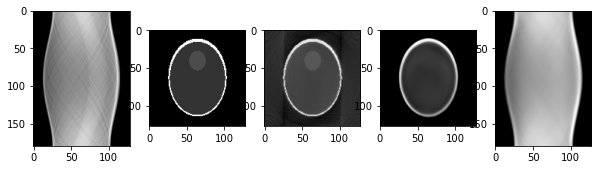

Epoch  657 ; Loss:  0.008221796


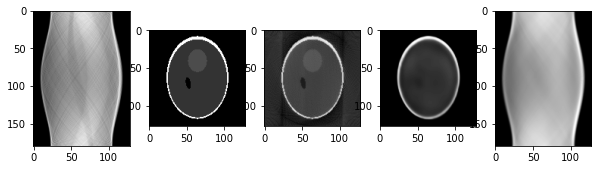

Epoch  658 ; Loss:  0.008478071


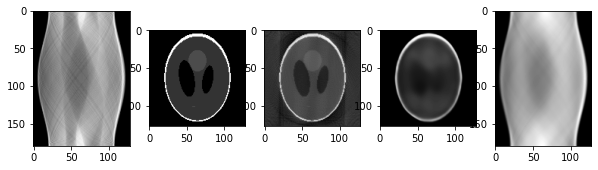

Epoch  659 ; Loss:  0.008137859


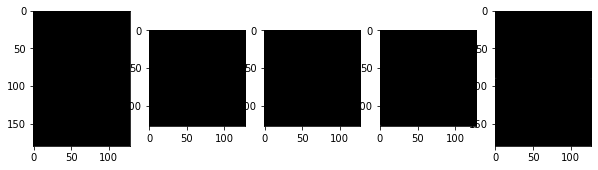

Epoch  660 ; Loss:  0.008015319


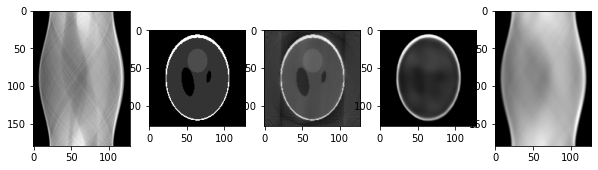

Epoch  661 ; Loss:  0.00823943


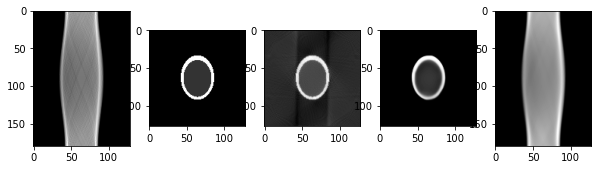

Epoch  662 ; Loss:  0.007905983


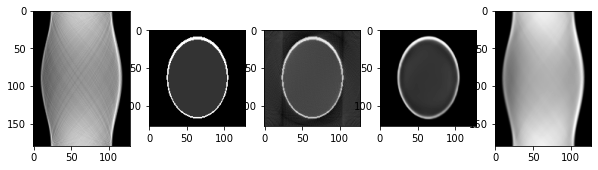

Epoch  663 ; Loss:  0.007958628


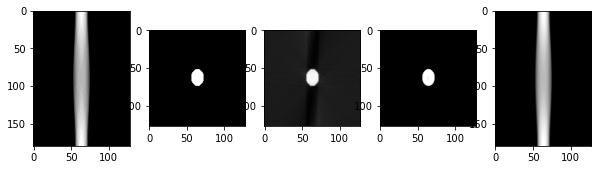

Epoch  664 ; Loss:  0.0089038955


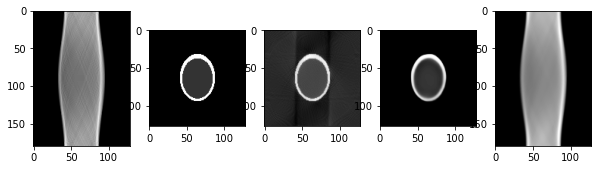

Epoch  665 ; Loss:  0.007951336


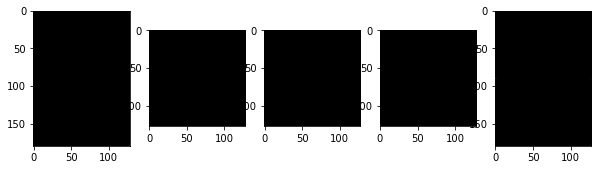

Epoch  666 ; Loss:  0.007927889


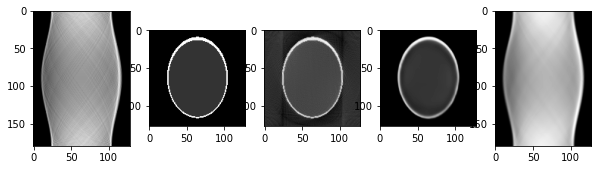

Epoch  667 ; Loss:  0.008132133


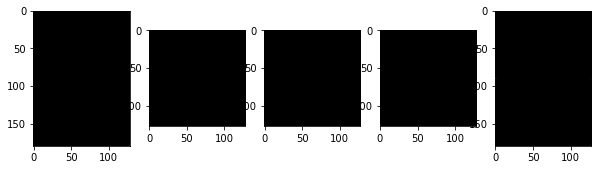

Epoch  668 ; Loss:  0.008008442


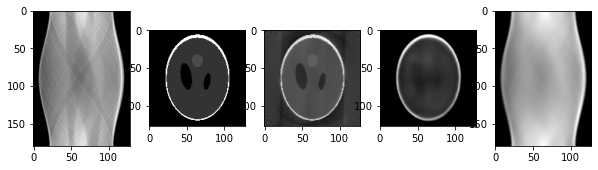

Epoch  669 ; Loss:  0.008137599


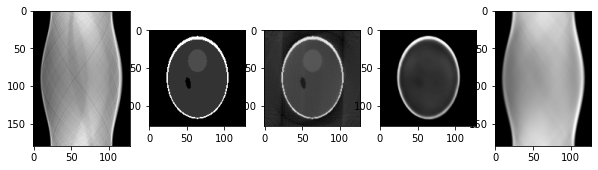

Epoch  670 ; Loss:  0.008208065


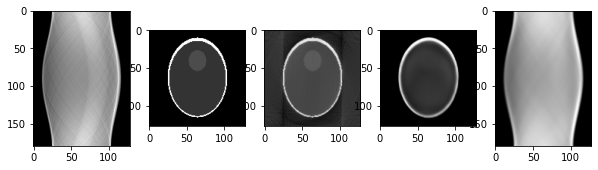

Epoch  671 ; Loss:  0.008027138


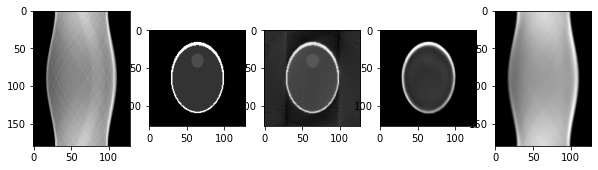

Epoch  672 ; Loss:  0.008161992


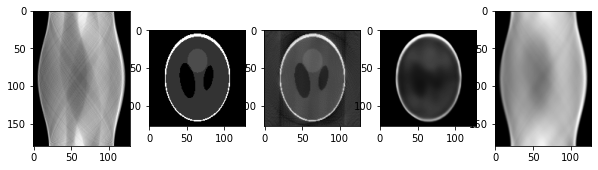

Epoch  673 ; Loss:  0.00883915


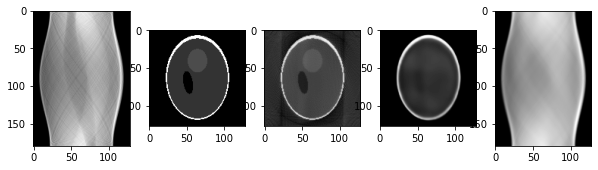

Epoch  674 ; Loss:  0.00834081


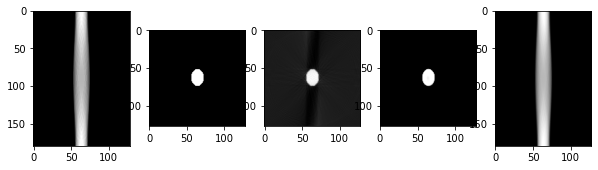

Epoch  675 ; Loss:  0.008114238


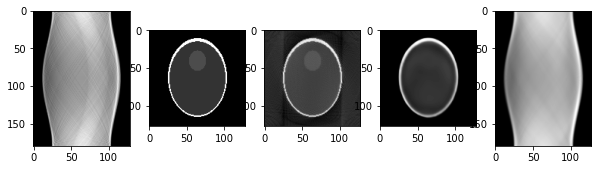

Epoch  676 ; Loss:  0.007955583


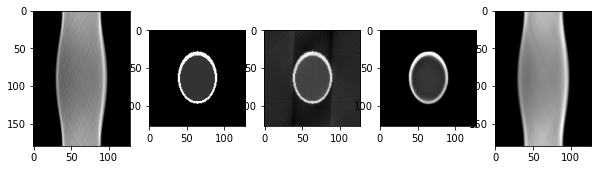

Epoch  677 ; Loss:  0.007982298


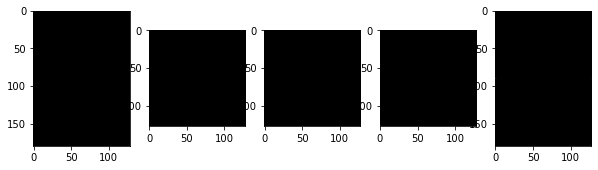

Epoch  678 ; Loss:  0.007978874


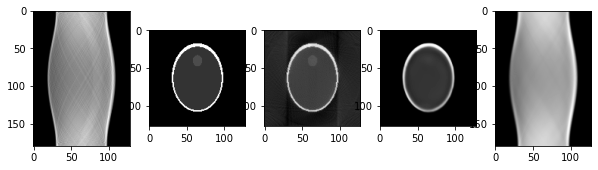

Epoch  679 ; Loss:  0.007947868


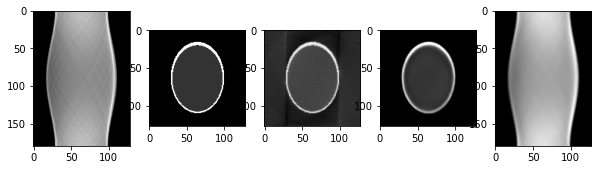

Epoch  680 ; Loss:  0.0078699775


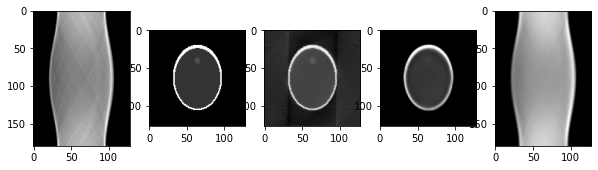

Epoch  681 ; Loss:  0.008123279


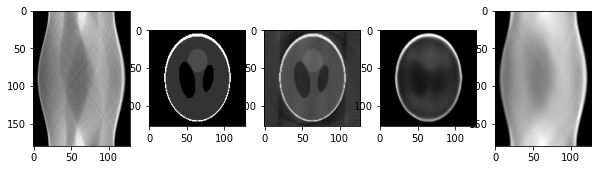

Epoch  682 ; Loss:  0.008131903


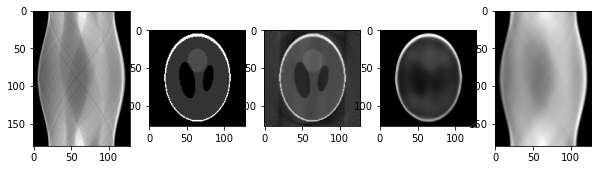

Epoch  683 ; Loss:  0.008094299


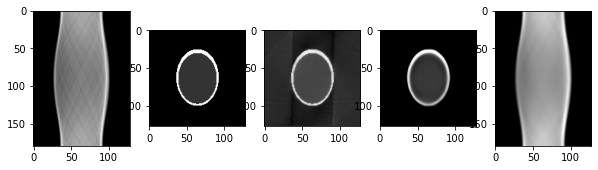

Epoch  684 ; Loss:  0.0078609465


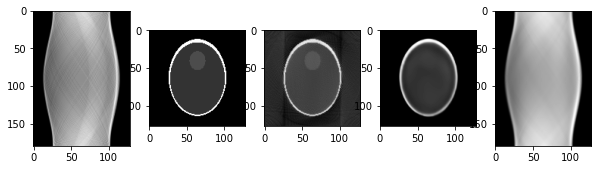

Epoch  685 ; Loss:  0.007917082


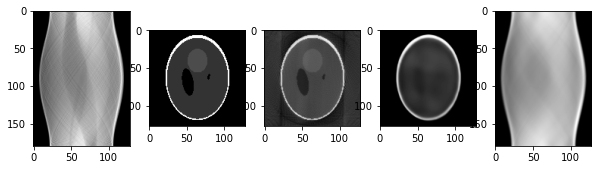

Epoch  686 ; Loss:  0.007817455


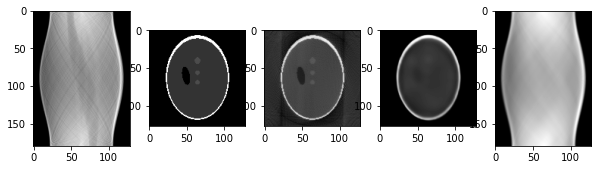

Epoch  687 ; Loss:  0.007853396


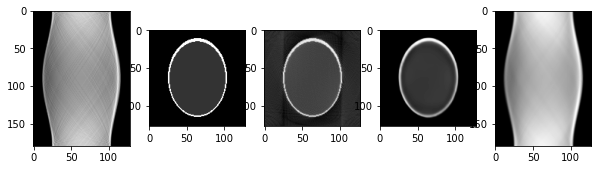

Epoch  688 ; Loss:  0.007833509


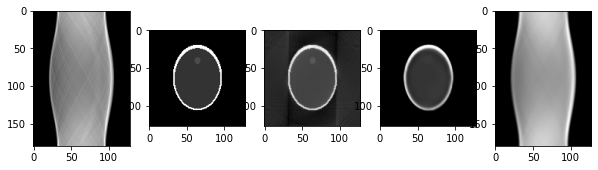

Epoch  689 ; Loss:  0.008000451


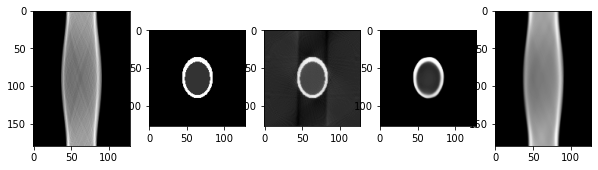

Epoch  690 ; Loss:  0.008215906


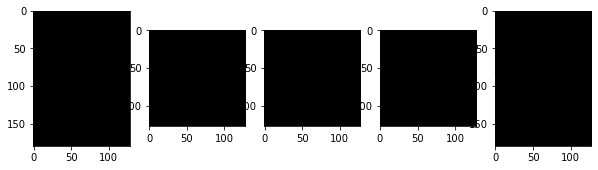

Epoch  691 ; Loss:  0.007854698


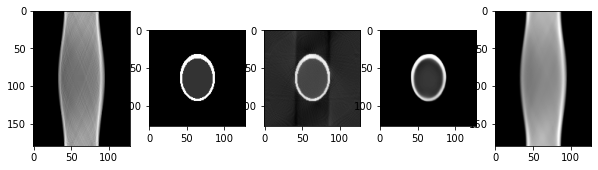

Epoch  692 ; Loss:  0.007823892


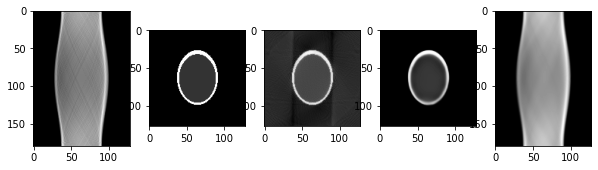

Epoch  693 ; Loss:  0.0077605797


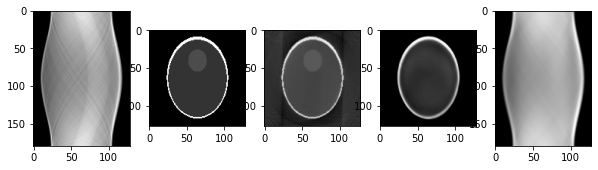

Epoch  694 ; Loss:  0.007902967


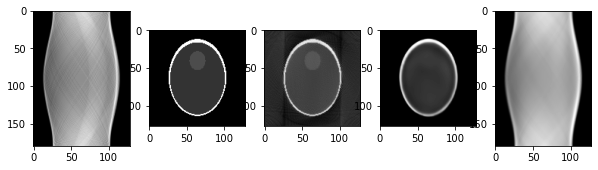

Epoch  695 ; Loss:  0.007891063


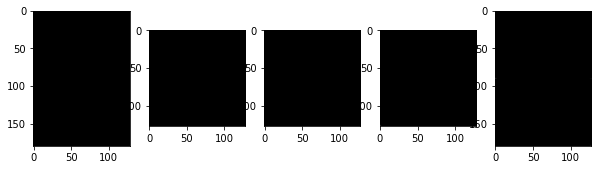

Epoch  696 ; Loss:  0.00783318


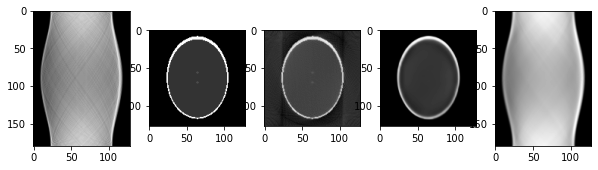

Epoch  697 ; Loss:  0.007978041


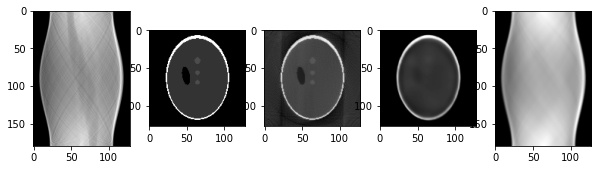

Epoch  698 ; Loss:  0.007904125


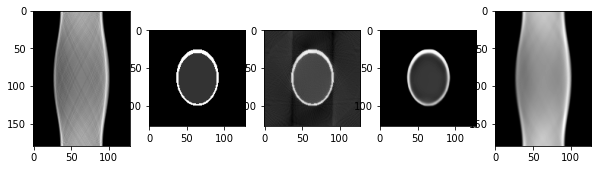

Epoch  699 ; Loss:  0.0077626584


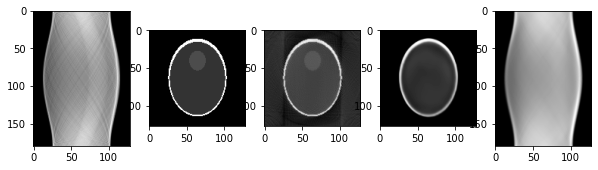

Epoch  700 ; Loss:  0.007888165


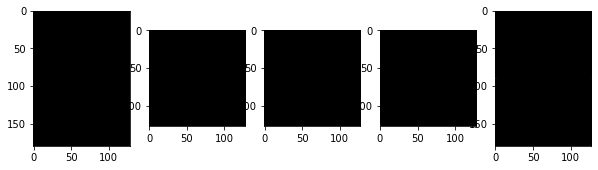

Epoch  701 ; Loss:  0.0078023793


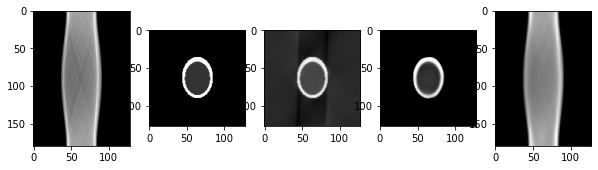

Epoch  702 ; Loss:  0.007848662


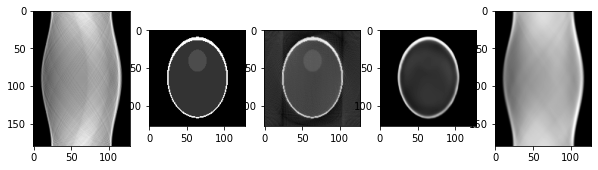

Epoch  703 ; Loss:  0.007940498


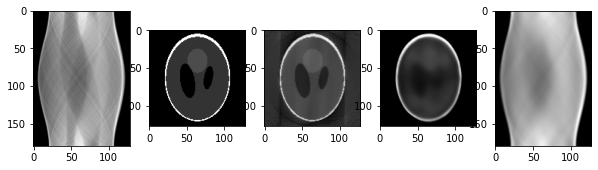

Epoch  704 ; Loss:  0.00907923


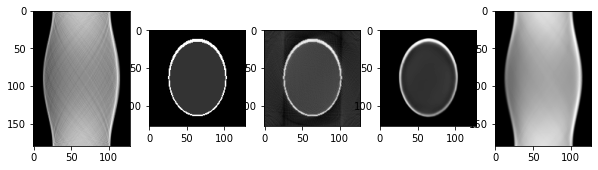

Epoch  705 ; Loss:  0.008629274


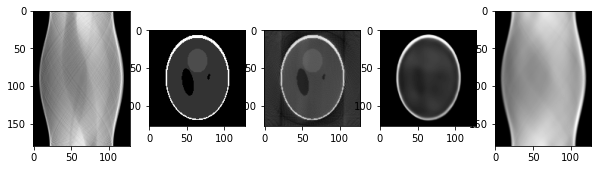

Epoch  706 ; Loss:  0.0081286235


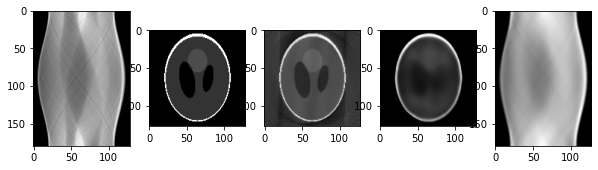

Epoch  707 ; Loss:  0.0078244675


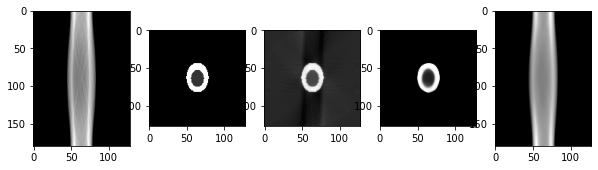

Epoch  708 ; Loss:  0.009284532


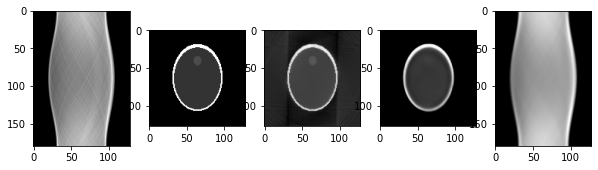

Epoch  709 ; Loss:  0.008634438


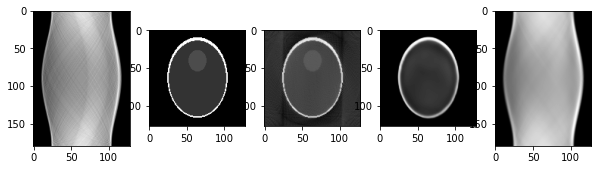

Epoch  710 ; Loss:  0.007815035


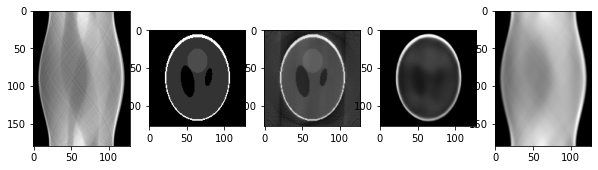

Epoch  711 ; Loss:  0.0077634235


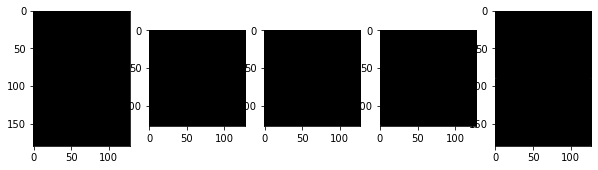

Epoch  712 ; Loss:  0.007697615


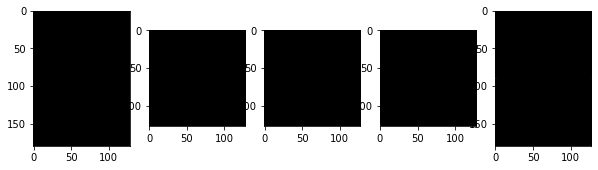

Epoch  713 ; Loss:  0.007707551


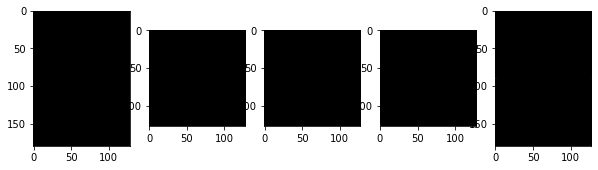

Epoch  714 ; Loss:  0.0077170758


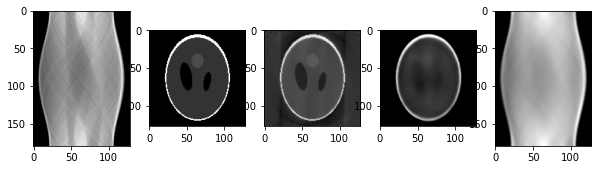

Epoch  715 ; Loss:  0.007736397


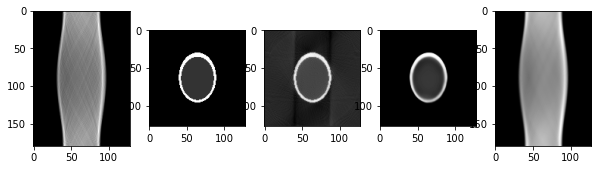

Epoch  716 ; Loss:  0.007924635


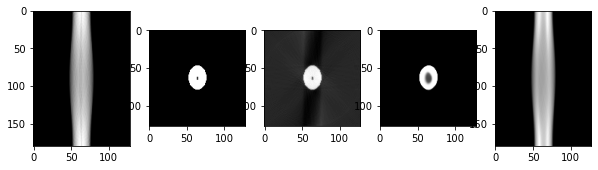

Epoch  717 ; Loss:  0.0077308314


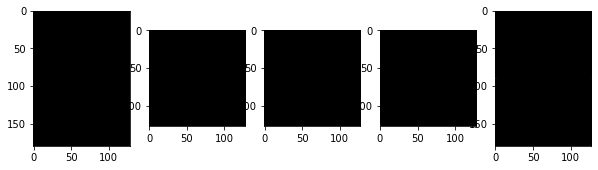

Epoch  718 ; Loss:  0.007623749


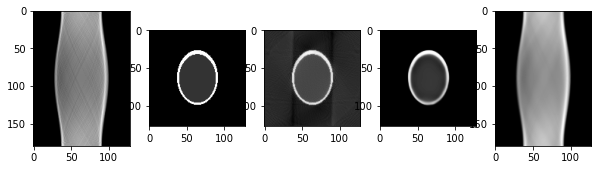

Epoch  719 ; Loss:  0.007842988


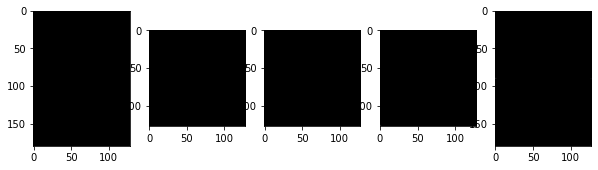

Epoch  720 ; Loss:  0.008332394


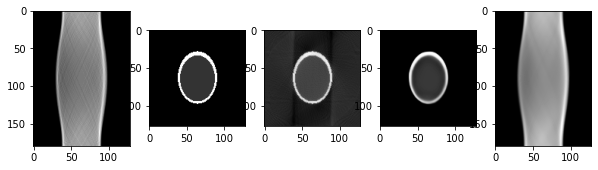

Epoch  721 ; Loss:  0.0076712198


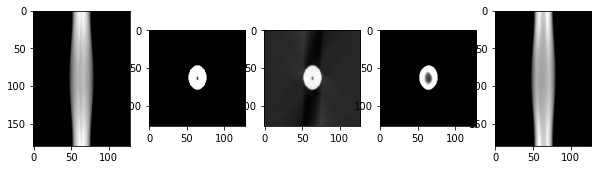

Epoch  722 ; Loss:  0.0076181646


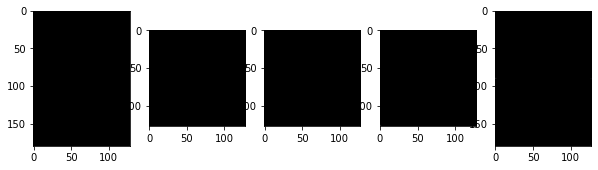

Epoch  723 ; Loss:  0.007740719


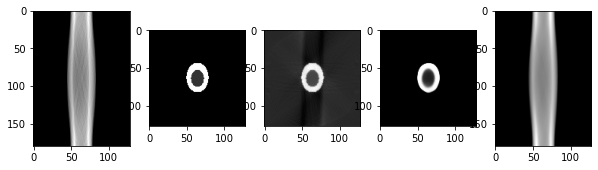

Epoch  724 ; Loss:  0.0077093765


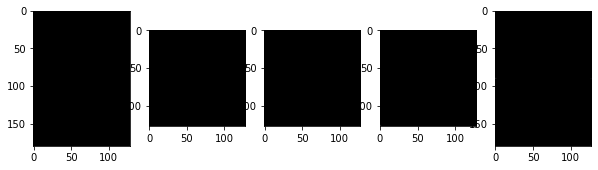

Epoch  725 ; Loss:  0.00763069


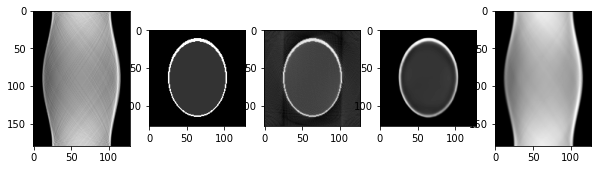

Epoch  726 ; Loss:  0.007997213


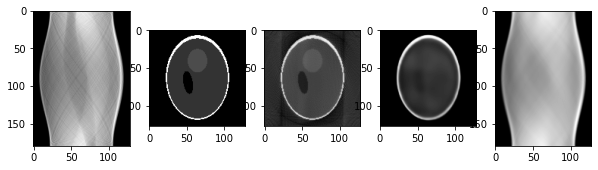

Epoch  727 ; Loss:  0.007842159


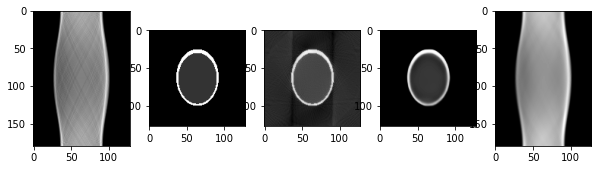

Epoch  728 ; Loss:  0.007957295


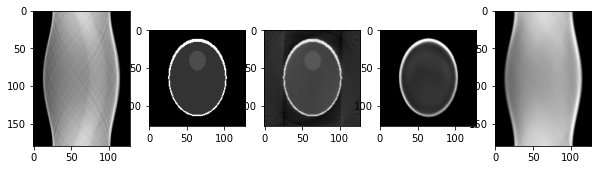

Epoch  729 ; Loss:  0.0076506147


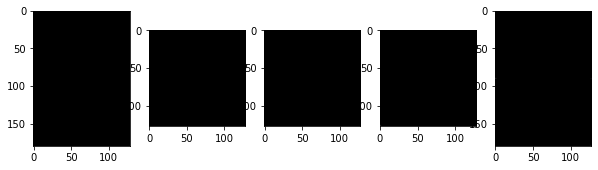

Epoch  730 ; Loss:  0.0076663583


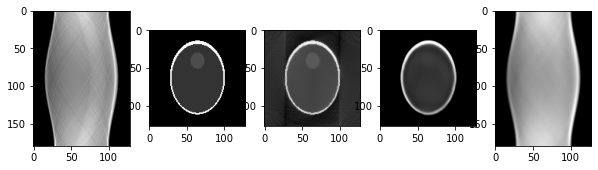

Epoch  731 ; Loss:  0.0077470024


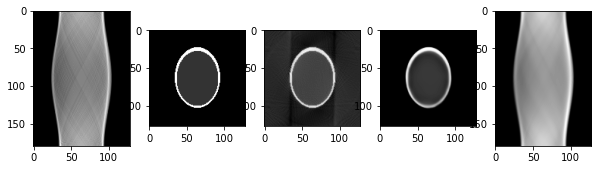

Epoch  732 ; Loss:  0.0081386855


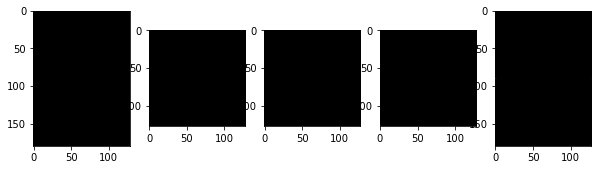

Epoch  733 ; Loss:  0.0078122974


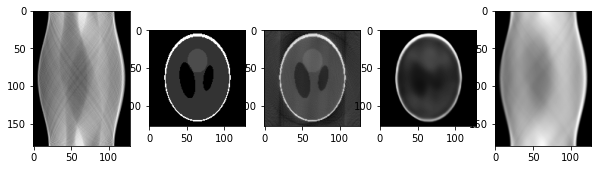

Epoch  734 ; Loss:  0.0076551368


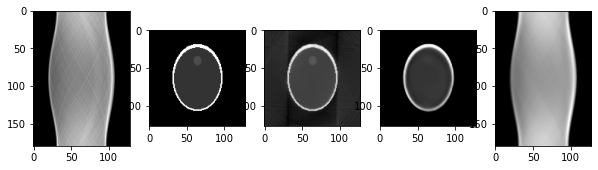

Epoch  735 ; Loss:  0.007796249


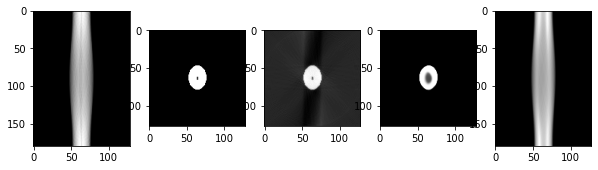

Epoch  736 ; Loss:  0.007992157


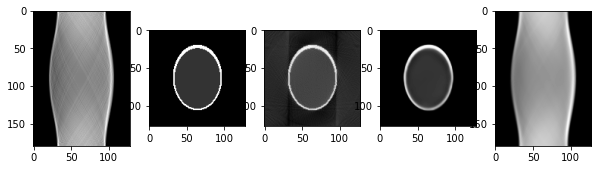

Epoch  737 ; Loss:  0.007736784


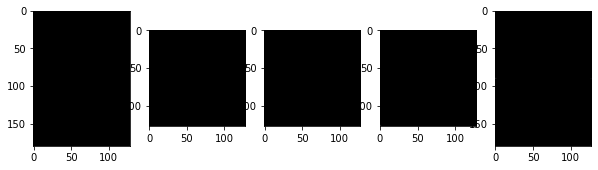

Epoch  738 ; Loss:  0.0077403253


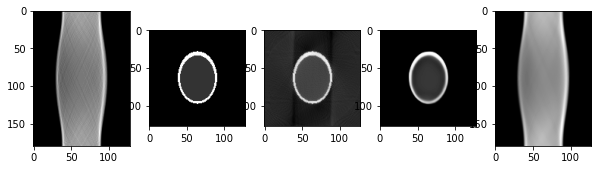

Epoch  739 ; Loss:  0.007915624


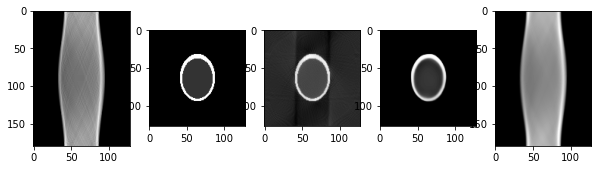

Epoch  740 ; Loss:  0.0076090405


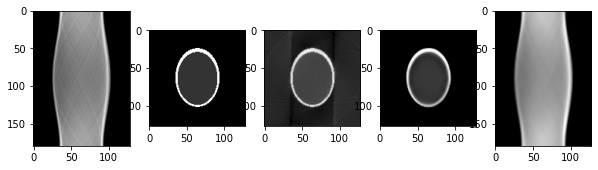

Epoch  741 ; Loss:  0.0077589247


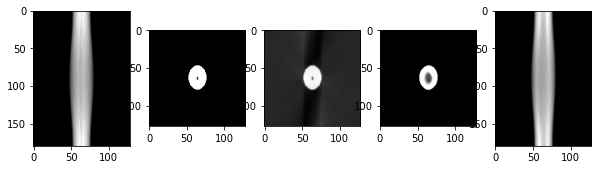

Epoch  742 ; Loss:  0.007639435


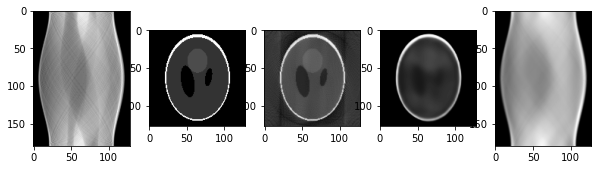

Epoch  743 ; Loss:  0.007511896


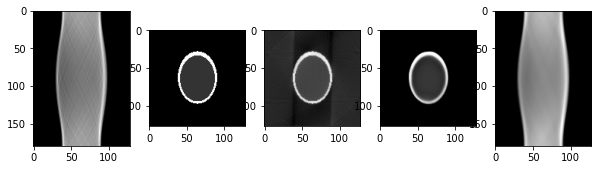

Epoch  744 ; Loss:  0.0075579397


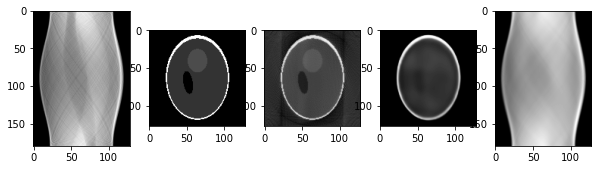

Epoch  745 ; Loss:  0.0076624826


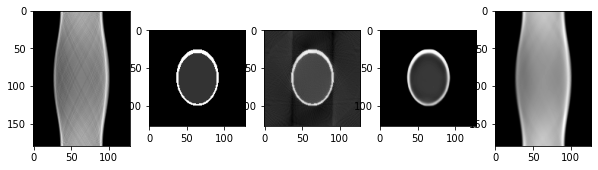

Epoch  746 ; Loss:  0.007590595


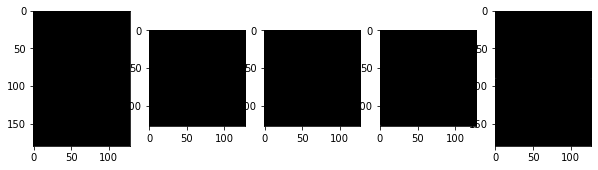

Epoch  747 ; Loss:  0.0075391796


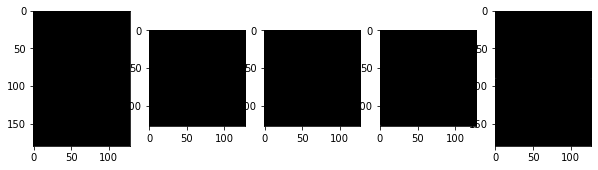

Epoch  748 ; Loss:  0.007602689


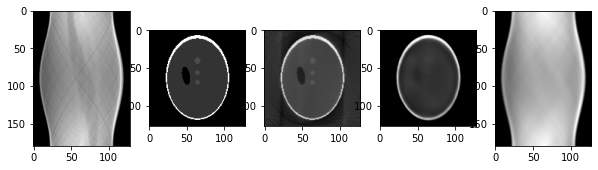

Epoch  749 ; Loss:  0.0075522633


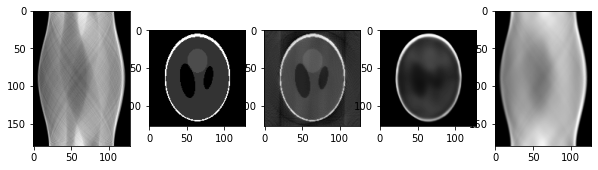

Epoch  750 ; Loss:  0.0077361204


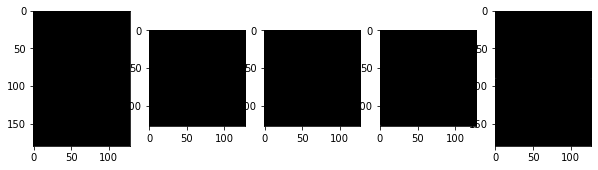

Epoch  751 ; Loss:  0.0077755307


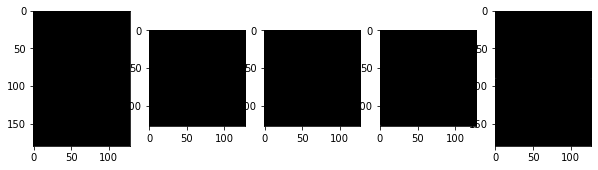

Epoch  752 ; Loss:  0.007815683


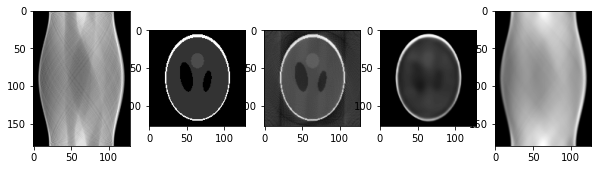

Epoch  753 ; Loss:  0.007714902


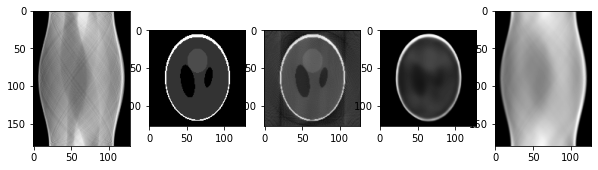

Epoch  754 ; Loss:  0.007905796


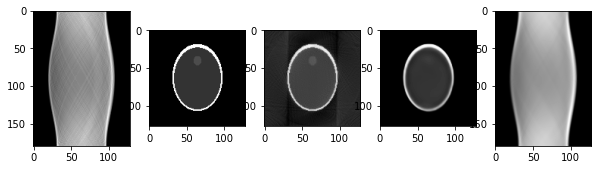

Epoch  755 ; Loss:  0.0076518096


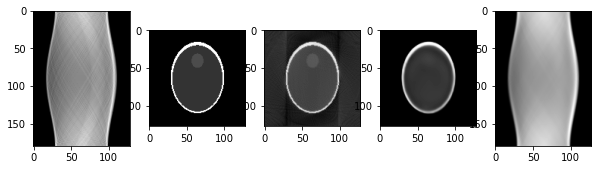

Epoch  756 ; Loss:  0.0076531493


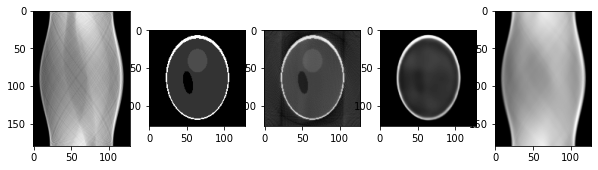

Epoch  757 ; Loss:  0.007662692


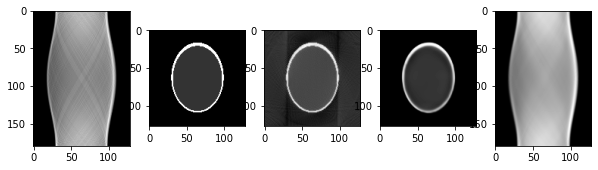

Epoch  758 ; Loss:  0.0077509237


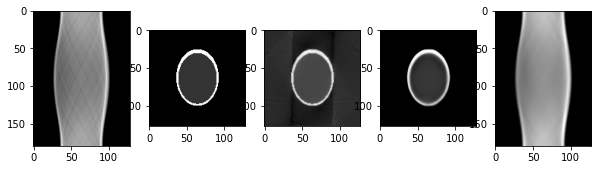

Epoch  759 ; Loss:  0.007651457


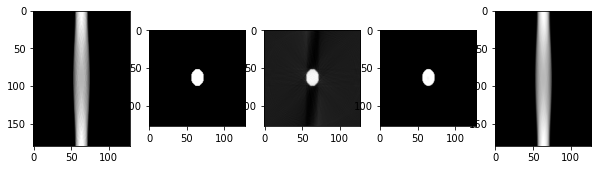

Epoch  760 ; Loss:  0.0076581496


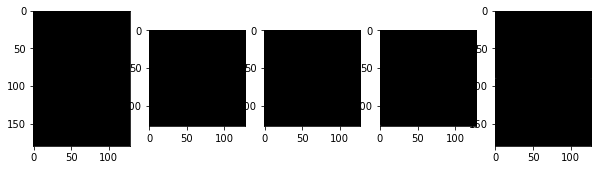

Epoch  761 ; Loss:  0.007583865


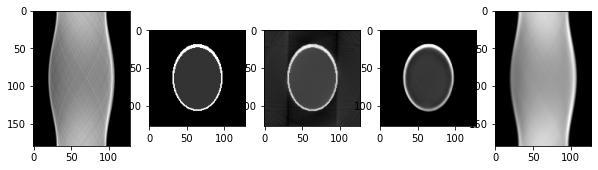

Epoch  762 ; Loss:  0.007727788


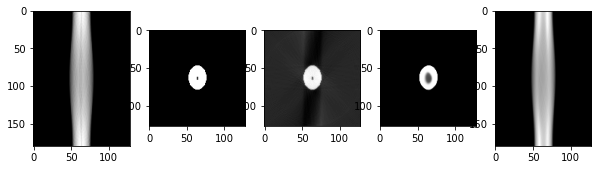

Epoch  763 ; Loss:  0.0076867673


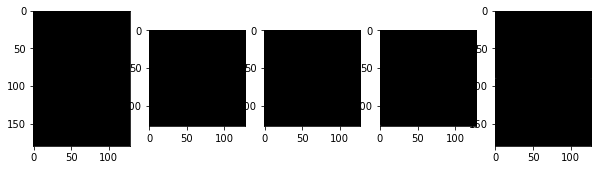

Epoch  764 ; Loss:  0.007466746


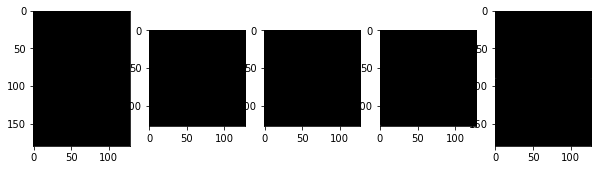

Epoch  765 ; Loss:  0.007593666


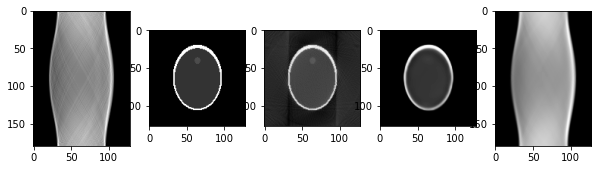

Epoch  766 ; Loss:  0.007968642


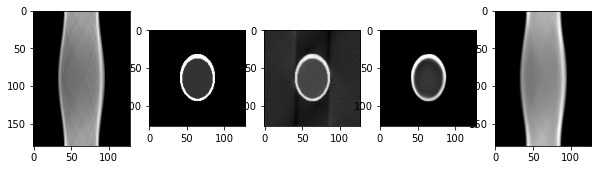

Epoch  767 ; Loss:  0.007512022


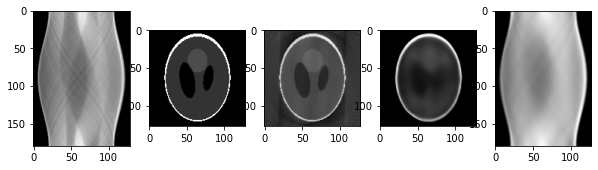

Epoch  768 ; Loss:  0.0077460953


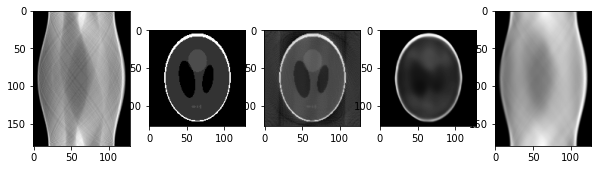

Epoch  769 ; Loss:  0.0076378137


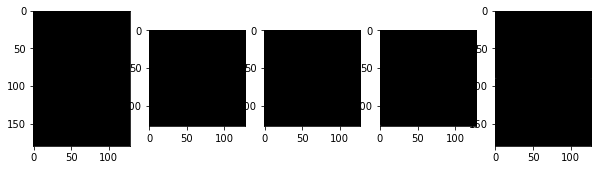

Epoch  770 ; Loss:  0.007461576


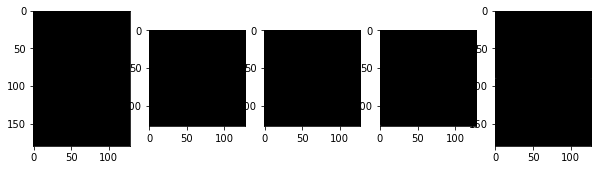

Epoch  771 ; Loss:  0.007417375


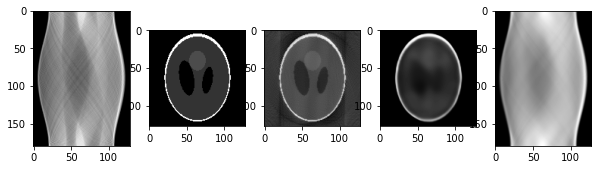

Epoch  772 ; Loss:  0.007421798


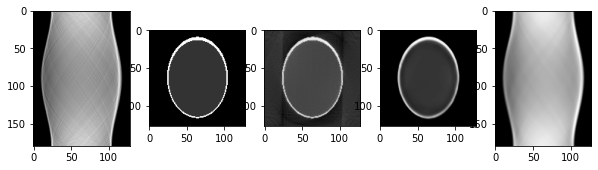

Epoch  773 ; Loss:  0.0074108066


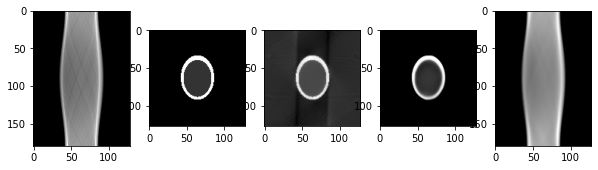

Epoch  774 ; Loss:  0.007435351


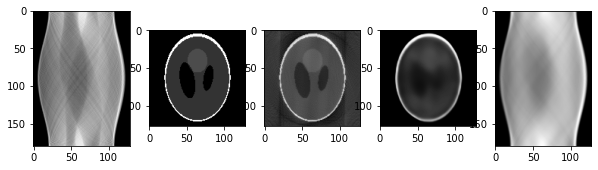

Epoch  775 ; Loss:  0.0074706282


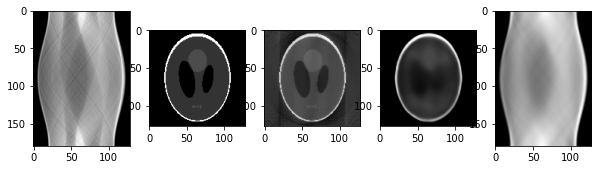

Epoch  776 ; Loss:  0.007645993


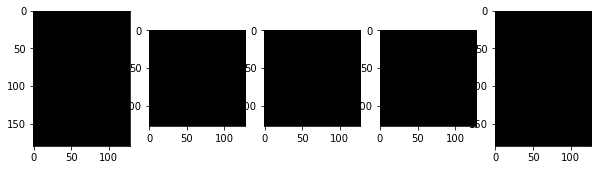

Epoch  777 ; Loss:  0.008121635


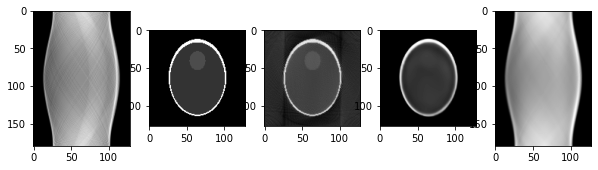

Epoch  778 ; Loss:  0.007703508


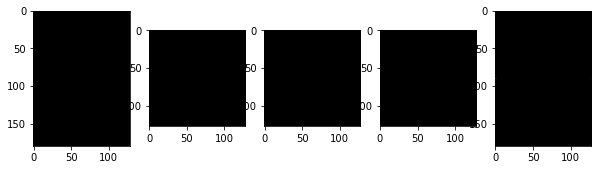

Epoch  779 ; Loss:  0.007836629


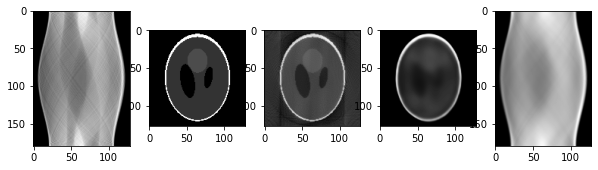

Epoch  780 ; Loss:  0.0074020834


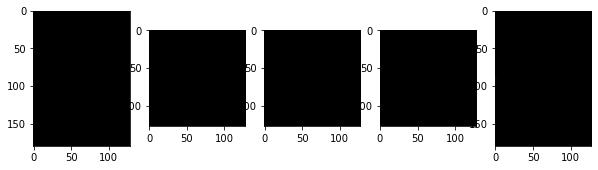

Epoch  781 ; Loss:  0.007606359


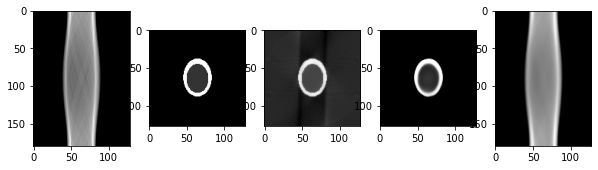

Epoch  782 ; Loss:  0.0074002054


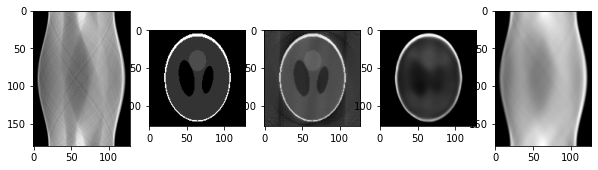

Epoch  783 ; Loss:  0.00757737


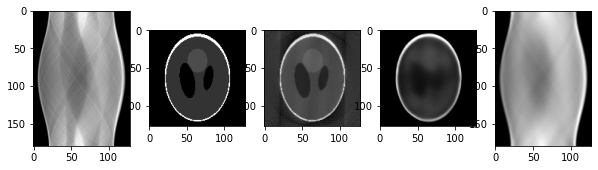

Epoch  784 ; Loss:  0.007992897


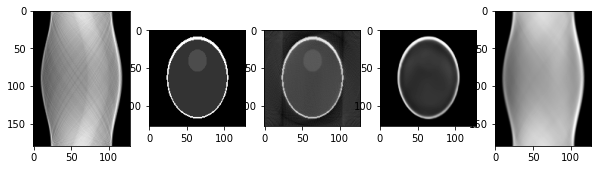

Epoch  785 ; Loss:  0.007523444


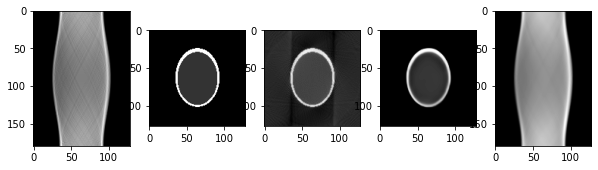

Epoch  786 ; Loss:  0.007427167


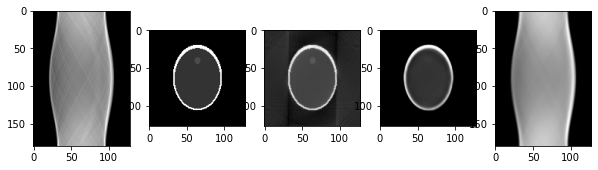

Epoch  787 ; Loss:  0.007435155


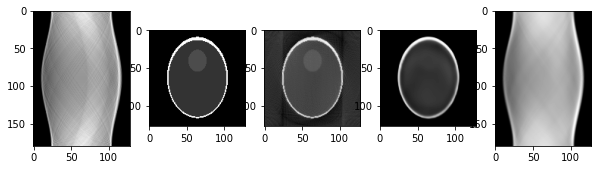

Epoch  788 ; Loss:  0.0073882444


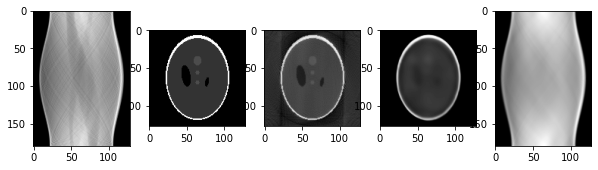

Epoch  789 ; Loss:  0.00736113


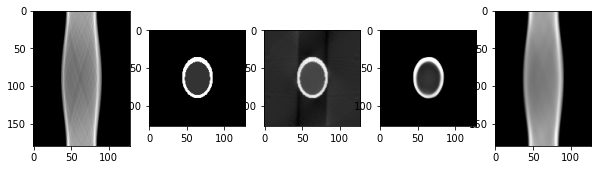

Epoch  790 ; Loss:  0.007332706


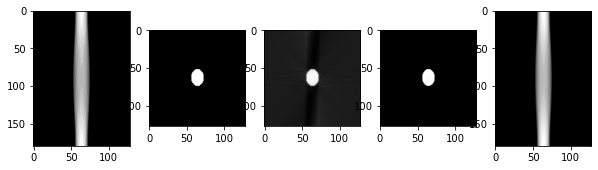

Epoch  791 ; Loss:  0.0073689427


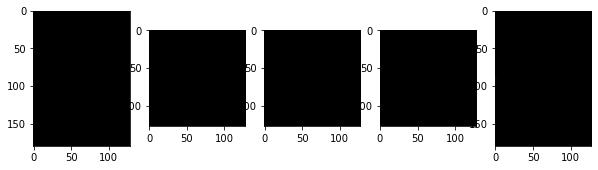

Epoch  792 ; Loss:  0.0073751924


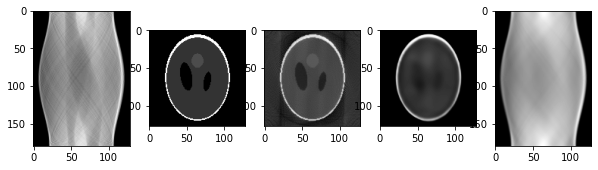

Epoch  793 ; Loss:  0.007353482


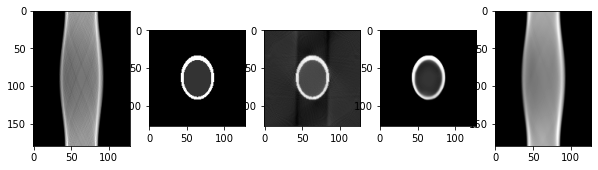

Epoch  794 ; Loss:  0.0073746415


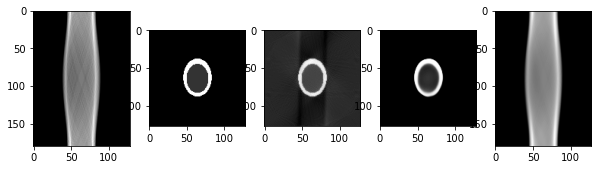

Epoch  795 ; Loss:  0.007494589


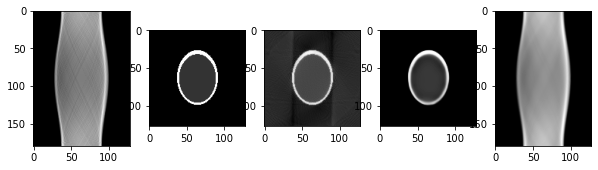

Epoch  796 ; Loss:  0.007366476


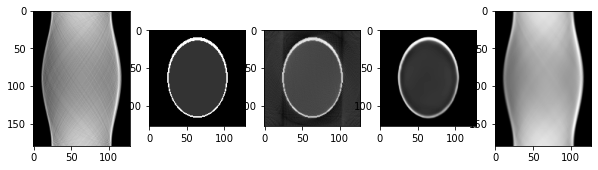

Epoch  797 ; Loss:  0.00735598


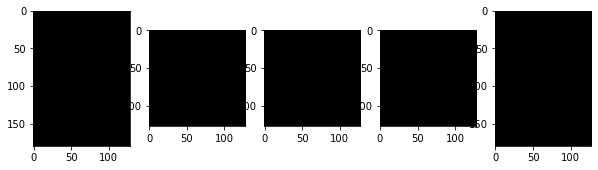

Epoch  798 ; Loss:  0.007355052


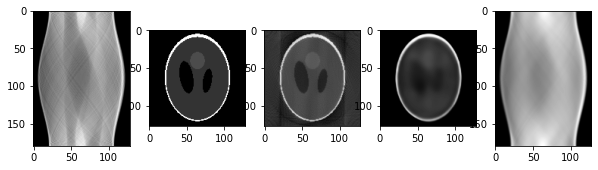

Epoch  799 ; Loss:  0.007487491


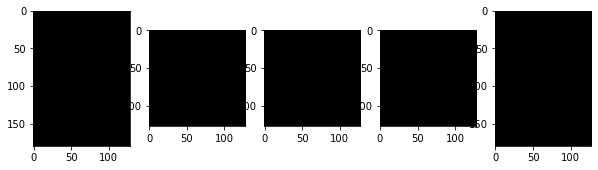

Epoch  800 ; Loss:  0.007349183


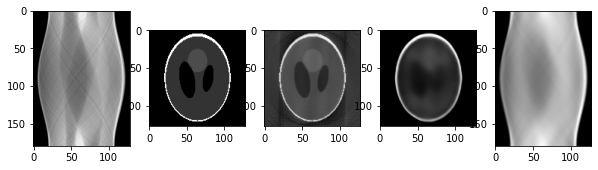

Epoch  801 ; Loss:  0.0077861114


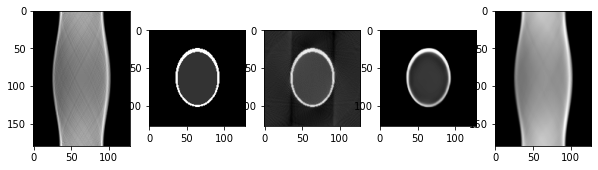

Epoch  802 ; Loss:  0.007457603


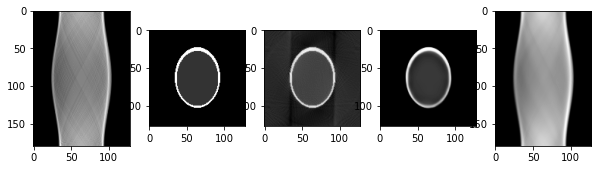

Epoch  803 ; Loss:  0.007339101


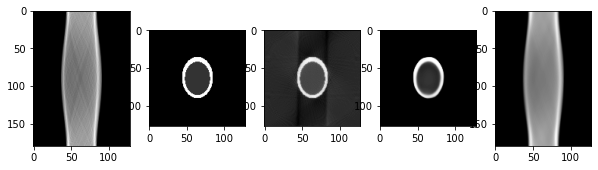

Epoch  804 ; Loss:  0.00736212


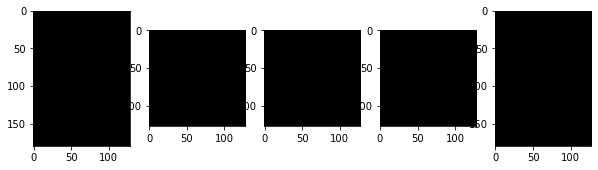

Epoch  805 ; Loss:  0.007347664


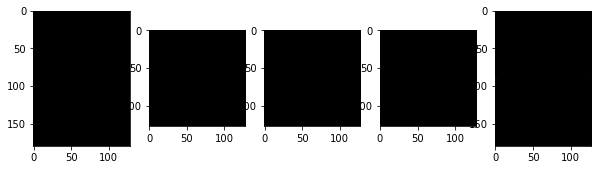

Epoch  806 ; Loss:  0.007378435


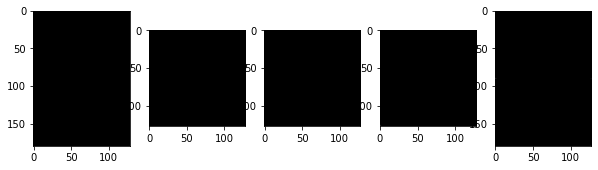

Epoch  807 ; Loss:  0.0073534134


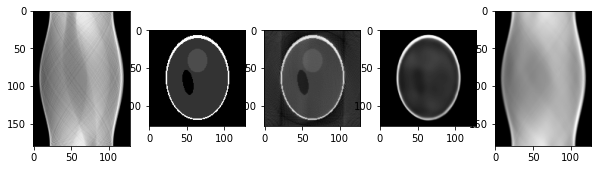

Epoch  808 ; Loss:  0.007356813


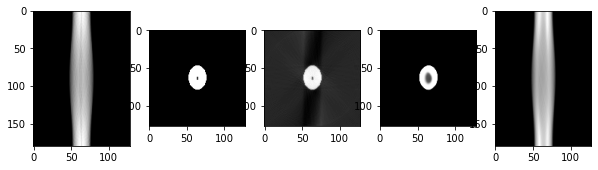

Epoch  809 ; Loss:  0.0078062206


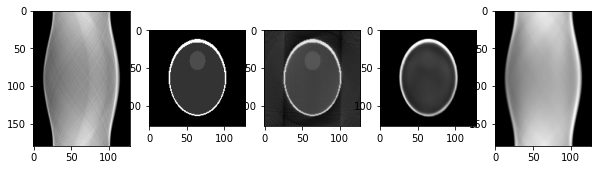

Epoch  810 ; Loss:  0.008428444


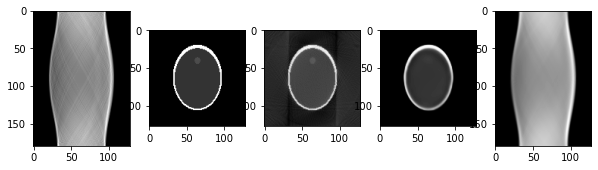

Epoch  811 ; Loss:  0.0074800598


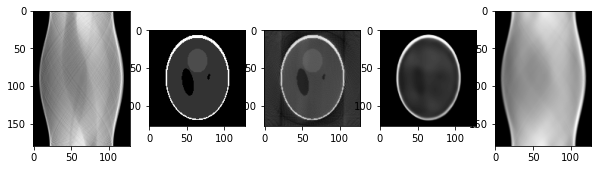

Epoch  812 ; Loss:  0.007546826


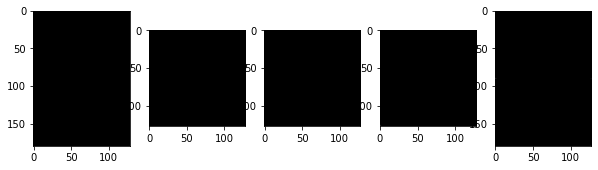

Epoch  813 ; Loss:  0.0077333064


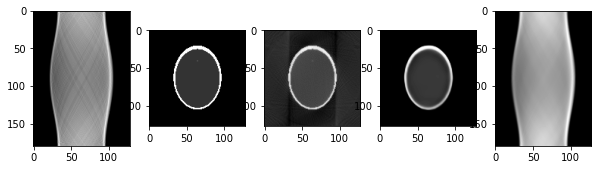

Epoch  814 ; Loss:  0.007738571


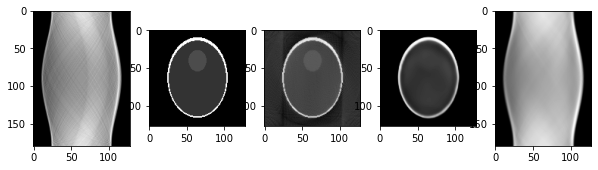

Epoch  815 ; Loss:  0.0075969077


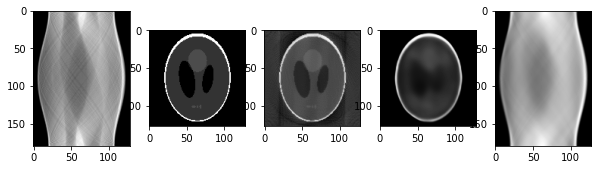

Epoch  816 ; Loss:  0.0073645073


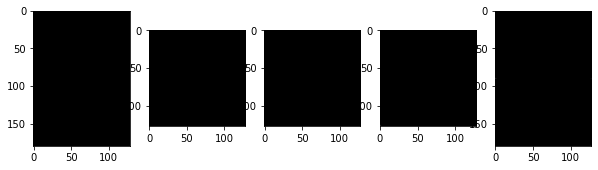

Epoch  817 ; Loss:  0.0076203123


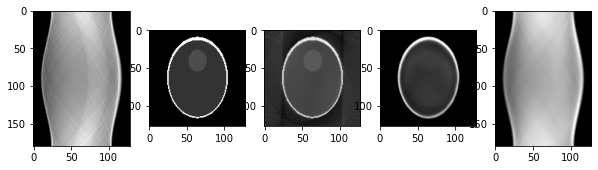

Epoch  818 ; Loss:  0.0073961737


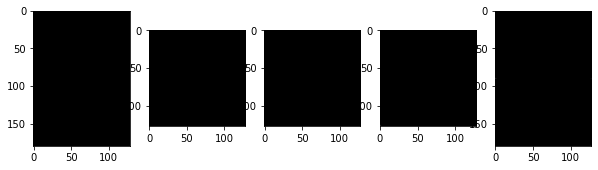

Epoch  819 ; Loss:  0.0073565184


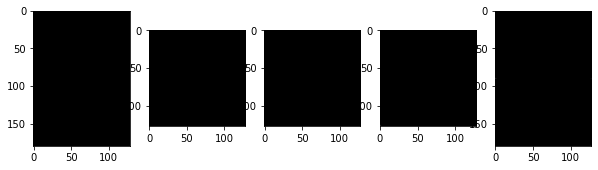

Epoch  820 ; Loss:  0.007542405


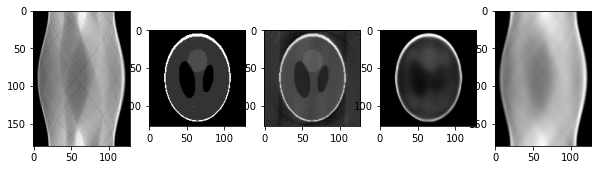

Epoch  821 ; Loss:  0.007456312


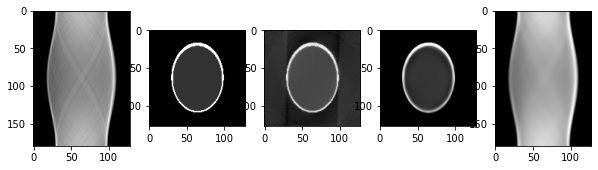

Epoch  822 ; Loss:  0.007393707


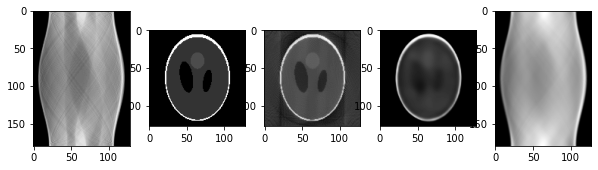

Epoch  823 ; Loss:  0.007495426


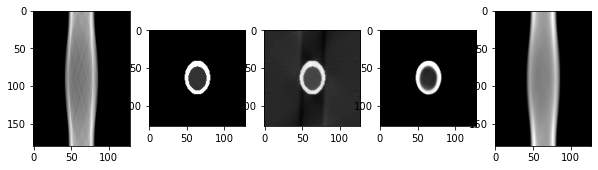

Epoch  824 ; Loss:  0.0076181283


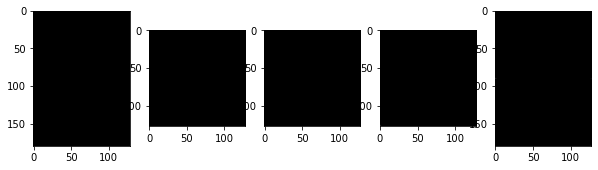

Epoch  825 ; Loss:  0.007212648


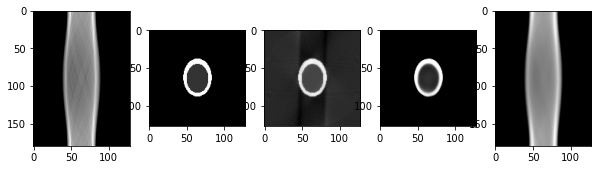

Epoch  826 ; Loss:  0.007230219


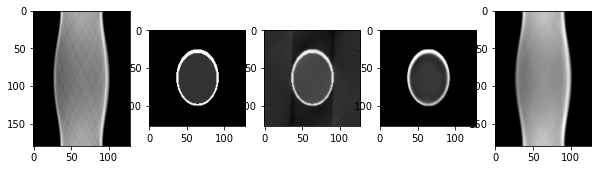

Epoch  827 ; Loss:  0.007217473


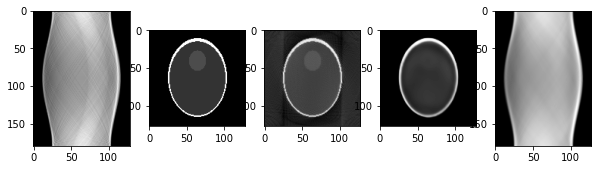

Epoch  828 ; Loss:  0.0073346104


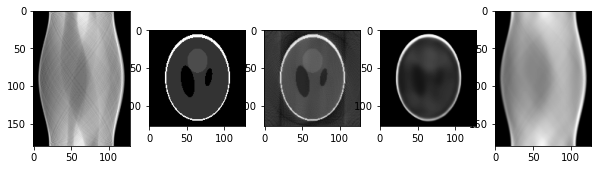

Epoch  829 ; Loss:  0.007331191


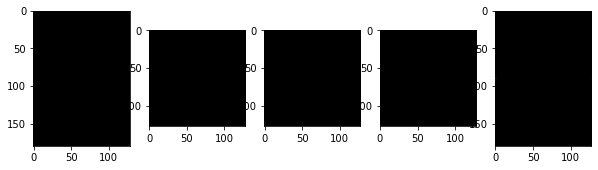

Epoch  830 ; Loss:  0.0072267083


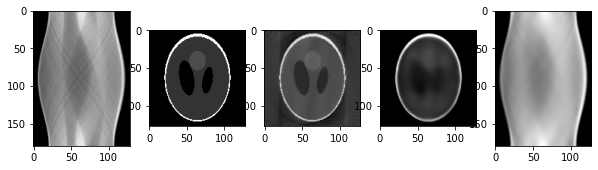

Epoch  831 ; Loss:  0.0074233133


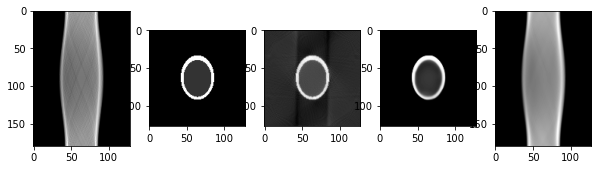

Epoch  832 ; Loss:  0.0073847193


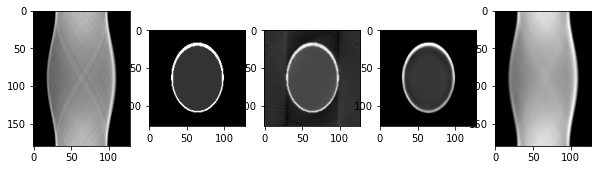

Epoch  833 ; Loss:  0.007643627


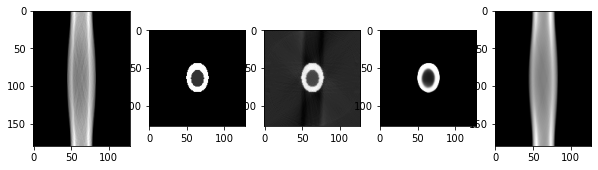

Epoch  834 ; Loss:  0.00774815


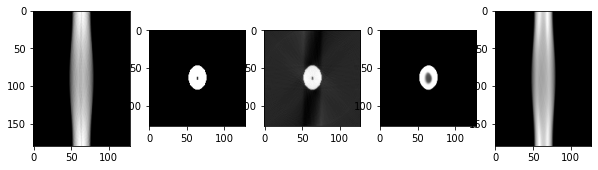

Epoch  835 ; Loss:  0.0074589252


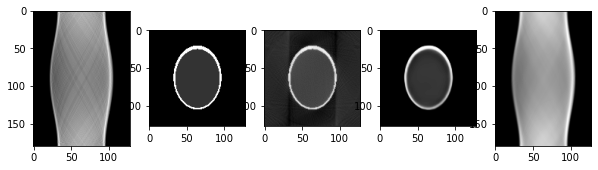

Epoch  836 ; Loss:  0.0076216925


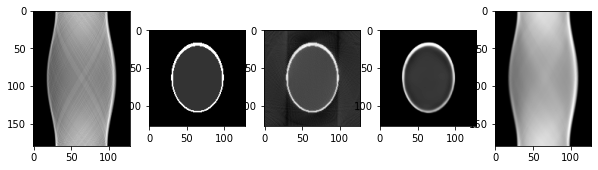

Epoch  837 ; Loss:  0.007844473


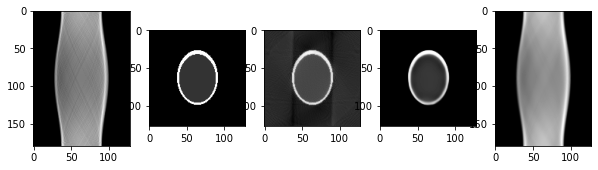

Epoch  838 ; Loss:  0.0072684004


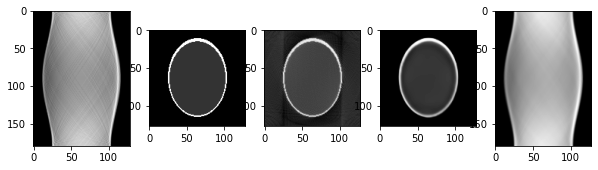

Epoch  839 ; Loss:  0.0074246144


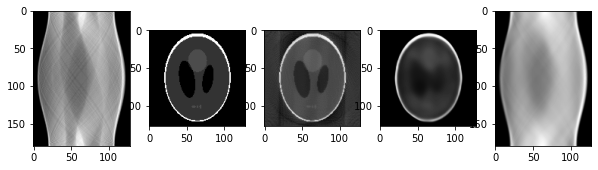

Epoch  840 ; Loss:  0.0073786913


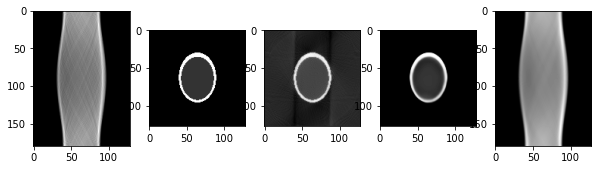

Epoch  841 ; Loss:  0.0077104946


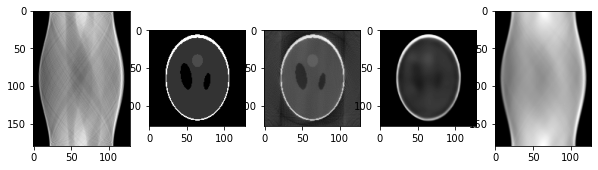

Epoch  842 ; Loss:  0.007934176


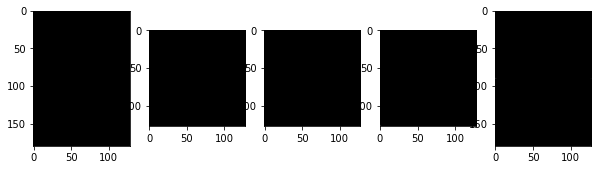

Epoch  843 ; Loss:  0.007616561


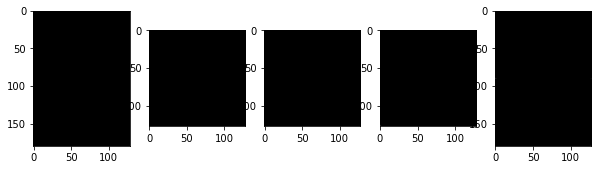

Epoch  844 ; Loss:  0.0072978036


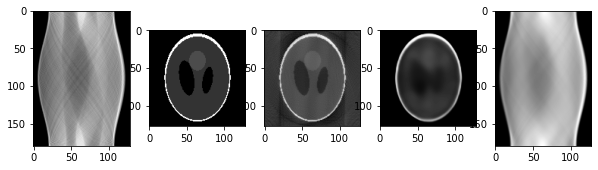

Epoch  845 ; Loss:  0.0073694475


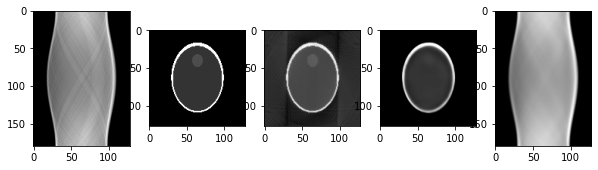

Epoch  846 ; Loss:  0.007202807


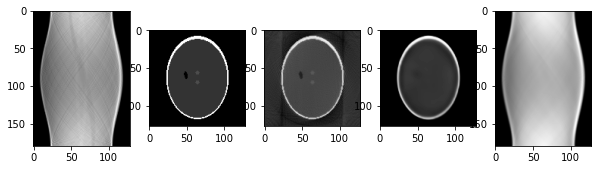

Epoch  847 ; Loss:  0.0072594103


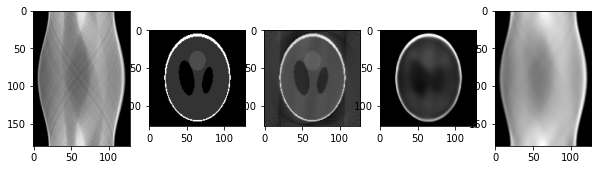

Epoch  848 ; Loss:  0.0072367927


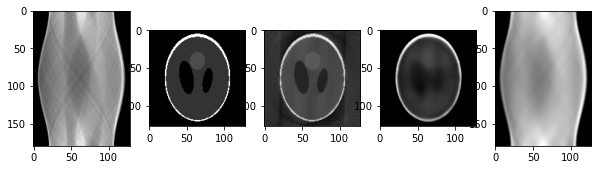

Epoch  849 ; Loss:  0.007120114


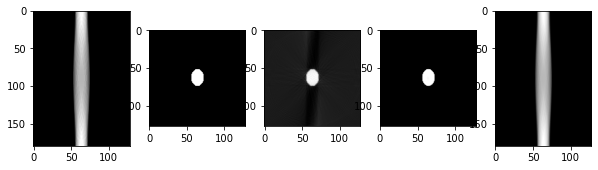

Epoch  850 ; Loss:  0.007548136


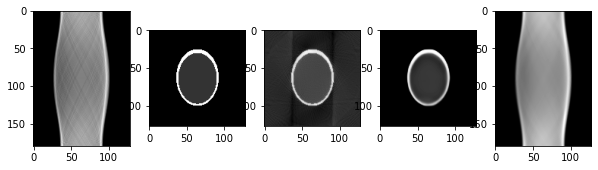

Epoch  851 ; Loss:  0.0075329584


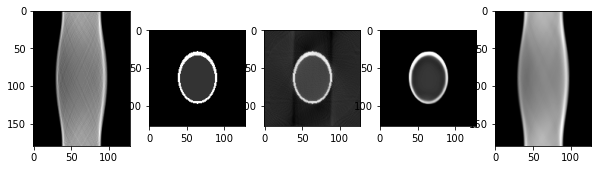

Epoch  852 ; Loss:  0.007174965


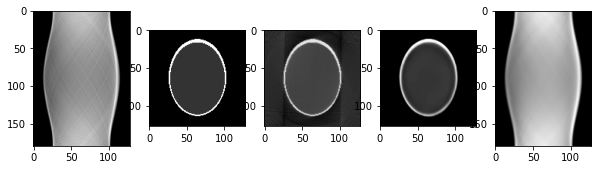

Epoch  853 ; Loss:  0.007862381


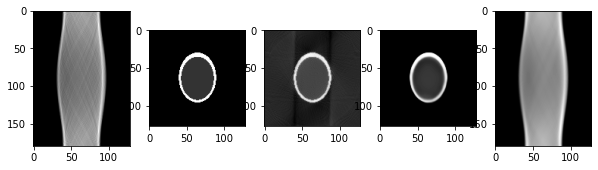

Epoch  854 ; Loss:  0.007307651


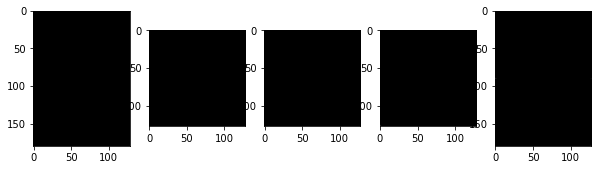

Epoch  855 ; Loss:  0.007310695


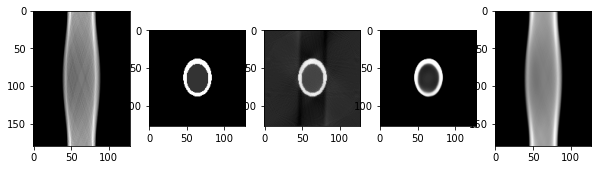

Epoch  856 ; Loss:  0.0070954654


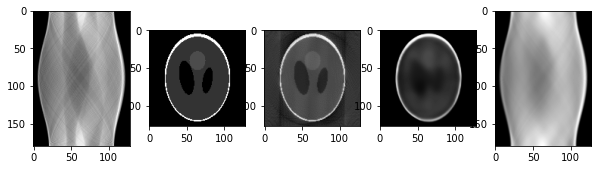

Epoch  857 ; Loss:  0.0073335087


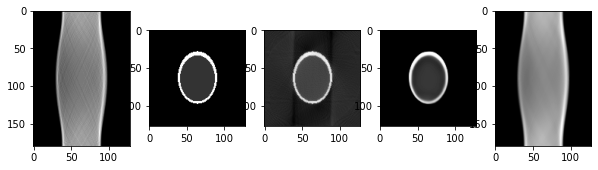

Epoch  858 ; Loss:  0.0072222585


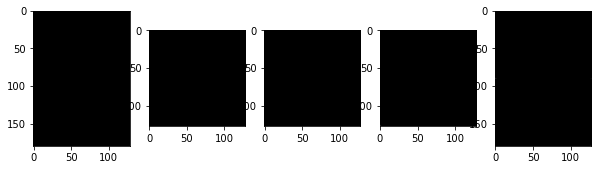

Epoch  859 ; Loss:  0.0072172983


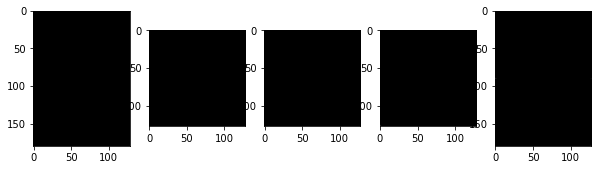

Epoch  860 ; Loss:  0.007179436


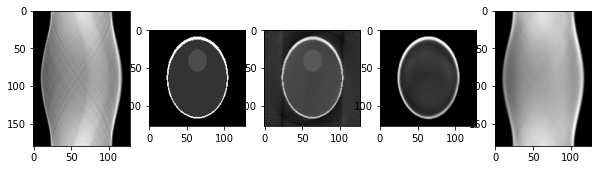

Epoch  861 ; Loss:  0.0077349325


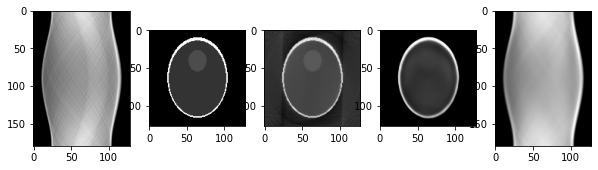

Epoch  862 ; Loss:  0.007190625


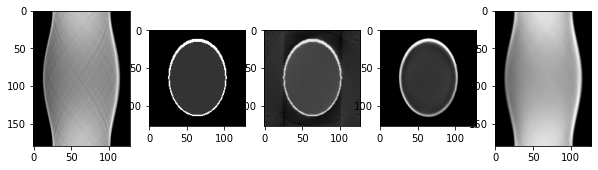

Epoch  863 ; Loss:  0.0071100397


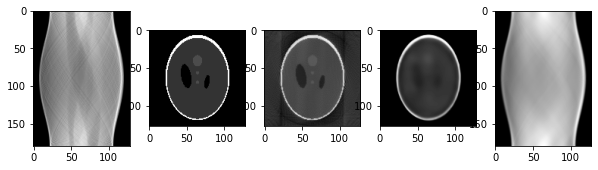

Epoch  864 ; Loss:  0.0071490835


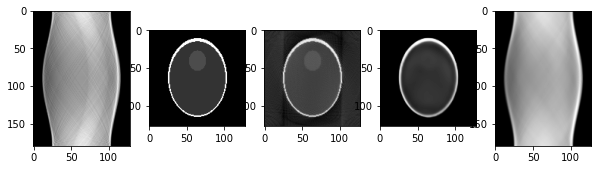

Epoch  865 ; Loss:  0.0071124695


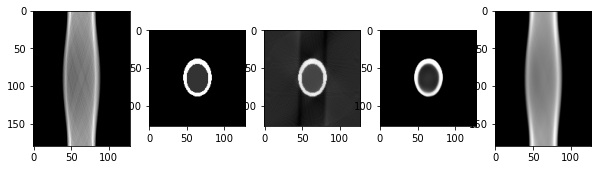

Epoch  866 ; Loss:  0.0072858213


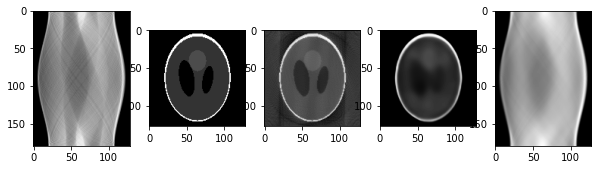

Epoch  867 ; Loss:  0.0071170963


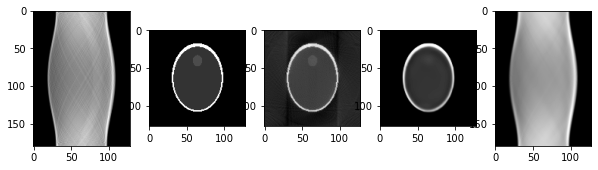

KeyboardInterrupt: 

In [8]:
acad.train(1000, traintest_dataset, (BATCH_SIZE, IM_HEIGHT, IM_WIDTH, IM_CH), lr = 1e-5)

In [ ]:
from utils import get_transform_mat, inverse_warp

TDN = 1

img = traintest_dataset[TDN]['frame1']
target_img = traintest_dataset[TDN]['frame2']
intrs = traintest_dataset[TDN]['input_intrinsics']

depth1 = depth_net(img)

enc1 = encoder_depth(img)[0]
enc2 = encoder_depth(target_img)[0]

ego = ego_net(tf.concat([enc1, enc2], -1))
        
img_with_extra_features = tf.concat([img, feature_net(img)], -1)
        
depth_for_input = 1 / depth1[0]
egomotion_mat_i_j = get_transform_mat(ego, 0, 1)
synth_image, synth_image_mask = (
    inverse_warp(
        img_with_extra_features,
        depth_for_input,
        egomotion_mat_i_j,
        intrs[:, 0, :, :],
        tf.linalg.inv(intrs[:, 0, :, :])
    )
)

synth_image *= synth_image_mask

plt.imshow(img[0,:,:,:])
plt.show()
plt.imshow(target_img[0,:,:,:])
plt.show()

for i in range(0, synth_image.shape[3]):
    fig=plt.figure(figsize=(10, 10))
    fig.add_subplot(1,2,1)
    plt.imshow(img_with_extra_features[0,:,:,i])
    
    fig.add_subplot(1,2,2)
    plt.imshow(synth_image[0,:,:,i])
    plt.show()

In [ ]:
from utils import get_transform_mat, inverse_warp

TDN = 6

img = traintest_dataset[TDN]['frame2']
target_img = traintest_dataset[TDN]['frame1']
intrs = traintest_dataset[TDN]['input_intrinsics']

depth1 = depth_net(img)

enc1 = encoder_depth(img)[0]
enc2 = encoder_depth(target_img)[0]

ego = ego_net(tf.concat([enc1, enc2], -1))
        
img_with_extra_features = feature_net(img)
        
depth_for_input = 1 / depth1[0]
egomotion_mat_i_j = get_transform_mat(ego, 0, 1)
synth_image, synth_image_mask = (
    inverse_warp(
        img_with_extra_features,
        depth_for_input,
        egomotion_mat_i_j,
        intrs[:, 0, :, :],
        tf.linalg.inv(intrs[:, 0, :, :])
    )
)

synth_image *= synth_image_mask

print(synth_image.shape)

fig=plt.figure(figsize=(10, 10))

fig.add_subplot(1,3,1)
plt.imshow(img[0,:,:,:])
fig.add_subplot(1,3,2)
plt.imshow(target_img[0,:,:,:])
fig.add_subplot(1,3,3)
plt.imshow(refinement_net(synth_image)[0])
plt.show()

In [ ]:
plt.imshow(traintest_dataset[0]['frame1'][0])
plt.show()
plt.imshow(traintest_dataset[0]['frame2'][0])
plt.show()
plt.imshow(1/tf.squeeze(depth_net(traintest_dataset[0]['frame1'])[0][0]))
plt.show()
plt.imshow(1/tf.squeeze(depth_net(traintest_dataset[0]['frame2'])[0][0]))
plt.show()
plt.imshow(refinement_net(traintest_dataset[0]['frame1'])[0])
plt.show()

print(tf.reduce_max(refinement_net(traintest_dataset[0]['frame2'])[0]))
print(tf.reduce_min(refinement_net(traintest_dataset[0]['frame2'])[0]))

In [ ]:
import inference
from inference import inference
from PIL import Image
import numpy as np

traintest_dataset.switchMode('train')

TDN = 2

test_ego = ego_net(tf.concat([encoder_depth(traintest_dataset[TDN]['frame2'])[0], encoder_depth(traintest_dataset[TDN]['frame1'])[0]], -1))

print(test_ego)

plt.gray()

fig=plt.figure(figsize=(20, 20))
fig.add_subplot(1,4,1)
plt.imshow(traintest_dataset[TDN]['frame2'][0])
#plt.show()
fig.add_subplot(1,4,2)
plt.imshow(traintest_dataset[TDN]['frame1'][0])
#plt.show()

nv = [0, traintest_dataset[TDN]['frame2']]

#for t in test_ego:

nv = inference(
    models, 
    traintest_dataset[TDN]['frame2'], 
    #nv[1],
    traintest_dataset[TDN]['input_intrinsics'], 
    #test_ego
    tf.stack([
        test_ego[0],
        #tf.constant([[20.15372334e-03,  9.41181206e-05, -39.48752709e-03, -3.90249588e-05, -40.06552975e-03, -3.79380908e-05]], tf.float32),
        #tf.constant([[ -0.01729971, 0.06628282, 0.02391691,  0.3364282,   0.08313861,  0.03378082 ]], tf.float32),
        tf.constant([[0.0, 0.0, 0.0, 0.0, 0.0, 0.0]], tf.float32),
        tf.constant([[0.0, 0.0, 0.0, 0.0, 0.0, 0.0]], tf.float32),
        tf.constant([[0.0, 0.0, 0.0, 0.0, 0.0, 0.0]], tf.float32)
    ], 1)
)

#fig=plt.figure(figsize=(10, 10))
#fig.add_subplot(1,2,1)
fig.add_subplot(1,4,3)
plt.imshow(nv[0][0][:,:,:3])
#plt.show()

#fig.add_subplot(1,2,2)
fig.add_subplot(1,4,4)
plt.imshow(nv[1][0])
plt.show()
# plt.imshow(nv[2][0])
# plt.show()
# plt.imshow(nv[3][0])
# plt.show()
# plt.imshow(nv[4][0])
# plt.show()
print(tf.cast(nv[1][0]*255, tf.int32).numpy().shape)
Image.fromarray(np.uint8(tf.cast(nv[1][0]*255, tf.int32).numpy())).save('./final.png')
Image.fromarray(np.uint8(tf.cast(traintest_dataset[TDN]['frame2'][0]*255, tf.int32).numpy())).save('./input.png')
Image.fromarray(np.uint8(tf.cast(traintest_dataset[TDN]['frame1'][0]*255, tf.int32).numpy())).save('./gt.png')
Image.fromarray(np.uint8(tf.cast(nv[0][0][:,:,:3]*255, tf.int32).numpy())).save('./sampling.png')

In [ ]:
## anim_images = []

TDN = 2
steps = 30

target_ego = tf.constant([[20.15372334e-03,  9.41181206e-05, -39.48752709e-03, -3.90249588e-05, -40.06552975e-03, -3.79380908e-05]], tf.float32) / 2
delta_ego = target_ego / steps
for i in range(steps):
    nv = inference(
        models, 
        traintest_dataset[TDN]['frame1'], 
        #nv[1],
        traintest_dataset[TDN]['input_intrinsics'], 
        #test_ego
        tf.stack([
            #test_ego[0],
            delta_ego*i,
            tf.constant([[0.0, 0.0, 0.0, 0.0, 0.0, 0.0]], tf.float32),
            tf.constant([[0.0, 0.0, 0.0, 0.0, 0.0, 0.0]], tf.float32),
            tf.constant([[0.0, 0.0, 0.0, 0.0, 0.0, 0.0]], tf.float32)
        ], 1)
    )
    
    anim_images.append(Image.fromarray(np.uint8(nv[1][0]*255)))

anim_images[0].save('./exp4.gif',
               save_all=True, append_images=anim_images[1:], optimize=False, duration=40, loop=1)

In [ ]:
import plotly.graph_objects as go
fig = go.Figure(data=go.Bar(y=[2, 3, 1]))
fig.show()

In [ ]:
vi_gan.train(2000, traintest_dataset, lr = 1e-5,
    show_intermediate = False, 
    intermediate_delta = 5,
    use_target_for_vi_loss = False,
    weights_encdec = {
        'vi_loss': 1.0,
        'pixel_loss': 1.0,
        'per_loss': 1e-7,
        'ae_loss': 0.1,
        'cyc_loss': 0.1,
        'cyc_per_loss': 1e-7,
        'gen_loss_realfake': 0.01,
        'gen_loss_pose': 0.01,
        'gen_loss_inter_realfake': 0.01,
        'gen_loss_inter_pose': 0.01,
        'fader_gen_loss_pose': 0.0
    },
    weights_disc = {
        'disc_loss_realfake': 1.0,
        'disc_loss_pose': 1.0,
        'disc_loss_inter_realfake': 1.0,
        'disc_loss_inter_pose': 1.0,
        'fader_disc_loss_pose': 0.0
    })

In [ ]:
for name, m in models.items():
    if m:
        m.save_weights('./models/'+name+'_exp_7_1000epochs_room.h5')

In [ ]:
for name, m in models.items():
    if m and name != 'refinement_net':
        print('done', name)
        m.load_weights('./models/'+name+'_exp_1.h5')

In [ ]:
for name, m in models.items():
    if m:
        print('done', name)
        m.load_weights('./models/'+name+'_exp_6_1000epochs_room.h5')

In [ ]:
traintest_dataset.switchMode('test')
x = traintest_dataset[5]
plt.imshow(x['frame1'].numpy()[0,:,:,0])
plt.show()

plt.imshow(dec([enc([x['frame1'], x['attrs1']]), x['attrs1']]).numpy()[0,:,:,0])
plt.show()

print(x['attrs1'])

for i in range(int(x['attrs1'][0][0]), int(x['attrs1'][0][0])+20*15,1):
    test_attrs = angleNormPair(degreesToRadians(tf.cast([i], dtype=tf.float32)))
    #test_attrs = tf.cast([i], dtype=tf.float32)
    #test_attrs = (test_attrs + 1)/2
    test_attrs = tf.reshape(test_attrs, [1, 2])
    test_attrs = tf.tile(test_attrs, [BATCH_SIZE,1])

    plt.gray()
    plt.imshow(dec([enc([x['frame1'], x['attrs1']]), test_attrs]).numpy()[0,:,:,0])
    plt.show()

In [ ]:
from PIL import Image
import numpy as np

traintest_dataset.switchMode('test')
x = traintest_dataset[0]
plt.imshow(x['frame1'].numpy()[0,:,:,0])
plt.show()

plt.imshow(dec([enc([x['frame1'], x['attrs1']]), x['attrs1']]).numpy()[0,:,:,0])
plt.show()

print(x['attrs1'])

anim_images = []

for i in range(int(x['attrs1'][0][0]), int(x['attrs1'][0][0])+20*15,1):
    test_attrs = angleNormPair(degreesToRadians(tf.cast([i], dtype=tf.float32)))
    #test_attrs = tf.cast([i], dtype=tf.float32)
    #test_attrs = (test_attrs + 1)/2
    test_attrs = tf.reshape(test_attrs, [1, 2])
    test_attrs = tf.tile(test_attrs, [BATCH_SIZE,1])

    im = dec([enc([x['frame1'], x['attrs1']]), test_attrs]).numpy()[0,:,:,:]

    anim_images.append(Image.fromarray(np.uint8(im*255)).convert('P'))

    #plt.imshow(im)
    #plt.show()

anim_images[0].save('./anim_images/exp21_2.gif',
               save_all=True, append_images=anim_images[1:], optimize=False, duration=40, loop=1)

In [ ]:
from PIL import Image
import numpy as np

test_attrs = tf.cast([int(x['attrs1'][0][0])+10*6], dtype=tf.float32)
#test_attrs = (test_attrs + 1)/2
test_attrs = tf.reshape(test_attrs, [1, 1])
test_attrs = tf.tile(test_attrs, [BATCH_SIZE,1])
Image.fromarray((dec([enc([x['frame1'], x['attrs1']]), test_attrs]).numpy()[0,:,:,0]*255).astype(np.int8), mode='L').save('../test_images/exp7.png')

In [ ]:
import tensorflow as tf
import utils
from PIL import Image, ImageOps
import cv2 as cv
from random import shuffle
from glob import glob
import numpy as np

def custom_preprocess_image(im,h,w,chns):
    loadedim = im.resize((h,w))
    if chns == 1:
        loadedim = loadedim.convert('L')
        #loadedim = ImageOps.invert(loadedim)
    elif chns == 3:
        loadedim = loadedim.convert('RGB')
    im_frame = np.array(loadedim).reshape(h,w,chns)
    im_frame = tf.image.convert_image_dtype(im_frame, tf.float32)
    
    return im_frame

incat_imgs = glob('../3d_data_4/car/*')
incat_imgs.sort(key = lambda x: int(x.split('_r')[1].split('.')[0]))
incat_imgs = incat_imgs[::2]
for im in incat_imgs:
    im_frame = custom_preprocess_image(Image.open(im), IM_HEIGHT, IM_WIDTH, IM_CH)
    print(im)
    plt.imshow(im_frame.numpy()[:,:,0])
    plt.show()
    